In [52]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import style
style.use('seaborn-whitegrid')

device = "cuda" if torch.cuda.is_available() else "cpu"

class MultiRBFnn(nn.Module):
    def __init__(self, in_feature, add_rbf_num, device):
        super(MultiRBFnn, self).__init__()

        self.add_rbf_num = add_rbf_num  # additional RBFs number
        self.in_feature = in_feature    # count features
        self.device = device
        self.centers_list = []
        self.sigmas_list = []
        self.weights_list = []

        self.change_th = 3

    def first_rbf_parameter(self, input_data, target): # done

        # input_data shape : (data_num)
        # target data shape : (in_feature, data_num)
        
        # first layer centers, weights, sigmas
        # centers, sigmas : (add_rbf_num, 1)
        # weights : (in_feature, add_rbf_num)

        find_index_input = input_data.clone().detach()
        fine_index_target = target.clone().detach()

        find_sigma = target.clone().detach()
        find_weight = target.clone().detach()
        center_index_list = []

        # first MultiRBFs initial centers and weights parameters
        for i in range(self.add_rbf_num):
            index_ = torch.argmax(torch.sum(torch.abs(fine_index_target), dim = 0)).cpu().detach().tolist()
            fine_index_target[:,index_] = 0
            center_index_list.append(index_)

        center_index_list = torch.tensor(center_index_list, device= self.device)
        initcenter = torch.index_select(find_index_input, 0, center_index_list)[-self.add_rbf_num:].reshape(self.add_rbf_num,1)
        initweight = torch.index_select(find_weight, 1, center_index_list)[-self.add_rbf_num:].reshape(self.in_feature, self.add_rbf_num)

        # first MultiRBFs initial sigmas parameters                
        sigma_list = []
        dft = torch.log(torch.abs(torch.fft.fft(find_sigma).real))
        dft =  torch.abs(dft / torch.max(dft)) **-1
        for k in center_index_list:
            sigma_list.append(torch.mean(dft[:,k]).reshape(1))

        initsigma = torch.cat(sigma_list)[-self.add_rbf_num:].reshape(self.add_rbf_num, 1)

        # print(initcenter, initweight, initsigma)
        return initcenter, initweight, initsigma
    
    def add_rbf_parameter(self, input_data, error):
        find_index_input = input_data.clone().detach()
        find_index_error = error.clone().detach()
        
        find_weight = error.clone().detach()
        find_sigma = error.clone().detach()
        
        center_index_list = []

        for i in range(self.add_rbf_num * (self.change_time + 1)):
            index_ = torch.argmax(torch.sum(torch.abs(find_index_error), dim = 0)).cpu().detach().tolist()

            find_index_error[:,index_] = 0
            center_index_list.append(index_)

        center_index_list = torch.tensor(center_index_list, device=self.device)
        initcenter = torch.index_select(find_index_input, 0, center_index_list)[-self.add_rbf_num:].reshape(self.add_rbf_num,1)
        initweight = torch.index_select(find_weight, 1, center_index_list)[::,-self.add_rbf_num:].reshape(self.in_feature, self.add_rbf_num)


        sigma_list = []
        dft = torch.log(torch.abs(torch.fft.fft(find_sigma).real))
        
        dft = (torch.abs(dft / torch.max(dft))**-1)
        for k in center_index_list:
            sigma_list.append(torch.mean(dft[:,k]).reshape(1))
        initsigma = torch.cat(sigma_list)[-self.add_rbf_num:].reshape(self.add_rbf_num,1)
        #print(initcenter, initweight, initsigma)
        return initcenter, initweight, initsigma
    
    
    def rbf_gaussian(self, input_data):
        out = torch.exp(-1 *(torch.pow((input_data - self.centers), 2)) / (torch.pow(self.sigma, 2)))

        return out

    def forward(self, input_data):
        R = self.rbf_gaussian(input_data)
        pred = torch.mm(self.weights, R)

        return R, pred

    def rbf_gaussian_derivative_centers(self, input_data): # done
        output = (2 * (input_data - self.centers) / (torch.pow(self.sigma, 2))) * self.rbf_gaussian(input_data)

        return output  # size = (add_rbf_num, data_num)

    def rbf_gaussian_derivative_sigma(self, input_data): # done
        output = (2 * torch.pow((input_data - self.centers), 2) / (torch.pow(self.sigma, 3))) * self.rbf_gaussian(input_data)

        return output  # size = (add_rbf_num, data_num)
    
    # FUNCTION GRADIENT
    def rbf_gradient(self, input_data, centers, sigmas, weights):
        rbf_output = (-2 * (input_data-centers) / torch.pow(sigmas,2)) * \
                        (torch.exp(-1 * (torch.pow((input_data - centers), 2) / (torch.pow(sigmas, 2)))))
        rbf_grad = torch.mm(weights, rbf_output)
        
        return rbf_grad
    
    def first_grad(self, input_data, target):
        space = (input_data,)
        for i in range(target.size(0)):
            if i == 0:
                f_grad = torch.gradient(target[i], spacing = space, edge_order  = 1)[0]
            else:
                f_grad = torch.vstack([f_grad, torch.gradient(target[i], spacing = space, edge_order  = 1)[0]])
        return f_grad
    
    def target_grad(self, input_data, centers, sigmas, weights, f_grad):
        true_grad = f_grad - self.rbf_gradient(input_data, centers, sigmas, weights)
        
        return true_grad
    
    def rbf_gaussian_derivative_centers(self, input_data):
        output = (2 * (input_data - self.centers) / \
                  (torch.pow(self.sigma, 2))) * self.rbf_gaussian(input_data)

        return output  # size = (num_radial, 1)
    
    def rbf_gaussian_derivative_sigma(self, input_data):
        output = (2 * torch.pow((input_data - self.centers), 2) / \
                (torch.pow(self.sigma, 3))) * self.rbf_gaussian(input_data)

        return output  # size = (num_radial, 1)

    def L2_F(self, input_data):
        return -2 * (input_data - self.centers) / torch.pow(self.sigma, 2)
    
    def L2_2_derivateive_weight(self, input_data, radial_output):
        return (-2 *(input_data - self.centers) / torch.pow(self.sigma,2)) * radial_output


    # Backpropagation and train

    def BP(self, input_data, target, R, pred, target_grad, pred_grad):
        L2_1_error = -2 * (target - pred)

        L2_2_error = -2 * (target_grad - pred_grad)


        # sigma update
        deltaSigma1 = self.rbf_gaussian_derivative_sigma(input_data) * L2_1_error.reshape(self.in_feature, 1, input_data.size(0))
        deltaSigma1 *= self.weights.reshape(self.in_feature, self.add_rbf_num, 1)

        deltaSigma2 = self.rbf_gaussian_derivative_sigma(input_data) * L2_2_error.reshape(self.in_feature, 1, input_data.size(0))
        deltaSigma2 *= self.L2_F(input_data) * self.weights.reshape(self.in_feature, self.add_rbf_num, 1)

        deltaSigma =  torch.mean(torch.sum(deltaSigma1, dim=2), dim = 0) + torch.mean(torch.sum(deltaSigma2, dim=2), dim = 0)

        # center update
        deltaCenter1 = self.rbf_gaussian_derivative_centers(input_data) * L2_1_error.reshape(self.in_feature, 1, input_data.size(0))
        deltaCenter1 *= self.weights.reshape(self.in_feature, self.add_rbf_num, 1)

        deltaCenter2 = self.rbf_gaussian_derivative_centers(input_data) * L2_2_error.reshape(self.in_feature, 1, input_data.size(0))
        deltaCenter2 *= self.L2_F(input_data) * self.weights.reshape(self.in_feature, self.add_rbf_num, 1)
        deltaCenter =  torch.mean(torch.sum(deltaCenter1, dim=2), dim = 0) + torch.mean(torch.sum(deltaCenter2, dim=2), dim = 0)

        
        # weight update
        delta_weight1 = torch.sum((R * L2_1_error.reshape(self.in_feature, 1, input_data.size(0))), dim=2)
        delta_weight2 = torch.sum(self.L2_2_derivateive_weight(input_data, R) * L2_2_error.reshape(self.in_feature, 1, input_data.size(0)), dim = 2)
        delta_weight = delta_weight1 + delta_weight2
        
        # BP update
        self.weights -= self.lr * delta_weight
        #self.centers -= self.lr * torch.sum(deltaCenter1, dim=1).reshape(self.add_rbf_num, 1)
        #self.sigma -= self.lr * torch.sum(deltaSigma1, dim=1).reshape(self.add_rbf_num, 1)
        self.centers -= self.lr * deltaCenter.reshape(self.add_rbf_num, 1)
        self.sigma -= self.lr * deltaSigma.reshape(self.add_rbf_num, 1)

    def change_init(self, na):
        if na == 1:
            loss_list = self.train_loss_list[-self.change_th:]
            if self.number > self.change_th and max(loss_list) == min(loss_list):
                self.change_time += 1
            elif self.number > self.change_th and loss_list[0] < loss_list[1] and loss_list[1] < loss_list[2]:
                self.change_time += 1
            else:
                self.change_time = 0
        else:
            self.change_time += 1
    
    def plot_train(self, input_data, best_pred): #done
        if self.in_feature != 1:
            fig, ax = plt.subplots(1, self.in_feature, figsize = (30, 5))
            for i in range(self.in_feature):
                ax[i].plot(input_data.cpu().detach().numpy(), self.target[i].cpu().detach().numpy())
                ax[i].plot(input_data.cpu().detach().numpy(), best_pred[i].cpu().detach().numpy())
            plt.show()
        
        else:
            plt.plot(input_data.cpu().detach().numpy(), self.target[0].cpu().detach().numpy())
            plt.plot(input_data.cpu().detach().numpy(), best_pred[0].cpu().detach().numpy())
            plt.show()

    def best_forward(self, input_data, best_center, best_sigma, best_weight): # ?
        rbf_output = torch.exp(-1 * (torch.pow((input_data - best_center), 2) / \
                                        (torch.pow(best_sigma, 2))))
        pred = torch.mm(best_weight, rbf_output)

        return pred
    
    def Loss(self, pred, target, pred_grad, true_grad):
        # value L2 loss  

        return torch.mean(torch.pow(target - pred,2) + torch.pow(true_grad - pred_grad, 2)) 
    
    def pred(self, input_data):
        rbf_output = torch.exp(-1 * (torch.pow((input_data - self.done_centers), 2) / \
                                     (torch.pow(self.done_sigma, 2))))
        pred = torch.mm(self.done_weights, rbf_output)

        return rbf_output, pred
        
    def train(self, input_data, target, epochs, lr, loss_th, lr_change_th):
        self.lr = lr
        self.target = target.clone().detach()
        self.number = 0
        self.train_loss_list = []
        self.loss_th = loss_th
        self.lr_change_th = lr_change_th
        self.target_mape_th = torch.mean(torch.abs(target)) * 0.05
        self.round_number = 5
        self.change_time = 0
        count_loss_chage = 0
        count_round_change = 0

        break_time = len(input_data) / self.add_rbf_num

        loss = 100000
        
        while self.loss_th < loss:

            print("{}th additional rbflayer".format(self.number))
            # first rbflayer
            if self.number == 0:
                self.centers, self.weights, self.sigma = self.first_rbf_parameter(input_data, self.target)
                first_grad = self.first_grad(input_data, target)
                for epoch in range(epochs):
                    # print("epoch : {}".format(epoch))
                    R, pred = self.forward(input_data)
                    rbf_grad = self.rbf_gradient(input_data, self.centers, self.sigma, self.weights)

                    self.BP(input_data, self.target, R, pred, first_grad, rbf_grad)
                    R, pred = self.forward(input_data)
                    rbf_grad = self.rbf_gradient(input_data, self.centers, self.sigma, self.weights)
                    epoch_loss = self.Loss(pred, self.target, rbf_grad, first_grad)

                    if epoch == 0:
                        print("{}th additional RBFlayer {}th epoch loss: {}".format(self.number, epoch, epoch_loss))
                        self.best_loss = epoch_loss.clone().detach()
                        self.best_center = self.centers.clone().detach()
                        self.best_sigma = self.sigma.clone().detach()
                        self.best_weight = self.weights.clone().detach()
                    
                    else:
                        if self.best_loss > epoch_loss:
                            self.best_loss = epoch_loss.clone().detach()
                            self.best_center = self.centers.clone().detach()
                            self.best_sigma = self.sigma.clone().detach()
                            self.best_weight = self.weights.clone().detach()

                    if (epoch + 1) % 1000 == 0:
                        print("{}th additional RBFlayer {}th epoch MSE Loss: {}".format(self.number, epoch, epoch_loss))

            else:
                self.change_init(na)
                if self.change_time > break_time:
                    break
                
                
                self.centers, self.weights, self.sigma = self.add_rbf_parameter(input_data, self.target)

                for epoch in range(epochs):
                    # print('epoch : {}'.format(epoch))
                    R, pred = self.forward(input_data)
                    rbf_grad = self.rbf_gradient(input_data, self.centers, self.sigma, self.weights)
                    if epoch == 0:
                        
                        print("{}th additional RBFlayer {}th epoch loss: {}".format(self.number, epoch,
                                                                                        self.Loss(pred, self.target, rbf_grad, target_grad)))
                        self.best_loss = self.Loss(pred, self.target, rbf_grad, target_grad).clone().detach()
                        self.best_center = self.centers.clone().detach()
                        self.best_sigma = self.sigma.clone().detach()
                        self.best_weight = self.weights.clone().detach()

                    self.BP(input_data, self.target, R, pred, target_grad, rbf_grad)
                    # R, pred = self.forward(input_data)
                    # rbf_grad = self.rbf_gradient(input_data, self.centers, self.sigma, self.weights)
                    epoch_loss = self.Loss(pred, self.target, rbf_grad, target_grad)

                    if (epoch + 1) % 1000 == 0:
                        print("{}th additional RBFlayer {}th epoch MSE Loss: {}".format(self.number, epoch, epoch_loss))
                    
                    if self.best_loss > epoch_loss:
                        self.best_loss = epoch_loss.clone().detach()
                        self.best_center = self.centers.clone().detach()
                        self.best_sigma = self.sigma.clone().detach()
                        self.best_weight = self.weights.clone().detach()
                
            best_pred = self.best_forward(input_data, self.best_center, self.best_sigma, self.best_weight)
            best_grad = self.rbf_gradient(input_data, self.best_center, self.best_sigma, self.best_weight)
            if self.number ==0:
                train_loss = self.Loss(best_pred, self.target, best_grad, first_grad)
            else:
                train_loss = self.Loss(best_pred, self.target, best_grad, target_grad)

            print("{}th additional RBFlayer best loss : {}".format(self.number, train_loss))

            if self.best_loss < self.lr_change_th:
                count_loss_chage += 1
                self.lr *= 10
                self.lr_change_th *= 0.1
                print("change lr ", self.lr)
                print('----------------------------------------------')
                
            if count_round_change == 0 and train_loss < self.target_mape_th:
                count_round_change += 1
                self.round_number += 1
                print("change round number", self.round_number)
                print('----------------------------------------------')
                
            self.train_loss_list.append(train_loss)

            # additional rbf plot print
            self.plot_train(input_data, best_pred)

            if torch.isnan(train_loss) == False:
                na = 1
                self.target = self.target - best_pred  # target update
                loss = train_loss  # loss update
                self.number += 1  # additional rbf number update
                self.centers_list.append(self.best_center)
                self.sigmas_list.append(self.best_sigma)
                self.weights_list.append(self.best_weight)

                self.done_centers = torch.cat(self.centers_list, dim  =0)
                self.done_sigma = torch.cat(self.sigmas_list, dim = 0)
                self.done_weights = torch.cat(self.weights_list, dim = 1)
                target_grad = self.target_grad(input_data, self.done_centers, self.done_sigma, self.done_weights, first_grad)

            else:
                na = 0
    

In [2]:
import pandas as pd

In [3]:
df = pd.read_csv('../dataset/3backYCY.csv', header=1)
col = df.columns
df2 = df[col[20:25]][:2000]
df3 = df[col[30:35]][:2000]
df4 = pd.concat([df2, df3], axis = 1)

In [4]:
target2 = df4.values
input_ = list(df4.index)
input_ = torch.tensor(input_, device = device, dtype = float)
target2 = torch.tensor(target2.T, dtype = float, device = device)
target2.size()

torch.Size([10, 2000])

In [5]:
def plot_data(input_data, in_feature, target): #done
    if in_feature != 1:
        fig, ax = plt.subplots(1, in_feature, figsize = (30, 5))
        for i in range(in_feature):
            ax[i].plot(input_data.cpu().detach().numpy(), target[i].cpu().detach().numpy())
            #ax[i].plot(input_data.cpu().detach().numpy(), best_pred[i].cpu().detach().numpy())
        plt.show()
    
    else:
        plt.plot(input_data.cpu().detach().numpy(), target[0].cpu().detach().numpy())
        #plt.plot(input_data.cpu().detach().numpy(), best_pred[0].cpu().detach().numpy())
        plt.show()

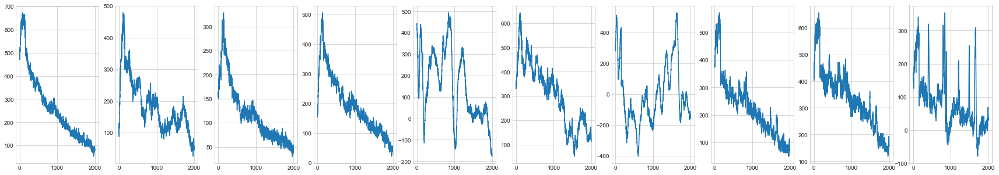

In [6]:
plot_data(input_, target2.size(0), target2)

0th additional rbflayer
0th additional RBFlayer 0th epoch loss: 9725806.544583028
0th additional RBFlayer 999th epoch MSE Loss: 3905.6503189838613
0th additional RBFlayer 1999th epoch MSE Loss: 3459.5195474381194
0th additional RBFlayer 2999th epoch MSE Loss: 3256.4030576800783
0th additional RBFlayer best loss : 3256.4030576800783


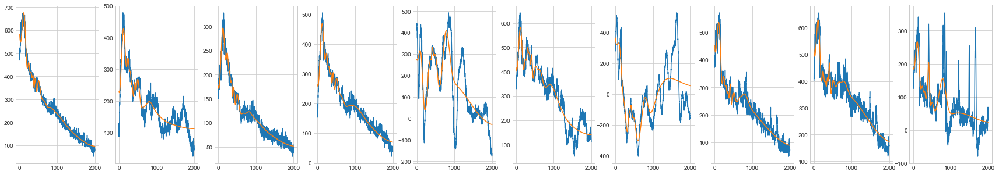

1th additional rbflayer
1th additional RBFlayer 0th epoch loss: 7737.649190395594
1th additional RBFlayer 999th epoch MSE Loss: 866.0693396006244
1th additional RBFlayer 1999th epoch MSE Loss: 752.9029859089103
1th additional RBFlayer 2999th epoch MSE Loss: 703.000960850476
1th additional RBFlayer best loss : 702.9638943552029


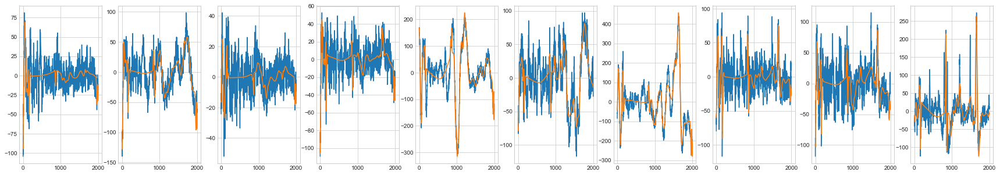

2th additional rbflayer
2th additional RBFlayer 0th epoch loss: 2645.357295710488
2th additional RBFlayer 999th epoch MSE Loss: 461.810165754308
2th additional RBFlayer 1999th epoch MSE Loss: 503.4358000052984
2th additional RBFlayer 2999th epoch MSE Loss: 439.57823166102526
2th additional RBFlayer best loss : 439.56236952938525


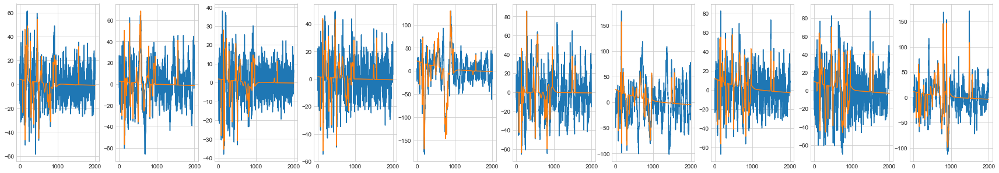

3th additional rbflayer
3th additional RBFlayer 0th epoch loss: 515.2365635051028
3th additional RBFlayer 999th epoch MSE Loss: 306.7023541050104
3th additional RBFlayer 1999th epoch MSE Loss: 292.17123733173906
3th additional RBFlayer 2999th epoch MSE Loss: 283.7888298747363
3th additional RBFlayer best loss : 283.80815346569426


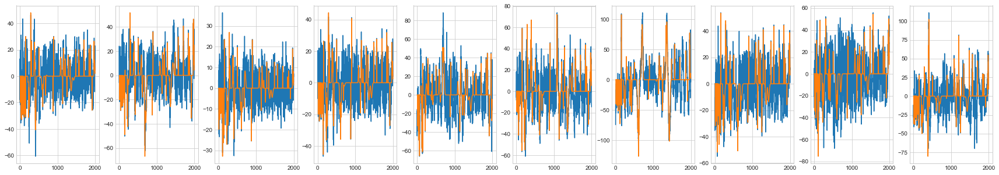

4th additional rbflayer
4th additional RBFlayer 0th epoch loss: 285.02107170295284
4th additional RBFlayer 999th epoch MSE Loss: 223.1517939059131
4th additional RBFlayer 1999th epoch MSE Loss: 219.4089087119337
4th additional RBFlayer 2999th epoch MSE Loss: 216.6103313740681
4th additional RBFlayer best loss : 216.60693240158758


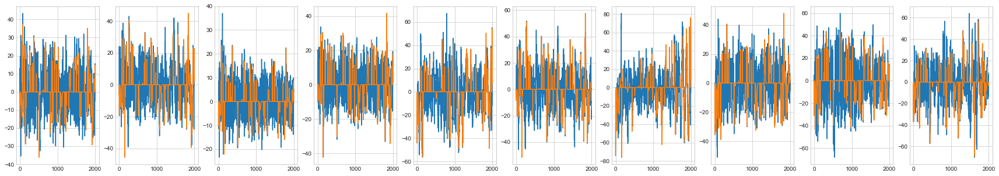

5th additional rbflayer
5th additional RBFlayer 0th epoch loss: 210.262872314989
5th additional RBFlayer 999th epoch MSE Loss: 175.8393076171267
5th additional RBFlayer 1999th epoch MSE Loss: 173.87654378115383
5th additional RBFlayer 2999th epoch MSE Loss: 172.2414541362057
5th additional RBFlayer best loss : 172.336602334369


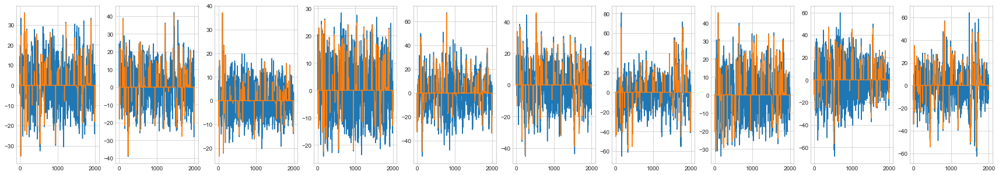

6th additional rbflayer
6th additional RBFlayer 0th epoch loss: 162.55650512168984
6th additional RBFlayer 999th epoch MSE Loss: 142.59603043362964
6th additional RBFlayer 1999th epoch MSE Loss: 141.327098801705
6th additional RBFlayer 2999th epoch MSE Loss: 141.17012772099983
6th additional RBFlayer best loss : 140.71519794606456


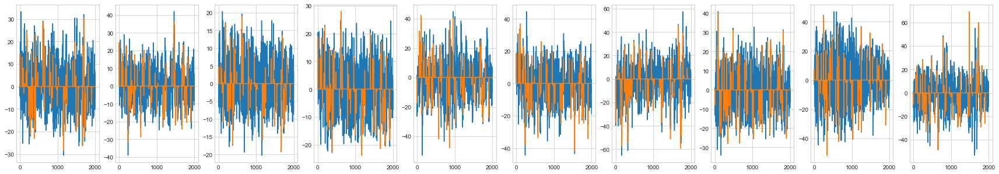

7th additional rbflayer
7th additional RBFlayer 0th epoch loss: 129.34340494739683
7th additional RBFlayer 999th epoch MSE Loss: 119.01893496397851
7th additional RBFlayer 1999th epoch MSE Loss: 118.55146906759852
7th additional RBFlayer 2999th epoch MSE Loss: 118.2741570570475
7th additional RBFlayer best loss : 117.8151360197424


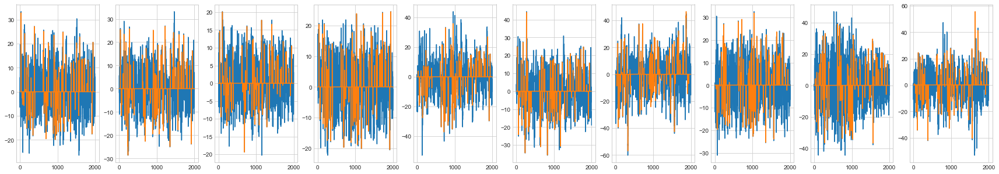

8th additional rbflayer
8th additional RBFlayer 0th epoch loss: 112.86978467693523
8th additional RBFlayer 999th epoch MSE Loss: 101.77239509769768
8th additional RBFlayer 1999th epoch MSE Loss: 101.55656931242996
8th additional RBFlayer 2999th epoch MSE Loss: 101.53034708421242
8th additional RBFlayer best loss : 101.36416555538993


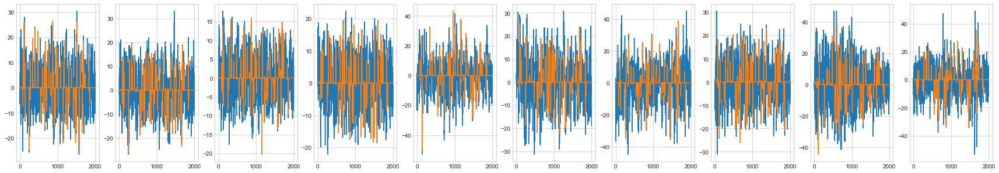

9th additional rbflayer
9th additional RBFlayer 0th epoch loss: 98.0268080787594
9th additional RBFlayer 999th epoch MSE Loss: 88.1802594835097
9th additional RBFlayer 1999th epoch MSE Loss: 88.51981564030805
9th additional RBFlayer 2999th epoch MSE Loss: 88.47235978664995
9th additional RBFlayer best loss : 87.18180785897485


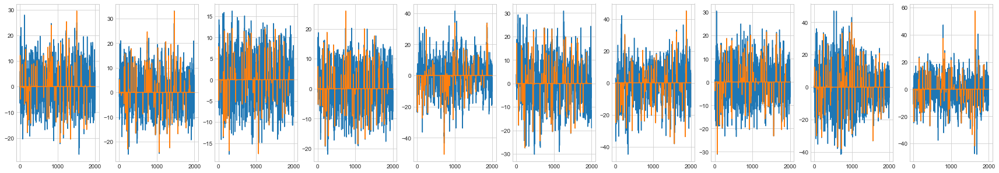

10th additional rbflayer
10th additional RBFlayer 0th epoch loss: 84.36419592181824
10th additional RBFlayer 999th epoch MSE Loss: 76.21370527000813
10th additional RBFlayer 1999th epoch MSE Loss: 76.46166807916003
10th additional RBFlayer 2999th epoch MSE Loss: 76.4302140213423
10th additional RBFlayer best loss : 75.25709106475428


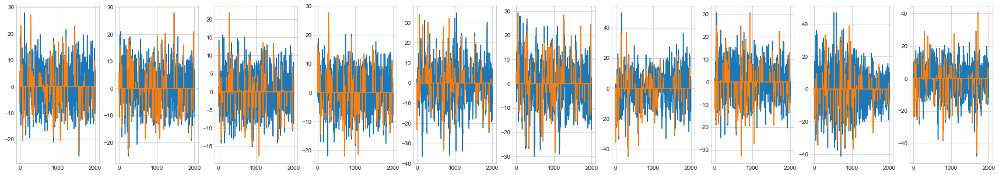

11th additional rbflayer
11th additional RBFlayer 0th epoch loss: 75.0549405583118
11th additional RBFlayer 999th epoch MSE Loss: 66.04290408179197
11th additional RBFlayer 1999th epoch MSE Loss: 65.95645369923167
11th additional RBFlayer 2999th epoch MSE Loss: 65.94525784339142
11th additional RBFlayer best loss : 65.90832641610504


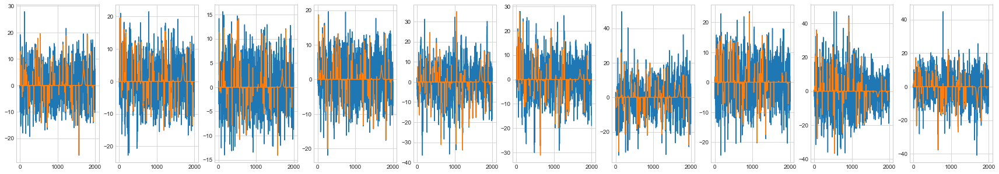

12th additional rbflayer
12th additional RBFlayer 0th epoch loss: 104.49706260443504
12th additional RBFlayer 999th epoch MSE Loss: 59.37667612270662
12th additional RBFlayer 1999th epoch MSE Loss: 59.142184195315046
12th additional RBFlayer 2999th epoch MSE Loss: 59.155147496842446
12th additional RBFlayer best loss : 59.101419062185386


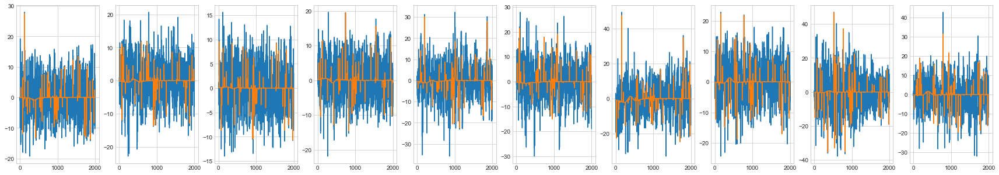

13th additional rbflayer
13th additional RBFlayer 0th epoch loss: 59.05975450059157
13th additional RBFlayer 999th epoch MSE Loss: 53.27059918488122
13th additional RBFlayer 1999th epoch MSE Loss: 53.68511228257923
13th additional RBFlayer 2999th epoch MSE Loss: 53.92381785048671
13th additional RBFlayer best loss : 52.58303637885162


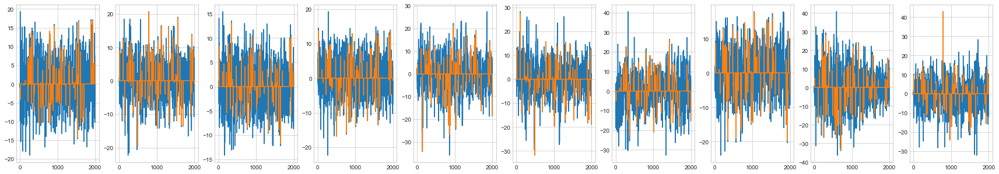

14th additional rbflayer
14th additional RBFlayer 0th epoch loss: 53.05673995502465
14th additional RBFlayer 999th epoch MSE Loss: 48.07393311357638
14th additional RBFlayer 1999th epoch MSE Loss: 48.05573272065022
14th additional RBFlayer 2999th epoch MSE Loss: 47.976745342117965
14th additional RBFlayer best loss : 47.9514558994896


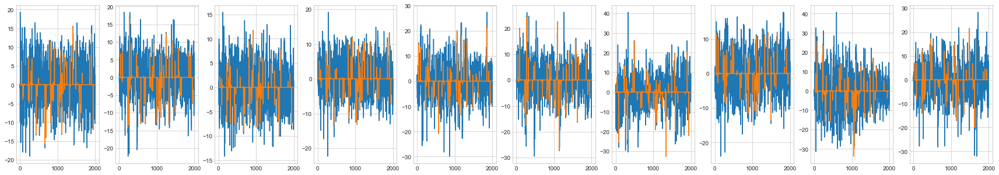

15th additional rbflayer
15th additional RBFlayer 0th epoch loss: 50.14879976445179
15th additional RBFlayer 999th epoch MSE Loss: 44.12455556788099
15th additional RBFlayer 1999th epoch MSE Loss: 44.36176030074422
15th additional RBFlayer 2999th epoch MSE Loss: 44.330881011655805
15th additional RBFlayer best loss : 44.02885422060411


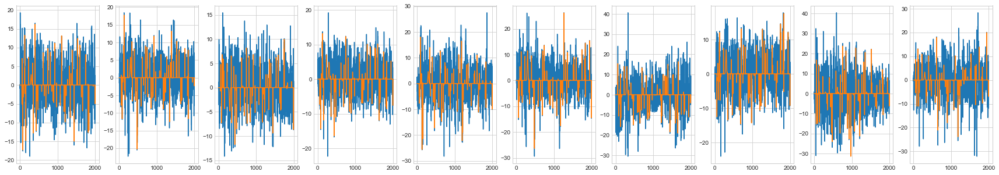

16th additional rbflayer
16th additional RBFlayer 0th epoch loss: 47.041227079982484
16th additional RBFlayer 999th epoch MSE Loss: 40.50359910831532
16th additional RBFlayer 1999th epoch MSE Loss: 40.42712897717881
16th additional RBFlayer 2999th epoch MSE Loss: 40.33565427648226
16th additional RBFlayer best loss : 40.264881974439675


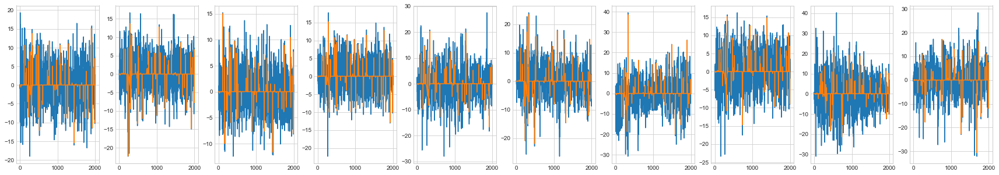

17th additional rbflayer
17th additional RBFlayer 0th epoch loss: 42.2538785273172
17th additional RBFlayer 999th epoch MSE Loss: 37.55666582543531
17th additional RBFlayer 1999th epoch MSE Loss: 37.79098116947581
17th additional RBFlayer 2999th epoch MSE Loss: 37.694650277158466
17th additional RBFlayer best loss : 37.45477373463208


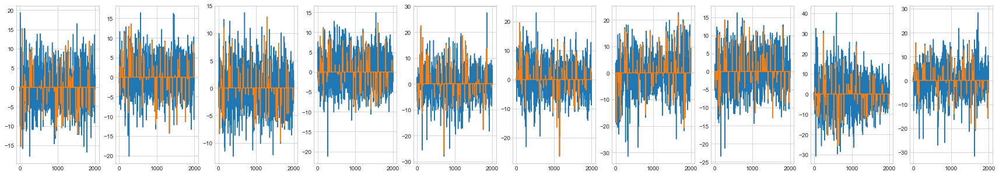

18th additional rbflayer
18th additional RBFlayer 0th epoch loss: 39.924839785036106
18th additional RBFlayer 999th epoch MSE Loss: 35.23349244634826
18th additional RBFlayer 1999th epoch MSE Loss: 34.928260703224645
18th additional RBFlayer 2999th epoch MSE Loss: 34.95269561836736
18th additional RBFlayer best loss : 34.926846682139676


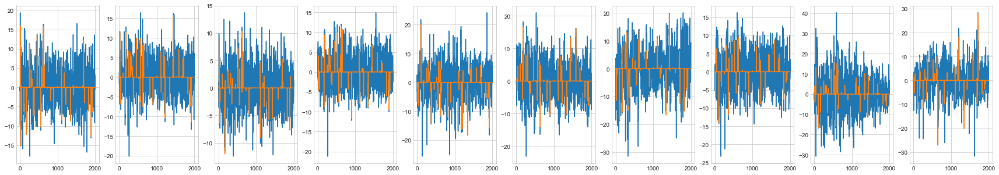

19th additional rbflayer
19th additional RBFlayer 0th epoch loss: 42.28309632383153
19th additional RBFlayer 999th epoch MSE Loss: 34.17767024147211
19th additional RBFlayer 1999th epoch MSE Loss: 33.37307718629088
19th additional RBFlayer 2999th epoch MSE Loss: 33.1801270002905
19th additional RBFlayer best loss : 33.1801270002905


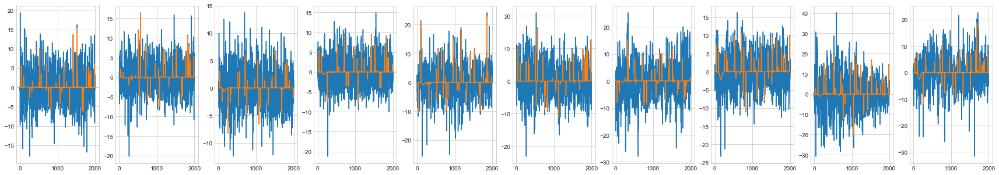

20th additional rbflayer
20th additional RBFlayer 0th epoch loss: 41.67731764333252
20th additional RBFlayer 999th epoch MSE Loss: 32.237792304913995
20th additional RBFlayer 1999th epoch MSE Loss: 31.76495527230761
20th additional RBFlayer 2999th epoch MSE Loss: 31.837754273690962
20th additional RBFlayer best loss : 31.729246979555995


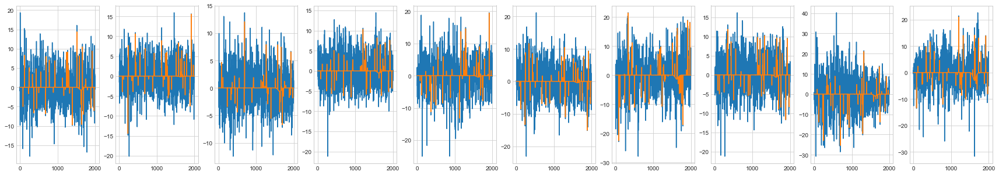

21th additional rbflayer
21th additional RBFlayer 0th epoch loss: 34.16195697899111
21th additional RBFlayer 999th epoch MSE Loss: 29.936392982707627
21th additional RBFlayer 1999th epoch MSE Loss: 30.25950298279205
21th additional RBFlayer 2999th epoch MSE Loss: 30.295941470485158
21th additional RBFlayer best loss : 29.862318994239743


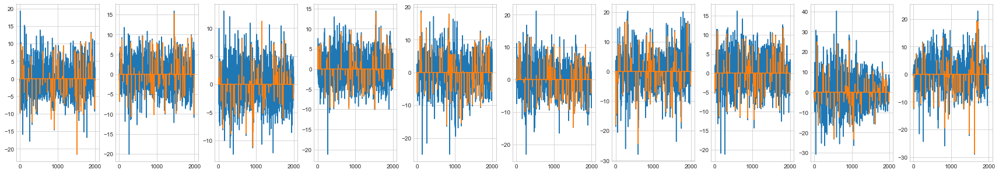

22th additional rbflayer
22th additional RBFlayer 0th epoch loss: 33.39735366427151
22th additional RBFlayer 999th epoch MSE Loss: 27.873970855444636
22th additional RBFlayer 1999th epoch MSE Loss: 27.540287739428152
22th additional RBFlayer 2999th epoch MSE Loss: 27.5942698732584
22th additional RBFlayer best loss : 27.539886645983415


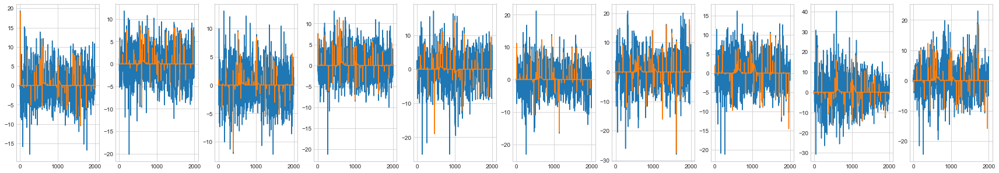

23th additional rbflayer
23th additional RBFlayer 0th epoch loss: 33.339930522907856
23th additional RBFlayer 999th epoch MSE Loss: 26.21352600504034
23th additional RBFlayer 1999th epoch MSE Loss: 26.13298132905066
23th additional RBFlayer 2999th epoch MSE Loss: 26.24219641891157
23th additional RBFlayer best loss : 26.12626516024474


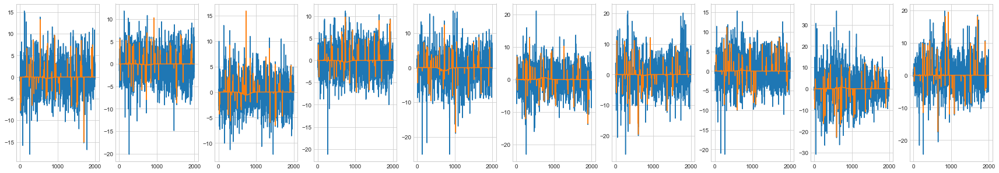

24th additional rbflayer
24th additional RBFlayer 0th epoch loss: 36.1129757115029
24th additional RBFlayer 999th epoch MSE Loss: 25.874960921802177
24th additional RBFlayer 1999th epoch MSE Loss: 25.208635193158756
24th additional RBFlayer 2999th epoch MSE Loss: 25.114785420141523
24th additional RBFlayer best loss : 25.114645455090947


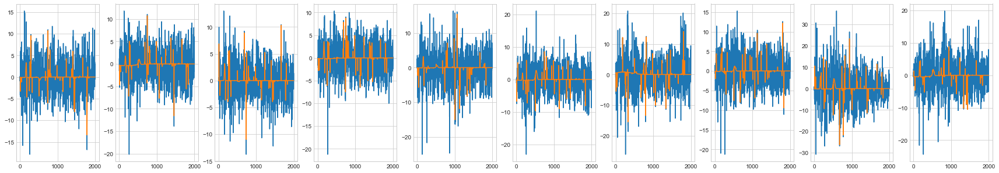

25th additional rbflayer
25th additional RBFlayer 0th epoch loss: 28.258721118360004
25th additional RBFlayer 999th epoch MSE Loss: 24.179400666701103
25th additional RBFlayer 1999th epoch MSE Loss: 23.987489372252163
25th additional RBFlayer 2999th epoch MSE Loss: 23.9019258181411
25th additional RBFlayer best loss : 23.901712642540925


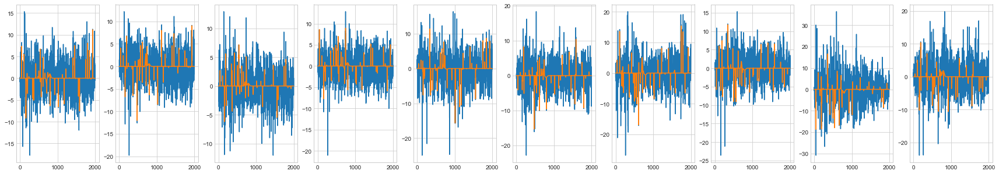

26th additional rbflayer
26th additional RBFlayer 0th epoch loss: 26.842794363272926
26th additional RBFlayer 999th epoch MSE Loss: 23.573439751499297
26th additional RBFlayer 1999th epoch MSE Loss: 23.373866825992256
26th additional RBFlayer 2999th epoch MSE Loss: 23.179752681343004
26th additional RBFlayer best loss : 23.179616277451238


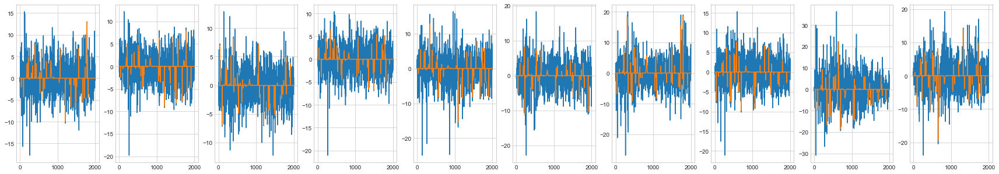

27th additional rbflayer
27th additional RBFlayer 0th epoch loss: 25.445339454512265
27th additional RBFlayer 999th epoch MSE Loss: 22.413428836479337
27th additional RBFlayer 1999th epoch MSE Loss: 22.184852950989793
27th additional RBFlayer 2999th epoch MSE Loss: 22.2042806767828
27th additional RBFlayer best loss : 22.153100417733928


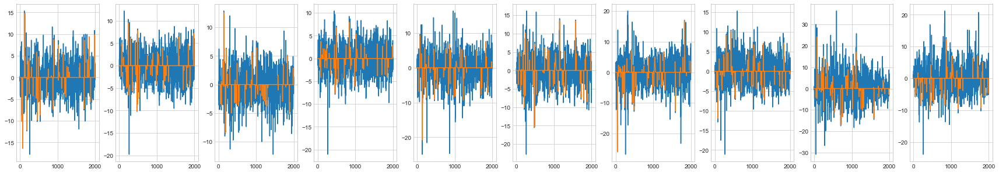

28th additional rbflayer
28th additional RBFlayer 0th epoch loss: 25.063662069743728
28th additional RBFlayer 999th epoch MSE Loss: 21.71063535807663
28th additional RBFlayer 1999th epoch MSE Loss: 21.265400594572423
28th additional RBFlayer 2999th epoch MSE Loss: 21.146437838858223
28th additional RBFlayer best loss : 21.114676900894725


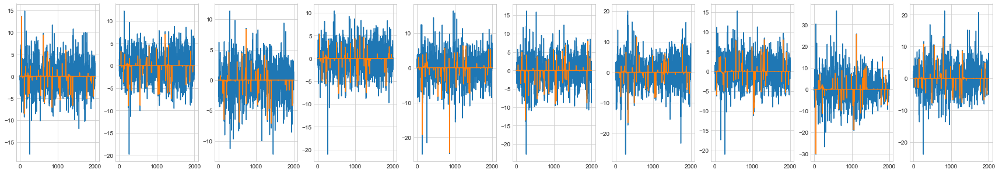

29th additional rbflayer
29th additional RBFlayer 0th epoch loss: 23.895868830737573
29th additional RBFlayer 999th epoch MSE Loss: 21.328958868525007
29th additional RBFlayer 1999th epoch MSE Loss: 20.547103772356806
29th additional RBFlayer 2999th epoch MSE Loss: 20.478284565024026
29th additional RBFlayer best loss : 20.453425814759562


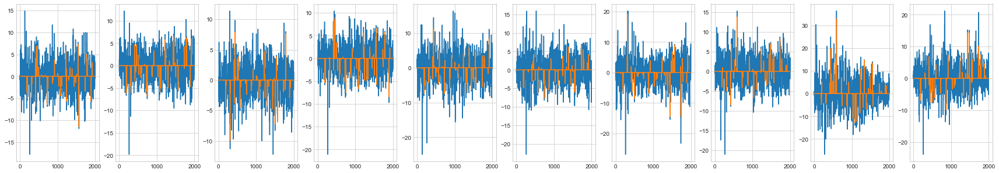

30th additional rbflayer
30th additional RBFlayer 0th epoch loss: 22.9460696742505
30th additional RBFlayer 999th epoch MSE Loss: 20.332784406859655
30th additional RBFlayer 1999th epoch MSE Loss: 19.8491805713232
30th additional RBFlayer 2999th epoch MSE Loss: 19.745555454486173
30th additional RBFlayer best loss : 19.74547894599927
change lr  0.0001
----------------------------------------------


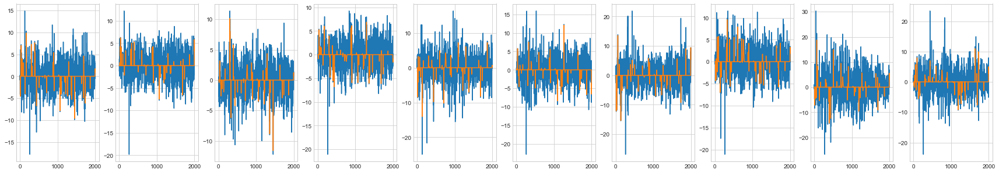

In [8]:
model_eeg1 = MultiRBFnn(target2.size(0), 100, device)
model_eeg1.train(input_, target2, 3000, 0.00001, 20, 20)

<Figure size 2160x720 with 0 Axes>

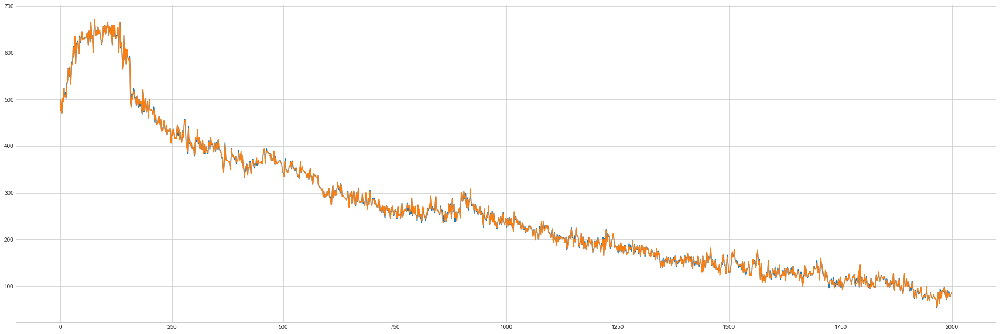

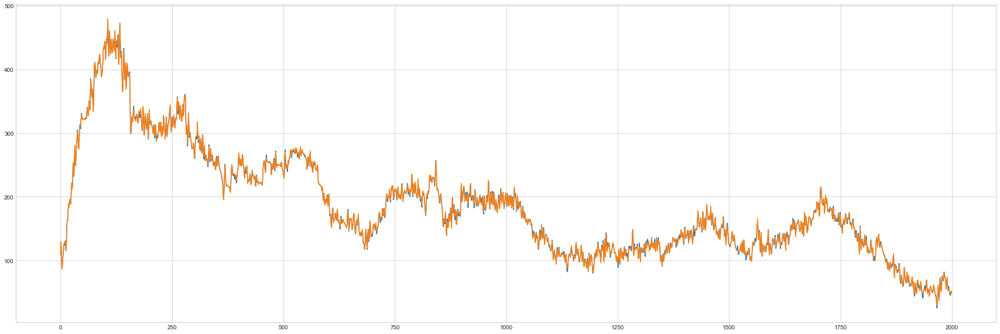

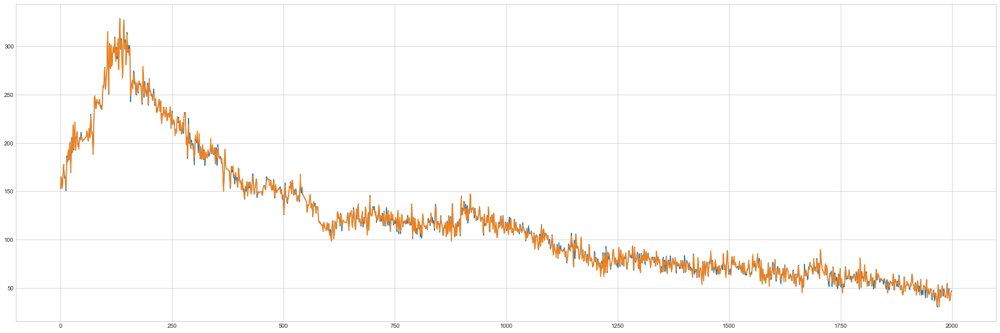

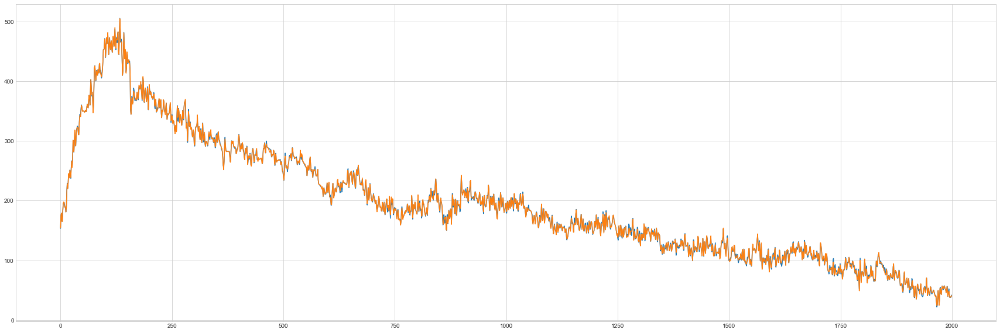

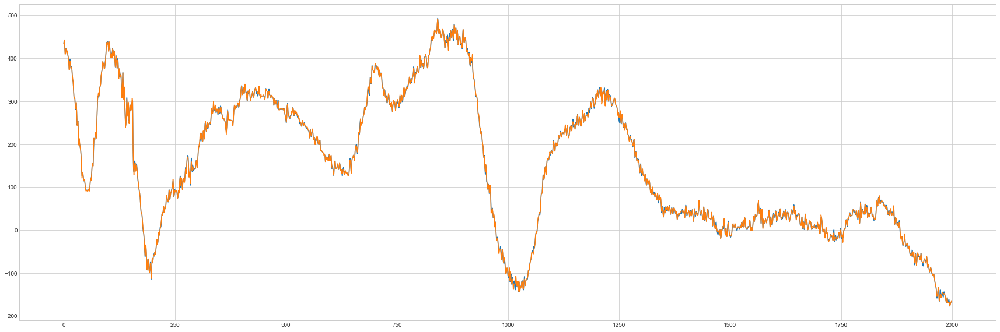

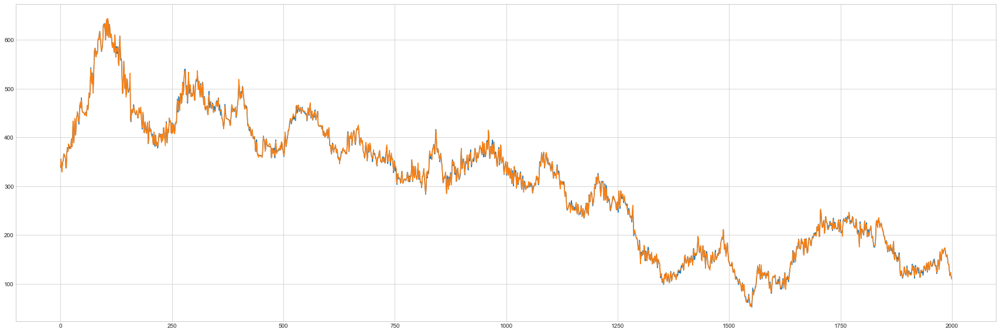

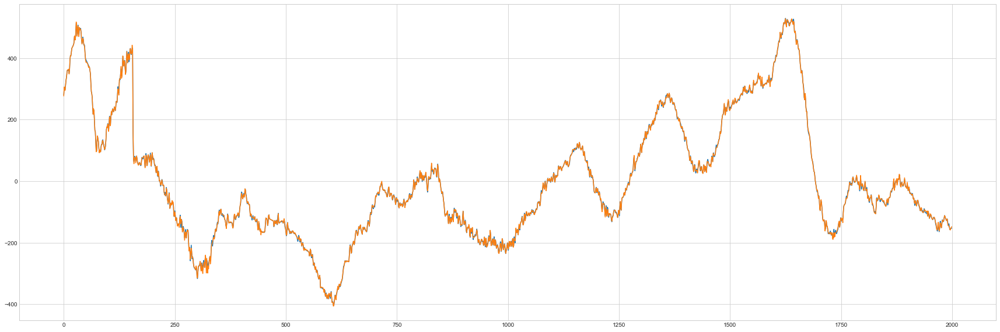

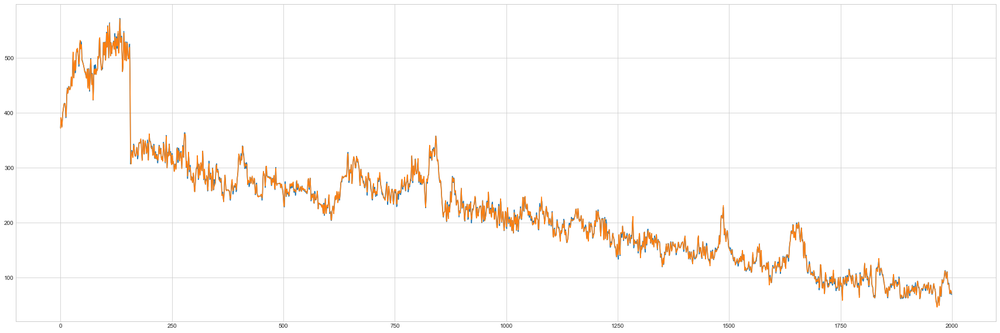

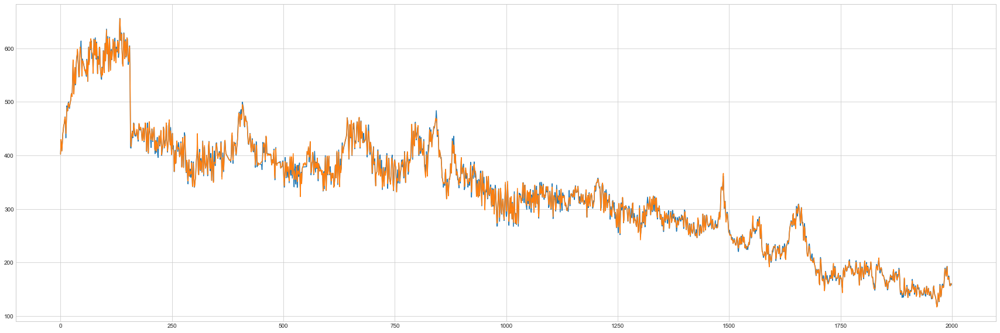

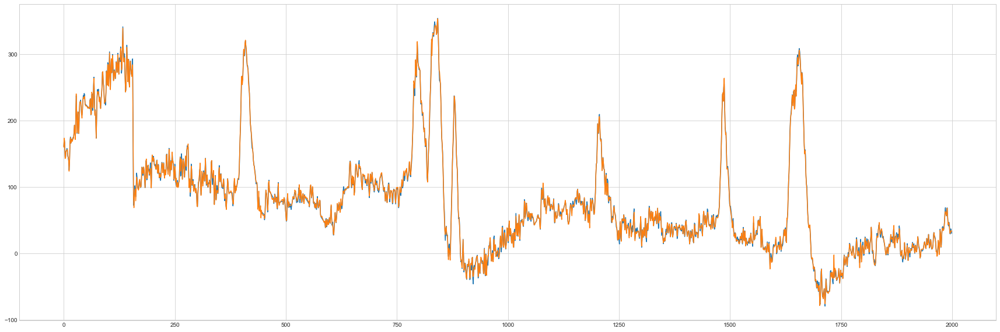

In [9]:
plt.figure(figsize=(30, 10))
model_pred = model_eeg1.pred(input_)[1]
for i in range(target2.size(0)):
    plt.figure(figsize=(30, 10))
    plt.plot(input_.cpu().detach().numpy(), target2[i].cpu().detach().numpy())
    plt.plot(input_.cpu().detach().numpy(), model_pred[i].cpu().detach().numpy())
    plt.show()

In [15]:
# Weather

weather = pd.read_csv('../dataset/weatherHistory.csv')
weather_col = weather.columns
weather_df = weather[weather_col[3:7]][:2000]
weather_target = weather_df.values
weather_input = list(weather_df.index)

weather_input = torch.tensor(weather_input, device = device, dtype = float)
weather_target = torch.tensor(weather_target.T, dtype = float, device = device)

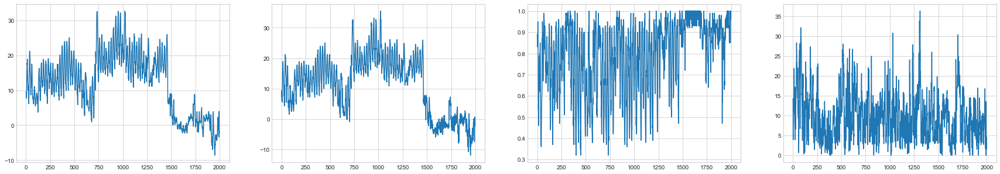

In [16]:
plot_data(weather_input, weather_target.size(0), weather_target)

0th additional rbflayer
0th additional RBFlayer 0th epoch loss: 3806.555450430871
0th additional RBFlayer 999th epoch MSE Loss: 64.42424366602765
0th additional RBFlayer 1999th epoch MSE Loss: 53.296918127340675
0th additional RBFlayer 2999th epoch MSE Loss: 49.907126771454045
0th additional RBFlayer best loss : 49.907126771454045


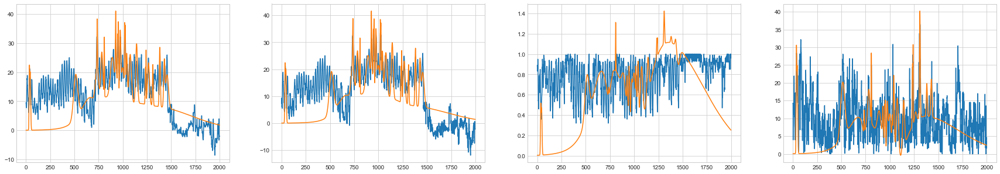

1th additional rbflayer
1th additional RBFlayer 0th epoch loss: 692.0655781330946
1th additional RBFlayer 999th epoch MSE Loss: 32.02569918664027
1th additional RBFlayer 1999th epoch MSE Loss: 28.365305384466293
1th additional RBFlayer 2999th epoch MSE Loss: 27.02005271335426
1th additional RBFlayer best loss : 27.02005271335426


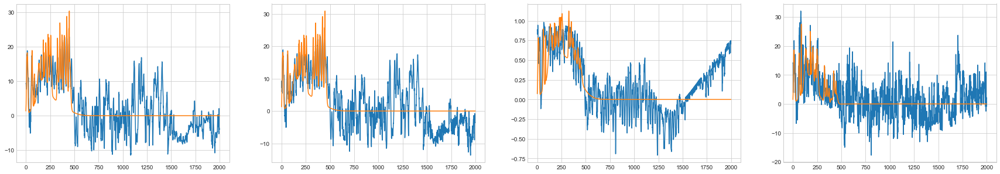

2th additional rbflayer
2th additional RBFlayer 0th epoch loss: 306.8309541776798
2th additional RBFlayer 999th epoch MSE Loss: 20.268952630146387
2th additional RBFlayer 1999th epoch MSE Loss: 16.87440604025584
2th additional RBFlayer 2999th epoch MSE Loss: 15.986197163568018
2th additional RBFlayer best loss : 15.985729265419923


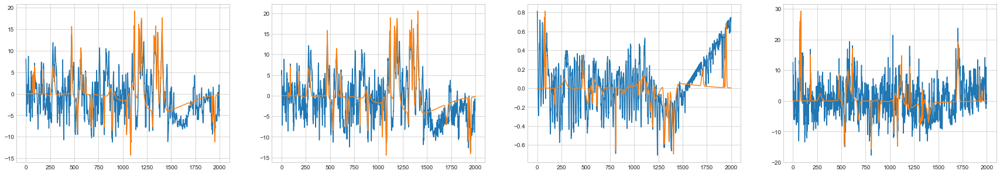

3th additional rbflayer
3th additional RBFlayer 0th epoch loss: 66.75961508515758
3th additional RBFlayer 999th epoch MSE Loss: 14.865988047858613
3th additional RBFlayer 1999th epoch MSE Loss: 12.001117166674222
3th additional RBFlayer 2999th epoch MSE Loss: 11.272147436364591
3th additional RBFlayer best loss : 11.271761337760717


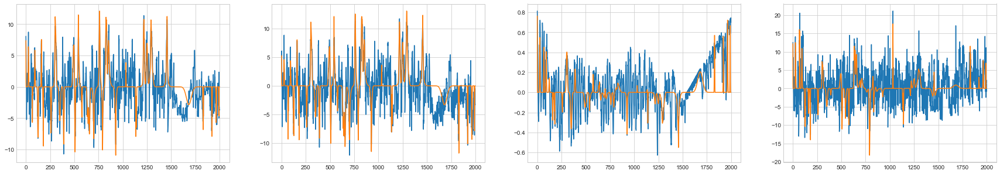

4th additional rbflayer
4th additional RBFlayer 0th epoch loss: 42.69797568495893
4th additional RBFlayer 999th epoch MSE Loss: 10.84819454674677
4th additional RBFlayer 1999th epoch MSE Loss: 9.138863449562487
4th additional RBFlayer 2999th epoch MSE Loss: 8.523914691544174
4th additional RBFlayer best loss : 8.523599974962243


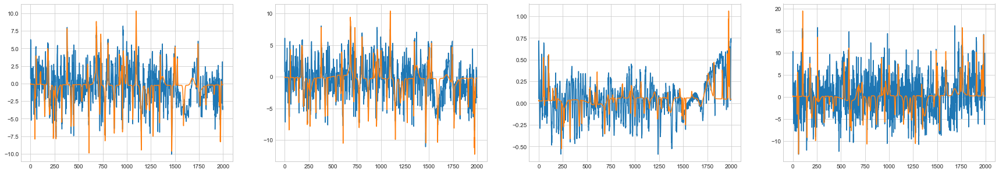

5th additional rbflayer
5th additional RBFlayer 0th epoch loss: 41.198172054839794
5th additional RBFlayer 999th epoch MSE Loss: 9.271012318679672
5th additional RBFlayer 1999th epoch MSE Loss: 7.5471402272924335
5th additional RBFlayer 2999th epoch MSE Loss: 7.065520648006947
5th additional RBFlayer best loss : 7.065255292514909


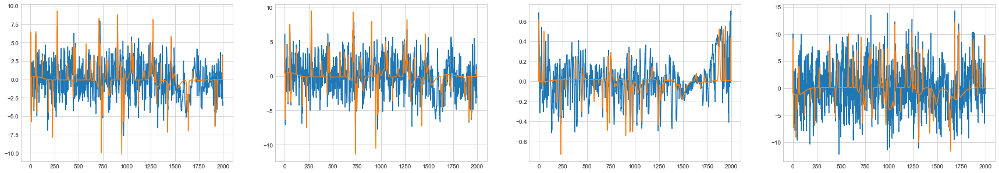

6th additional rbflayer
6th additional RBFlayer 0th epoch loss: 17.52472040839411
6th additional RBFlayer 999th epoch MSE Loss: 8.032145026079588
6th additional RBFlayer 1999th epoch MSE Loss: 6.59040929703681
6th additional RBFlayer 2999th epoch MSE Loss: 6.129793862936372
6th additional RBFlayer best loss : 6.129544556362167


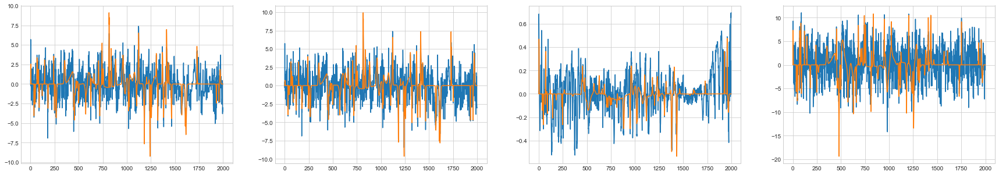

7th additional rbflayer
7th additional RBFlayer 0th epoch loss: 38.46630533759661
7th additional RBFlayer 999th epoch MSE Loss: 6.847410180827658
7th additional RBFlayer 1999th epoch MSE Loss: 5.72360094032341
7th additional RBFlayer 2999th epoch MSE Loss: 5.351215859160666
7th additional RBFlayer best loss : 5.350981257907046


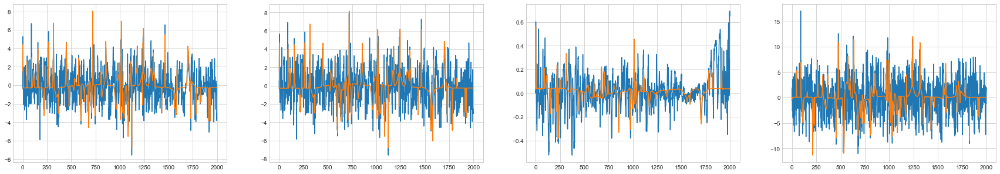

8th additional rbflayer
8th additional RBFlayer 0th epoch loss: 10.108100917057108
8th additional RBFlayer 999th epoch MSE Loss: 6.3353793701277095
8th additional RBFlayer 1999th epoch MSE Loss: 5.340842659562916
8th additional RBFlayer 2999th epoch MSE Loss: 4.9402367688472495
8th additional RBFlayer best loss : 4.939885314226825


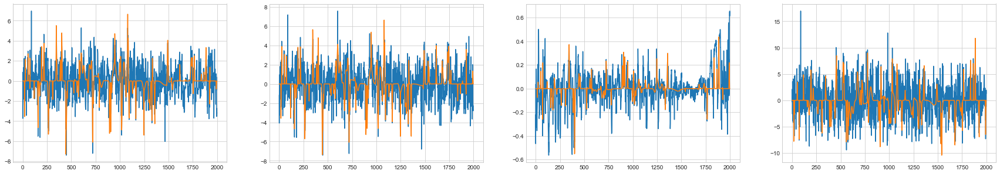

9th additional rbflayer
9th additional RBFlayer 0th epoch loss: 9.526268145833223
9th additional RBFlayer 999th epoch MSE Loss: 5.99088889330241
9th additional RBFlayer 1999th epoch MSE Loss: 4.947168068282107
9th additional RBFlayer 2999th epoch MSE Loss: 4.58311791253264
9th additional RBFlayer best loss : 4.58283993263564


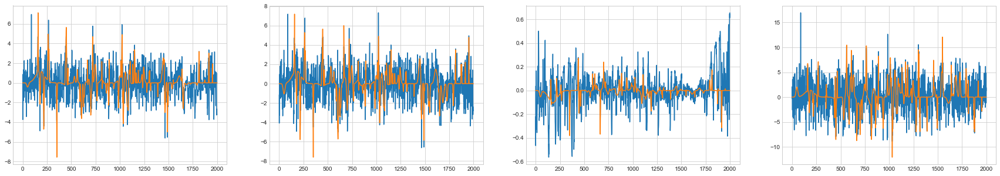

10th additional rbflayer
10th additional RBFlayer 0th epoch loss: 14.066579128779479
10th additional RBFlayer 999th epoch MSE Loss: 5.911232502955605
10th additional RBFlayer 1999th epoch MSE Loss: 4.770683376205203
10th additional RBFlayer 2999th epoch MSE Loss: 4.367900395648196
10th additional RBFlayer best loss : 4.3676109412996516


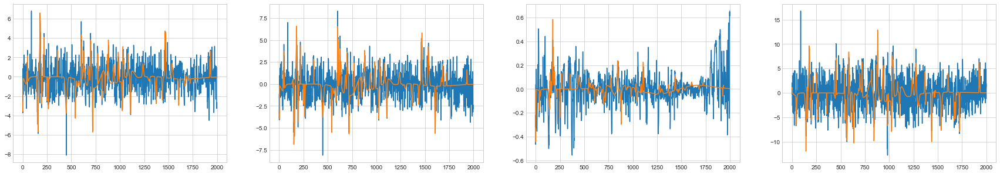

11th additional rbflayer
11th additional RBFlayer 0th epoch loss: 17.14045245999036
11th additional RBFlayer 999th epoch MSE Loss: 5.811204725423328
11th additional RBFlayer 1999th epoch MSE Loss: 4.618316926271866
11th additional RBFlayer 2999th epoch MSE Loss: 4.1617652614030085
11th additional RBFlayer best loss : 4.161277037098975


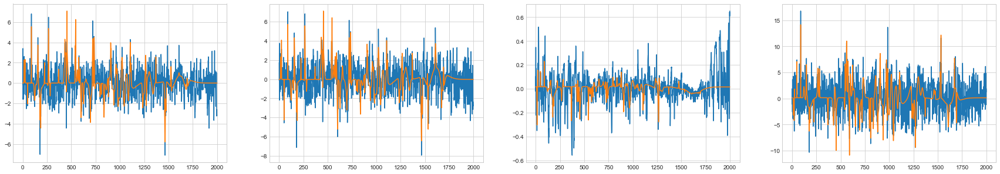

12th additional rbflayer
12th additional RBFlayer 0th epoch loss: 12.525044192813274
12th additional RBFlayer 999th epoch MSE Loss: 5.346364527384068
12th additional RBFlayer 1999th epoch MSE Loss: 4.414071652026018
12th additional RBFlayer 2999th epoch MSE Loss: 4.0333503097617145
12th additional RBFlayer best loss : 4.033114050269573


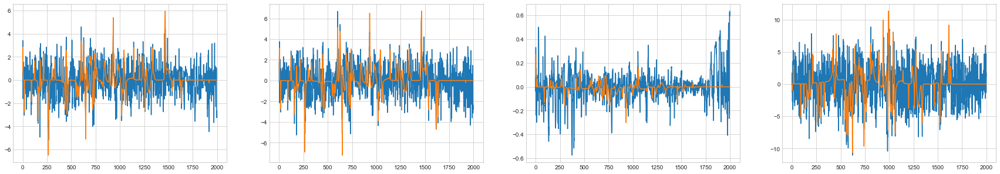

13th additional rbflayer
13th additional RBFlayer 0th epoch loss: 22.842892477602195
13th additional RBFlayer 999th epoch MSE Loss: 5.347576314543175
13th additional RBFlayer 1999th epoch MSE Loss: 4.331039033373802
13th additional RBFlayer 2999th epoch MSE Loss: 3.9665107247701856
13th additional RBFlayer best loss : 3.9663005180407653
change lr  0.0001
----------------------------------------------


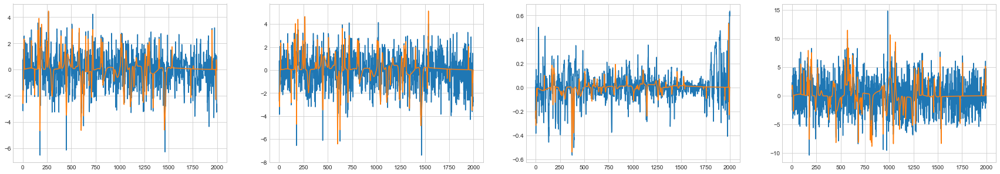

14th additional rbflayer
14th additional RBFlayer 0th epoch loss: 19.731263940375744
14th additional RBFlayer 999th epoch MSE Loss: 3.412130784799835
14th additional RBFlayer 1999th epoch MSE Loss: 3.322392110013372
14th additional RBFlayer 2999th epoch MSE Loss: 3.297712608350605
14th additional RBFlayer best loss : 3.2942024319406955


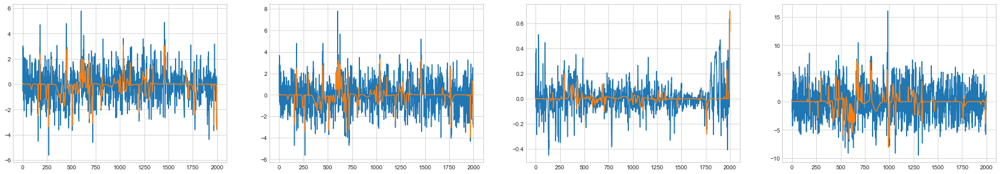

15th additional rbflayer
15th additional RBFlayer 0th epoch loss: 5.631641146974911
15th additional RBFlayer 999th epoch MSE Loss: 3.031390109677921
15th additional RBFlayer 1999th epoch MSE Loss: 2.950566462313899
15th additional RBFlayer 2999th epoch MSE Loss: 2.9248077430141732
15th additional RBFlayer best loss : 2.9247875928799685


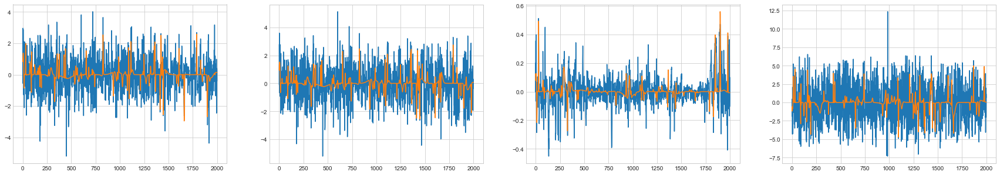

16th additional rbflayer
16th additional RBFlayer 0th epoch loss: 9.707811270528302
16th additional RBFlayer 999th epoch MSE Loss: 2.797403948737342
16th additional RBFlayer 1999th epoch MSE Loss: 2.723724754750393
16th additional RBFlayer 2999th epoch MSE Loss: 2.702931483355564
16th additional RBFlayer best loss : 2.7029162879007993


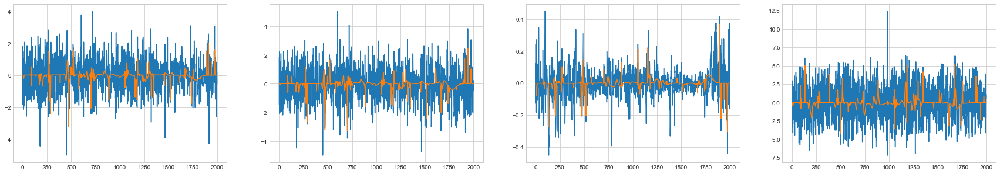

17th additional rbflayer
17th additional RBFlayer 0th epoch loss: 5.276726896100281
17th additional RBFlayer 999th epoch MSE Loss: 2.64565816244064
17th additional RBFlayer 1999th epoch MSE Loss: 2.5598157349285264
17th additional RBFlayer 2999th epoch MSE Loss: 2.5375359925111876
17th additional RBFlayer best loss : 2.5375247378367263


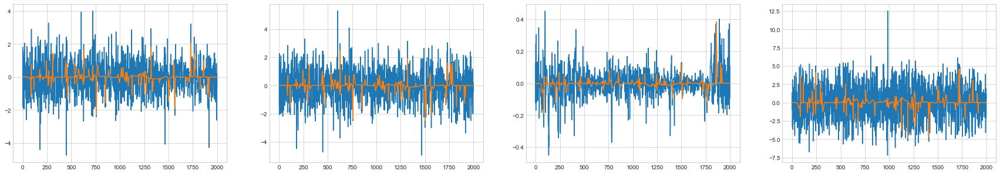

18th additional rbflayer
18th additional RBFlayer 0th epoch loss: 5.744110748388395
18th additional RBFlayer 999th epoch MSE Loss: 2.479471779610564
18th additional RBFlayer 1999th epoch MSE Loss: 2.41247460403074
18th additional RBFlayer 2999th epoch MSE Loss: 2.3858578507368313
18th additional RBFlayer best loss : 2.3858392105691264


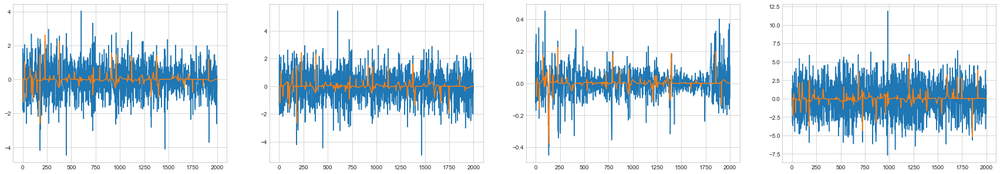

19th additional rbflayer
19th additional RBFlayer 0th epoch loss: 6.327666952707468
19th additional RBFlayer 999th epoch MSE Loss: 2.422599734576383
19th additional RBFlayer 1999th epoch MSE Loss: 2.350150464840034
19th additional RBFlayer 2999th epoch MSE Loss: 2.3262711202600412
19th additional RBFlayer best loss : 2.3262552093618325


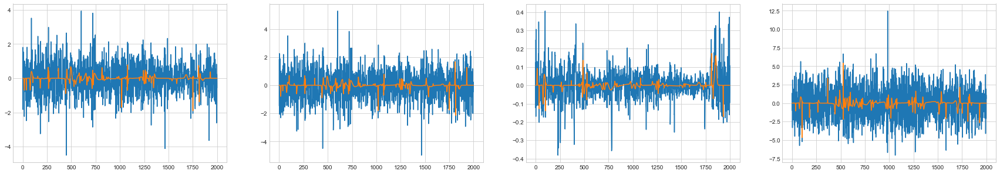

20th additional rbflayer
20th additional RBFlayer 0th epoch loss: 4.984800273609219
20th additional RBFlayer 999th epoch MSE Loss: 2.3746096267909342
20th additional RBFlayer 1999th epoch MSE Loss: 2.3008132827621752
20th additional RBFlayer 2999th epoch MSE Loss: 2.2709986754105396
20th additional RBFlayer best loss : 2.2709815356212295


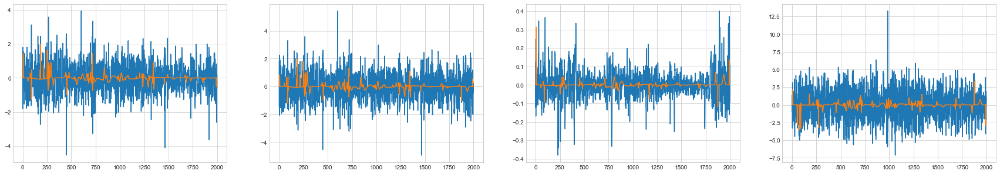

21th additional rbflayer
21th additional RBFlayer 0th epoch loss: 12.22074757936233
21th additional RBFlayer 999th epoch MSE Loss: 2.2943113371288324
21th additional RBFlayer 1999th epoch MSE Loss: 2.229209238851047
21th additional RBFlayer 2999th epoch MSE Loss: 2.2104100151216537
21th additional RBFlayer best loss : 2.2103977457062136


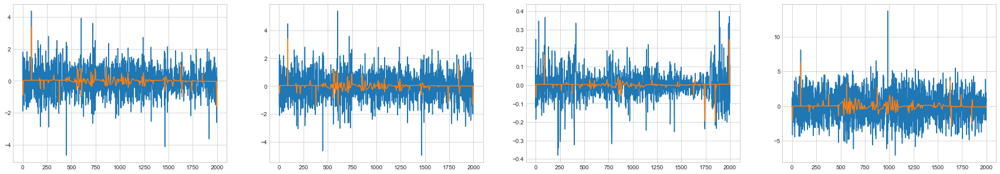

22th additional rbflayer
22th additional RBFlayer 0th epoch loss: 5.1855486488711
22th additional RBFlayer 999th epoch MSE Loss: 2.2672940638242443
22th additional RBFlayer 1999th epoch MSE Loss: 2.1980353521621967
22th additional RBFlayer 2999th epoch MSE Loss: 2.1776523785685105
22th additional RBFlayer best loss : 2.1776396489859113


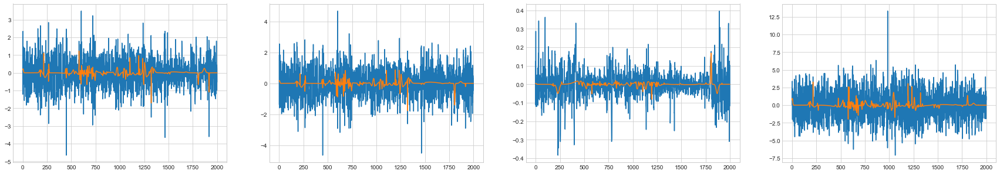

23th additional rbflayer
23th additional RBFlayer 0th epoch loss: 11.93700727639944
23th additional RBFlayer 999th epoch MSE Loss: 2.2458296199145362
23th additional RBFlayer 1999th epoch MSE Loss: 2.1783746684908536
23th additional RBFlayer 2999th epoch MSE Loss: 2.1561261582584583
23th additional RBFlayer best loss : 2.1561121850118763


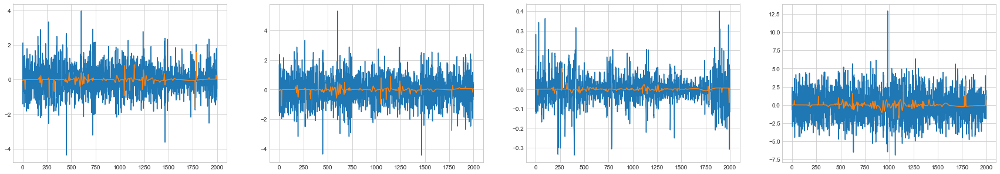

24th additional rbflayer
24th additional RBFlayer 0th epoch loss: 10.193210349376653
24th additional RBFlayer 999th epoch MSE Loss: 2.1907473709229346
24th additional RBFlayer 1999th epoch MSE Loss: 2.138037497272778
24th additional RBFlayer 2999th epoch MSE Loss: 2.1192854605341127
24th additional RBFlayer best loss : 2.1192736026970125


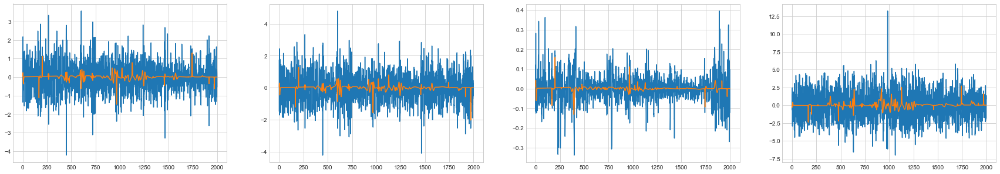

25th additional rbflayer
25th additional RBFlayer 0th epoch loss: 5.505131581561841
25th additional RBFlayer 999th epoch MSE Loss: 2.168825538551523
25th additional RBFlayer 1999th epoch MSE Loss: 2.109945697971795
25th additional RBFlayer 2999th epoch MSE Loss: 2.093179378329649
25th additional RBFlayer best loss : 2.0931698451294407


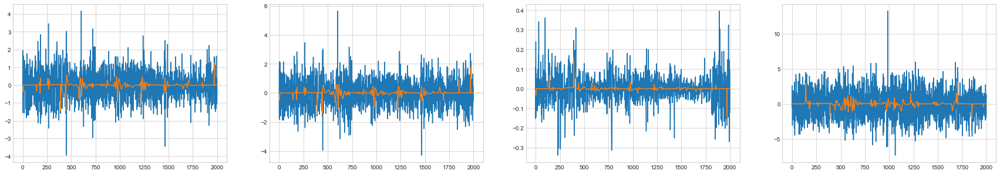

26th additional rbflayer
26th additional RBFlayer 0th epoch loss: 10.785524617300053
26th additional RBFlayer 999th epoch MSE Loss: 2.1718693107445146
26th additional RBFlayer 1999th epoch MSE Loss: 2.0999519768038826
26th additional RBFlayer 2999th epoch MSE Loss: 2.081355142309188
26th additional RBFlayer best loss : 2.0813408494207826


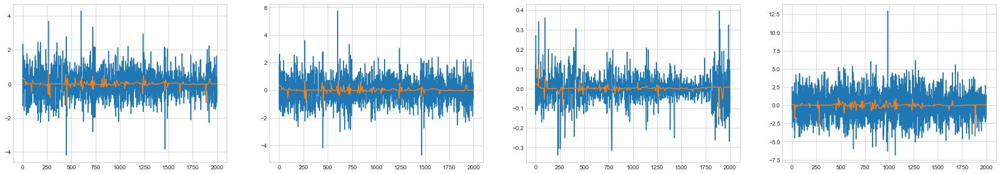

27th additional rbflayer
27th additional RBFlayer 0th epoch loss: 5.885580623901111
27th additional RBFlayer 999th epoch MSE Loss: 2.1596006913496706
27th additional RBFlayer 1999th epoch MSE Loss: 2.0860810021245086
27th additional RBFlayer 2999th epoch MSE Loss: 2.0652613153253196
27th additional RBFlayer best loss : 2.0652491802032826


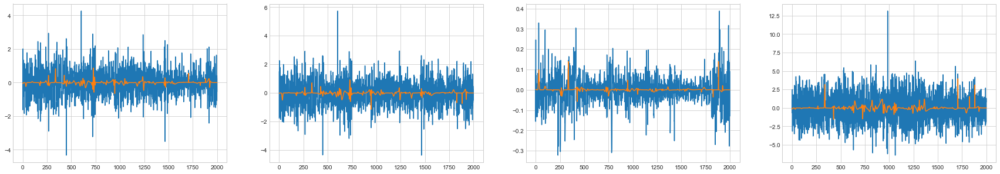

28th additional rbflayer
28th additional RBFlayer 0th epoch loss: 7.634402610054773
28th additional RBFlayer 999th epoch MSE Loss: 2.1582614364147656
28th additional RBFlayer 1999th epoch MSE Loss: 2.091154120421251
28th additional RBFlayer 2999th epoch MSE Loss: 2.0688596338799834
28th additional RBFlayer best loss : 2.0688447085017434


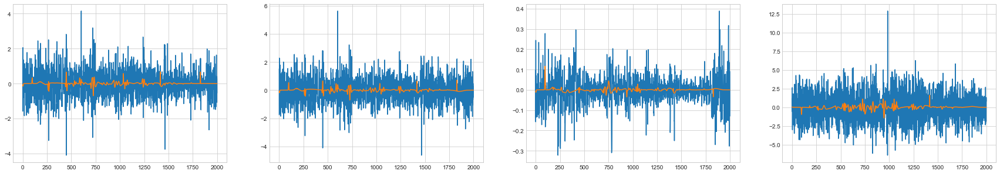

29th additional rbflayer
29th additional RBFlayer 0th epoch loss: 6.237107442978886
29th additional RBFlayer 999th epoch MSE Loss: 2.1313742752373734
29th additional RBFlayer 1999th epoch MSE Loss: 2.063321891120042
29th additional RBFlayer 2999th epoch MSE Loss: 2.043175535977398
29th additional RBFlayer best loss : 2.043161753766662


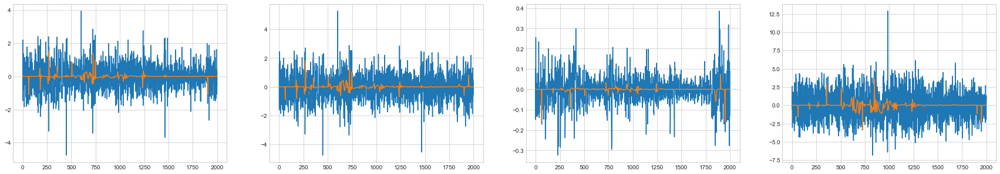

30th additional rbflayer
30th additional RBFlayer 0th epoch loss: 7.062410810410576
30th additional RBFlayer 999th epoch MSE Loss: 2.139656573919636
30th additional RBFlayer 1999th epoch MSE Loss: 2.0625168222163857
30th additional RBFlayer 2999th epoch MSE Loss: 2.0392936068998604
30th additional RBFlayer best loss : 2.0392787973199518


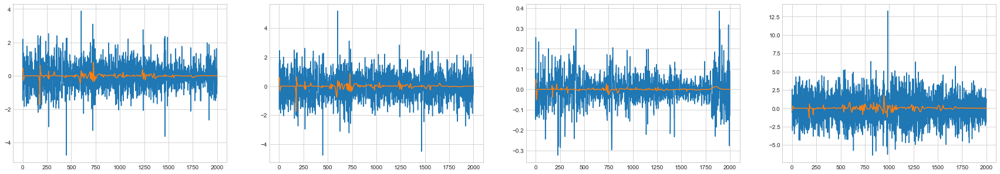

31th additional rbflayer
31th additional RBFlayer 0th epoch loss: 5.009596038428573
31th additional RBFlayer 999th epoch MSE Loss: 2.11375753105538
31th additional RBFlayer 1999th epoch MSE Loss: 2.048440094047045
31th additional RBFlayer 2999th epoch MSE Loss: 2.0317924164068755
31th additional RBFlayer best loss : 2.0317817894393255


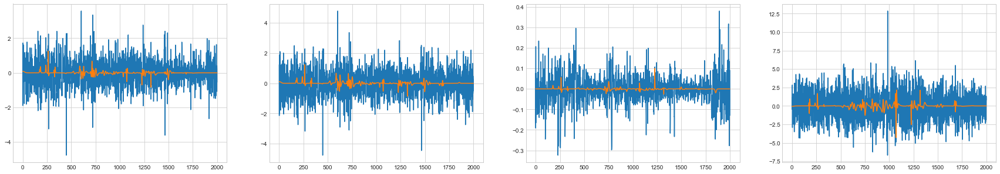

32th additional rbflayer
32th additional RBFlayer 0th epoch loss: 6.64380432610967
32th additional RBFlayer 999th epoch MSE Loss: 2.1243097001887965
32th additional RBFlayer 1999th epoch MSE Loss: 2.0552604063871565
32th additional RBFlayer 2999th epoch MSE Loss: 2.034738484689901
32th additional RBFlayer best loss : 2.034725252015467


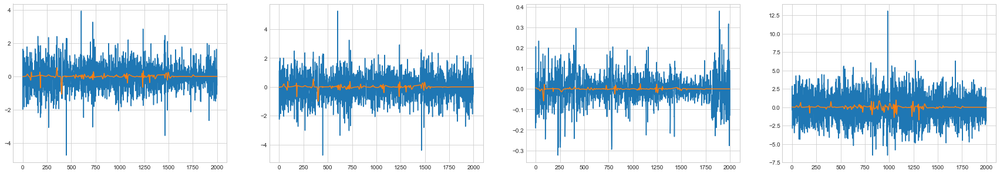

33th additional rbflayer
33th additional RBFlayer 0th epoch loss: 14.83540748067313
33th additional RBFlayer 999th epoch MSE Loss: 2.1179453656543945
33th additional RBFlayer 1999th epoch MSE Loss: 2.0491322561461494
33th additional RBFlayer 2999th epoch MSE Loss: 2.0264067712678218
33th additional RBFlayer best loss : 2.0263913233749884


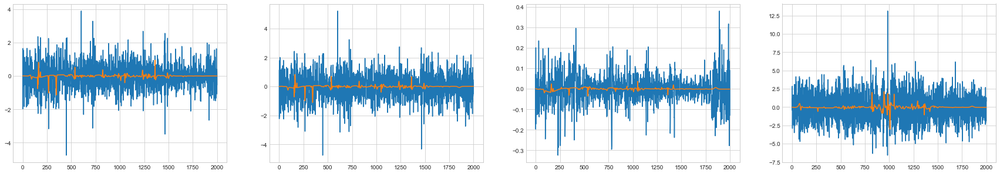

34th additional rbflayer
34th additional RBFlayer 0th epoch loss: 7.533999493338476
34th additional RBFlayer 999th epoch MSE Loss: 2.1330583775629712
34th additional RBFlayer 1999th epoch MSE Loss: 2.0614405390057184
34th additional RBFlayer 2999th epoch MSE Loss: 2.0397753750777534
34th additional RBFlayer best loss : 2.039760895886239


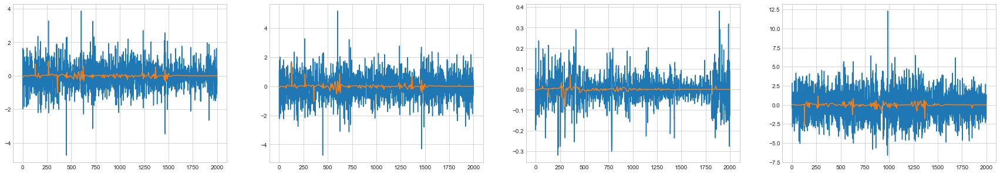

35th additional rbflayer
35th additional RBFlayer 0th epoch loss: 5.478332220166405
35th additional RBFlayer 999th epoch MSE Loss: 2.089824104516911
35th additional RBFlayer 1999th epoch MSE Loss: 2.0299172043676212
35th additional RBFlayer 2999th epoch MSE Loss: 2.011484771865
35th additional RBFlayer best loss : 2.0114729366693638


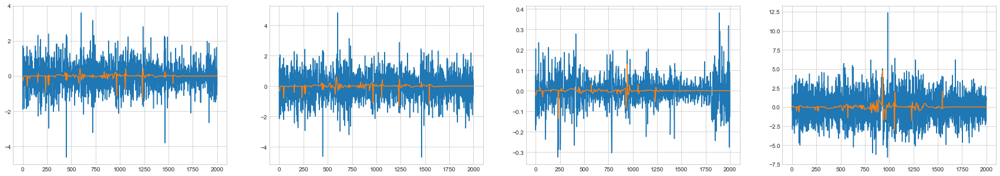

36th additional rbflayer
36th additional RBFlayer 0th epoch loss: 7.598546657782881
36th additional RBFlayer 999th epoch MSE Loss: 2.0876505869690583
36th additional RBFlayer 1999th epoch MSE Loss: 2.0268910883239886
36th additional RBFlayer 2999th epoch MSE Loss: 2.0099629532314505
36th additional RBFlayer best loss : 2.009952306846818


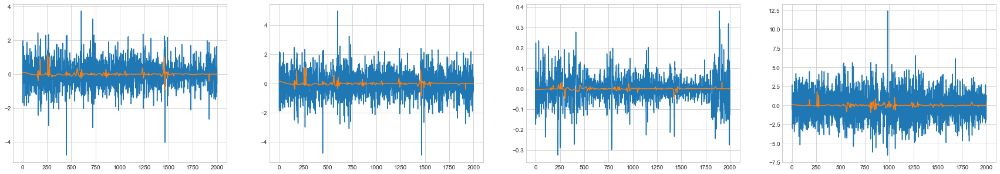

37th additional rbflayer
37th additional RBFlayer 0th epoch loss: 7.45092907879294
37th additional RBFlayer 999th epoch MSE Loss: 2.0928153850613382
37th additional RBFlayer 1999th epoch MSE Loss: 2.024599939988639
37th additional RBFlayer 2999th epoch MSE Loss: 2.0063310860957
37th additional RBFlayer best loss : 2.0063199852836675


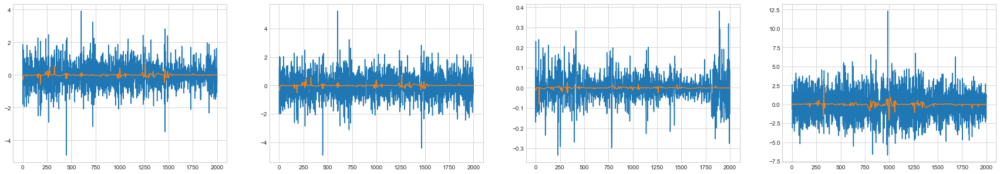

38th additional rbflayer
38th additional RBFlayer 0th epoch loss: 6.62656935430577
38th additional RBFlayer 999th epoch MSE Loss: 2.095004089301552
38th additional RBFlayer 1999th epoch MSE Loss: 2.02885224426364
38th additional RBFlayer 2999th epoch MSE Loss: 2.009900666741578
38th additional RBFlayer best loss : 2.0098888057070687


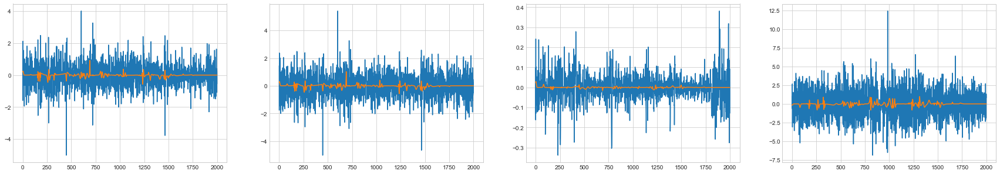

39th additional rbflayer
39th additional RBFlayer 0th epoch loss: 5.778695942896855
39th additional RBFlayer 999th epoch MSE Loss: 2.1037653207620037
39th additional RBFlayer 1999th epoch MSE Loss: 2.034914032112924
39th additional RBFlayer 2999th epoch MSE Loss: 2.0134659205045615
39th additional RBFlayer best loss : 2.013452356172328


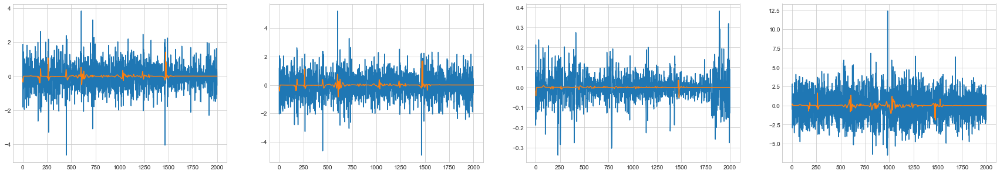

40th additional rbflayer
40th additional RBFlayer 0th epoch loss: 3.693761368106937
40th additional RBFlayer 999th epoch MSE Loss: 2.003383774626681
40th additional RBFlayer 1999th epoch MSE Loss: 1.9613659243211883
40th additional RBFlayer 2999th epoch MSE Loss: 1.9468231568848147
40th additional RBFlayer best loss : 1.9468129398438365


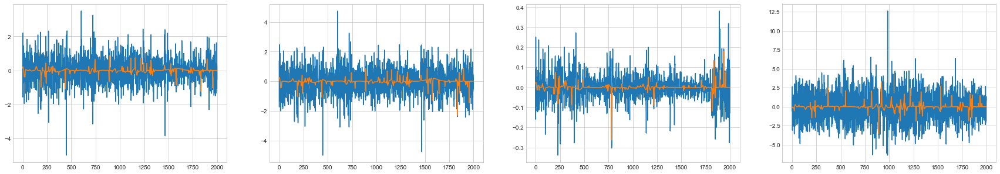

In [23]:
model_weather = MultiRBFnn(weather_target.size(0), 100, device)
model_weather.train(input_, weather_target, 3000, 0.00001, 2, 4)

<Figure size 2160x720 with 0 Axes>

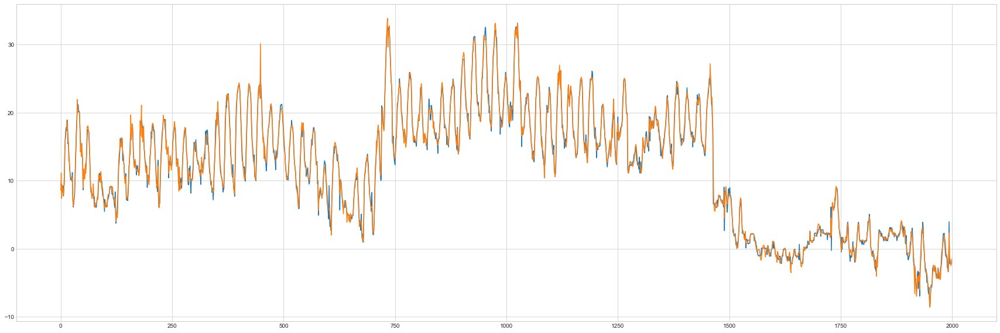

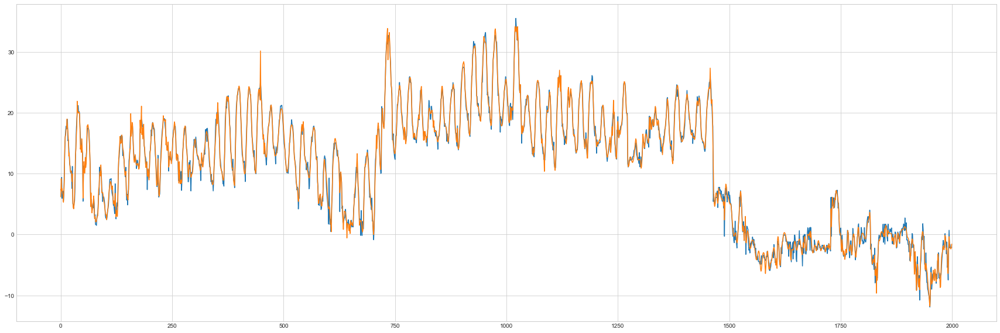

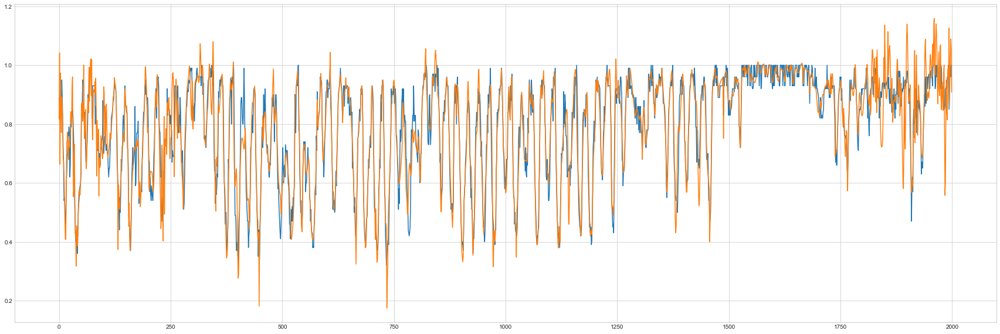

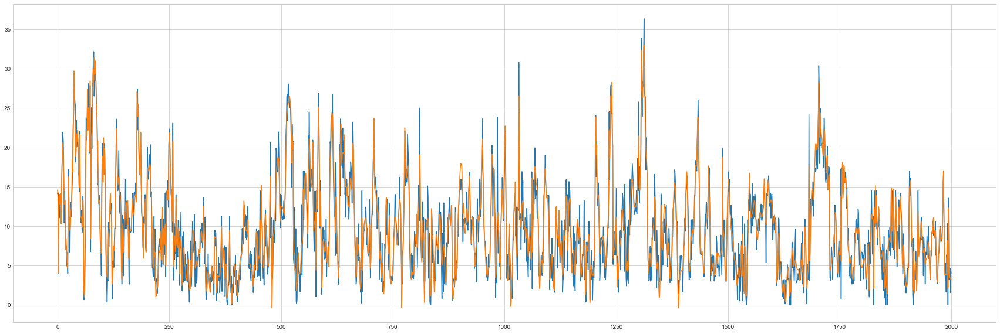

In [24]:
plt.figure(figsize=(30, 10))
model_pred = model_weather.pred(weather_input)[1]
for i in range(weather_target.size(0)):
    plt.figure(figsize=(30, 10))
    plt.plot(input_.cpu().detach().numpy(), weather_target[i].cpu().detach().numpy())
    plt.plot(input_.cpu().detach().numpy(), model_pred[i].cpu().detach().numpy())
    plt.show()

In [25]:
# traffic - gangnam dataset

gang = pd.read_csv('../dataset/road_gang.csv')
gang_col = gang.columns
gang_df = gang[gang_col[3:7]][:2000]
gang_target = gang_df.values
gang_input = list(gang_df.index)

gang_input = torch.tensor(gang_input, device = device, dtype = float)
gang_target = torch.tensor(gang_target.T, dtype = float, device = device)

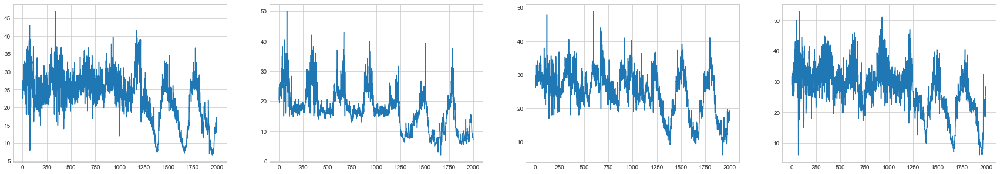

In [26]:
plot_data(gang_input, gang_target.size(0), gang_target)

0th additional rbflayer
0th additional RBFlayer 0th epoch loss: 730.1939077119688
0th additional RBFlayer 999th epoch MSE Loss: 316.1580487458918
0th additional RBFlayer 1999th epoch MSE Loss: 250.1640552013502
0th additional RBFlayer 2999th epoch MSE Loss: 198.2822385373107
0th additional RBFlayer best loss : 198.2822385373107


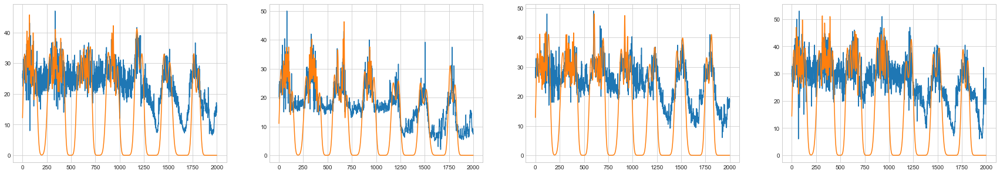

1th additional rbflayer
1th additional RBFlayer 0th epoch loss: 303.2323476365771
1th additional RBFlayer 999th epoch MSE Loss: 104.99779668871803
1th additional RBFlayer 1999th epoch MSE Loss: 93.37031337045066
1th additional RBFlayer 2999th epoch MSE Loss: 87.96817496313578
1th additional RBFlayer best loss : 87.82316609131408
change lr  0.0001
----------------------------------------------


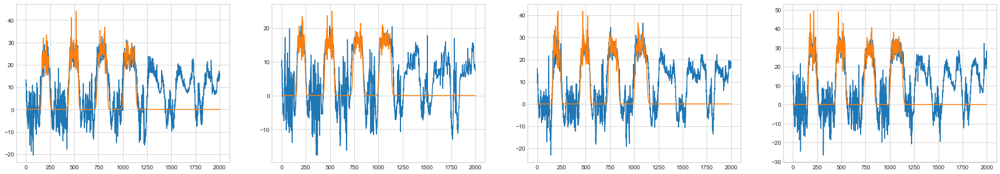

2th additional rbflayer
2th additional RBFlayer 0th epoch loss: 260.24081404922185
2th additional RBFlayer 999th epoch MSE Loss: 32.39760914067509
2th additional RBFlayer 1999th epoch MSE Loss: 31.341526521455325
2th additional RBFlayer 2999th epoch MSE Loss: 31.123481269114457
2th additional RBFlayer best loss : 31.123355546413467


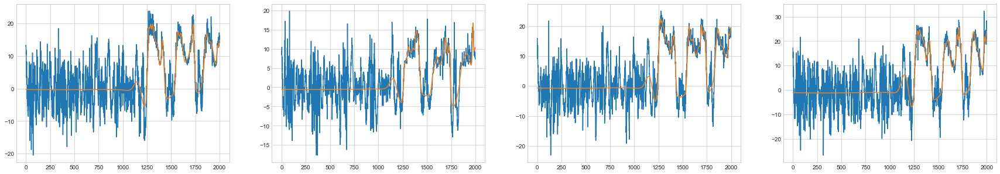

3th additional rbflayer
3th additional RBFlayer 0th epoch loss: 103.17726486897851
3th additional RBFlayer 999th epoch MSE Loss: 23.05831220002574
3th additional RBFlayer 1999th epoch MSE Loss: 22.76970076621321
3th additional RBFlayer 2999th epoch MSE Loss: 22.718582019537244
3th additional RBFlayer best loss : 22.713282094880245


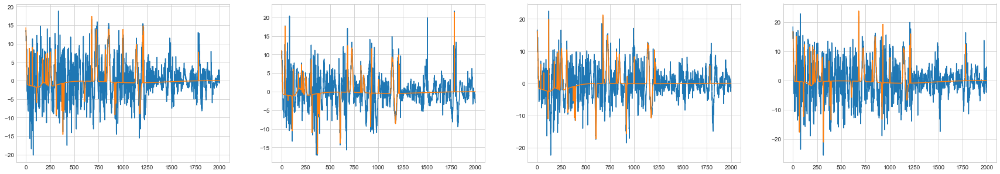

4th additional rbflayer
4th additional RBFlayer 0th epoch loss: 28.649174952591405
4th additional RBFlayer 999th epoch MSE Loss: 16.76617016733675
4th additional RBFlayer 1999th epoch MSE Loss: 16.506562552058895
4th additional RBFlayer 2999th epoch MSE Loss: 16.434217400337047
4th additional RBFlayer best loss : 16.42227553479864


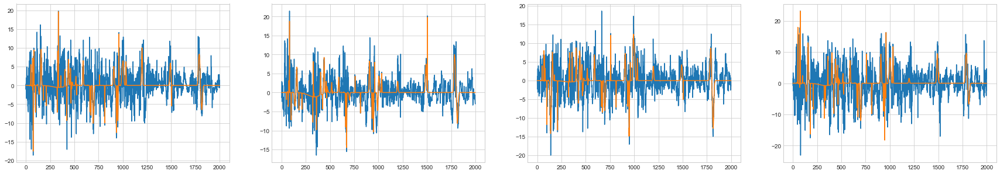

5th additional rbflayer
5th additional RBFlayer 0th epoch loss: 16.61926337669413
5th additional RBFlayer 999th epoch MSE Loss: 13.238452698121419
5th additional RBFlayer 1999th epoch MSE Loss: 13.175922344700256
5th additional RBFlayer 2999th epoch MSE Loss: 13.135853678384699
5th additional RBFlayer best loss : 13.111454990815428


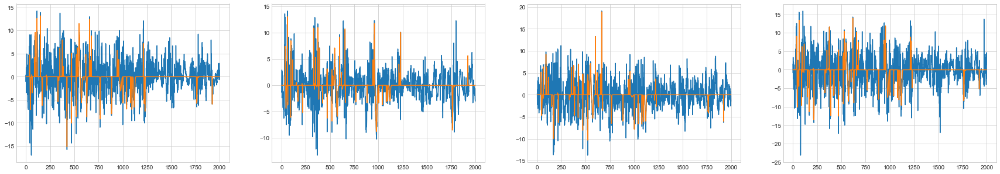

6th additional rbflayer
6th additional RBFlayer 0th epoch loss: 13.28162266452967
6th additional RBFlayer 999th epoch MSE Loss: 10.868056771348751
6th additional RBFlayer 1999th epoch MSE Loss: 10.746086319183872
6th additional RBFlayer 2999th epoch MSE Loss: 10.704650461952838
6th additional RBFlayer best loss : 10.704650461952838


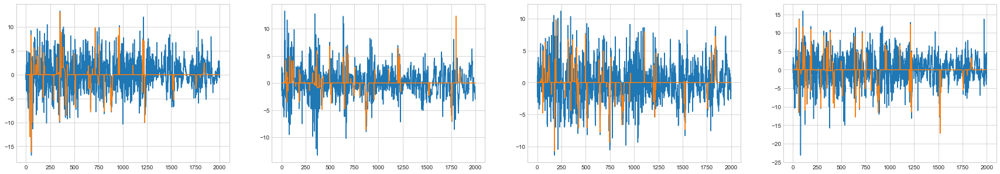

7th additional rbflayer
7th additional RBFlayer 0th epoch loss: 11.755298191110203
7th additional RBFlayer 999th epoch MSE Loss: 9.271734852213395
7th additional RBFlayer 1999th epoch MSE Loss: 9.236361817270376
7th additional RBFlayer 2999th epoch MSE Loss: 9.20804689464053
7th additional RBFlayer best loss : 9.17346950538842


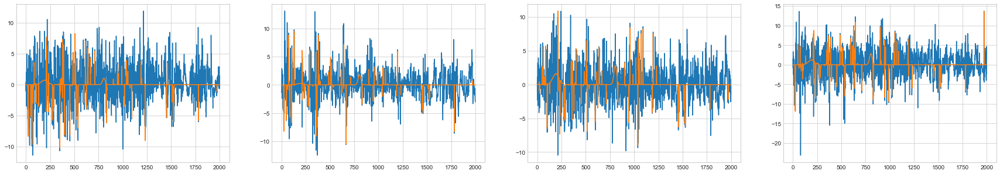

8th additional rbflayer
8th additional RBFlayer 0th epoch loss: 9.924883066774568
8th additional RBFlayer 999th epoch MSE Loss: 8.156840144723773
8th additional RBFlayer 1999th epoch MSE Loss: 8.131171694808893
8th additional RBFlayer 2999th epoch MSE Loss: 8.12125599704527
8th additional RBFlayer best loss : 8.12125599704527


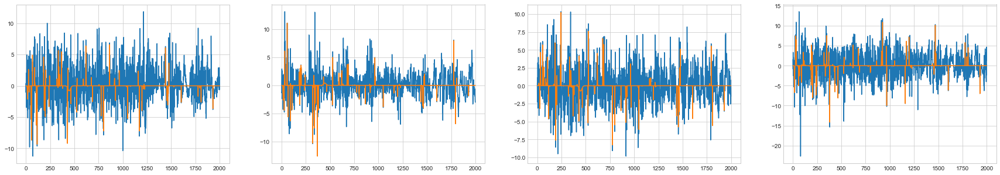

9th additional rbflayer
9th additional RBFlayer 0th epoch loss: 9.33043602998952
9th additional RBFlayer 999th epoch MSE Loss: 7.445727992610503
9th additional RBFlayer 1999th epoch MSE Loss: 7.443665716551124
9th additional RBFlayer 2999th epoch MSE Loss: 7.435819828174453
9th additional RBFlayer best loss : 7.41419349836447


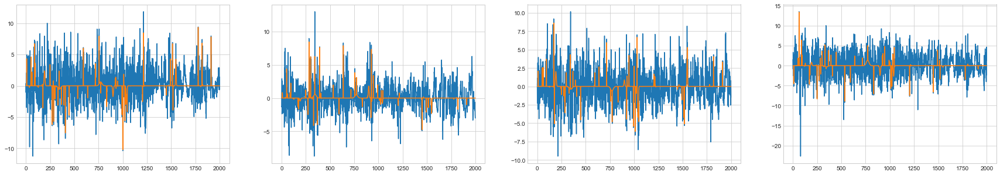

10th additional rbflayer
10th additional RBFlayer 0th epoch loss: 8.096772183944136
10th additional RBFlayer 999th epoch MSE Loss: 6.839813088949683
10th additional RBFlayer 1999th epoch MSE Loss: 6.8237284835137615
10th additional RBFlayer 2999th epoch MSE Loss: 6.8090777005017005
10th additional RBFlayer best loss : 6.803118385216813


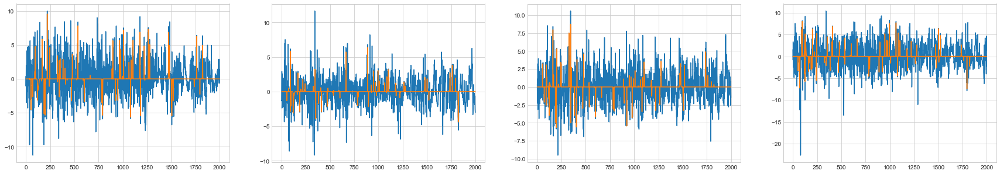

11th additional rbflayer
11th additional RBFlayer 0th epoch loss: 7.992604656338895
11th additional RBFlayer 999th epoch MSE Loss: 6.32538074713479
11th additional RBFlayer 1999th epoch MSE Loss: 6.305076211861987
11th additional RBFlayer 2999th epoch MSE Loss: 6.296790625548202
11th additional RBFlayer best loss : 6.296784861237027


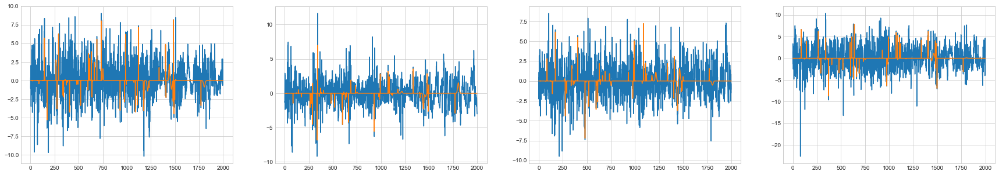

12th additional rbflayer
12th additional RBFlayer 0th epoch loss: 8.599428216561533
12th additional RBFlayer 999th epoch MSE Loss: 5.887154797838415
12th additional RBFlayer 1999th epoch MSE Loss: 5.856431598166008
12th additional RBFlayer 2999th epoch MSE Loss: 5.836256933163368
12th additional RBFlayer best loss : 5.836256188786921


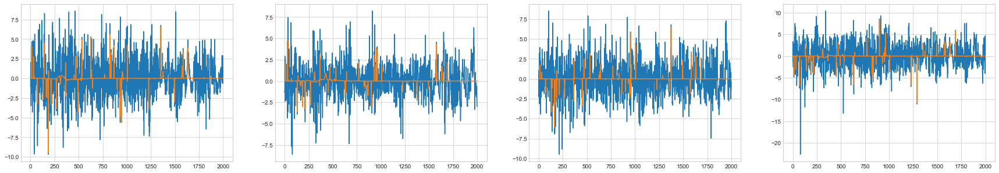

13th additional rbflayer
13th additional RBFlayer 0th epoch loss: 7.040111393705587
13th additional RBFlayer 999th epoch MSE Loss: 5.492487023063669
13th additional RBFlayer 1999th epoch MSE Loss: 5.495743641716713
13th additional RBFlayer 2999th epoch MSE Loss: 5.491282850303607
13th additional RBFlayer best loss : 5.461276329347983


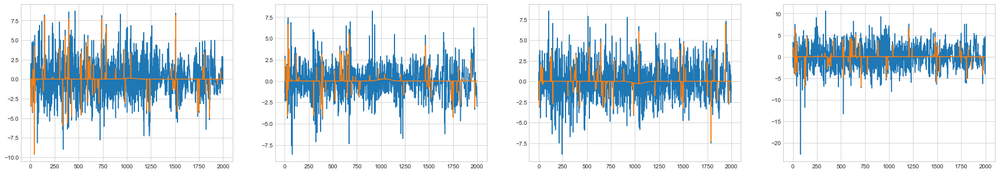

14th additional rbflayer
14th additional RBFlayer 0th epoch loss: 6.39901905396577
14th additional RBFlayer 999th epoch MSE Loss: 5.0655258977707724
14th additional RBFlayer 1999th epoch MSE Loss: 5.04858954020953
14th additional RBFlayer 2999th epoch MSE Loss: 5.020172795772245
14th additional RBFlayer best loss : 5.020151068646657


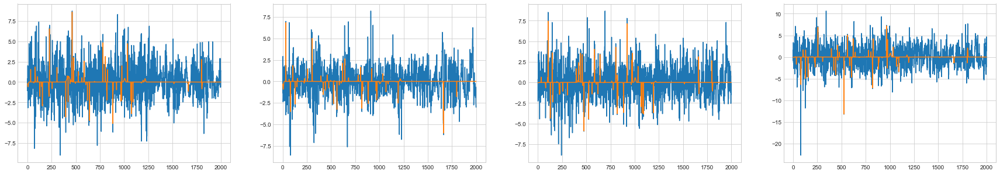

15th additional rbflayer
15th additional RBFlayer 0th epoch loss: 6.31173093050807
15th additional RBFlayer 999th epoch MSE Loss: 4.697076054246288
15th additional RBFlayer 1999th epoch MSE Loss: 4.689546550829191
15th additional RBFlayer 2999th epoch MSE Loss: 4.683823437871377
15th additional RBFlayer best loss : 4.683820444364901


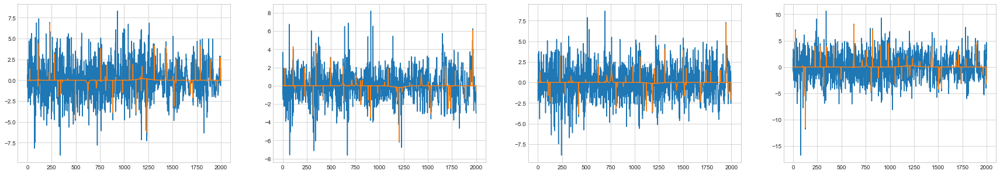

16th additional rbflayer
16th additional RBFlayer 0th epoch loss: 5.424044404542558
16th additional RBFlayer 999th epoch MSE Loss: 4.473440323625024
16th additional RBFlayer 1999th epoch MSE Loss: 4.460162331769788
16th additional RBFlayer 2999th epoch MSE Loss: 4.4508456922067525
16th additional RBFlayer best loss : 4.45083802222725


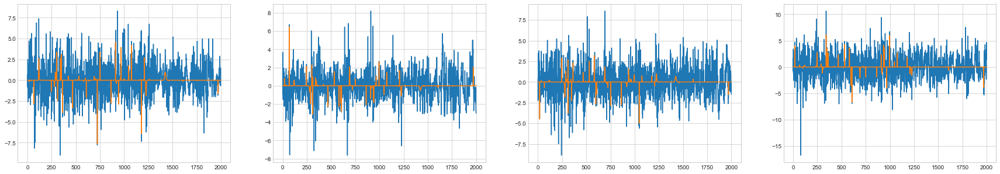

17th additional rbflayer
17th additional RBFlayer 0th epoch loss: 5.022592920524068
17th additional RBFlayer 999th epoch MSE Loss: 4.214640317873235
17th additional RBFlayer 1999th epoch MSE Loss: 4.2243394812842325
17th additional RBFlayer 2999th epoch MSE Loss: 4.220198973157096
17th additional RBFlayer best loss : 4.209917469414352


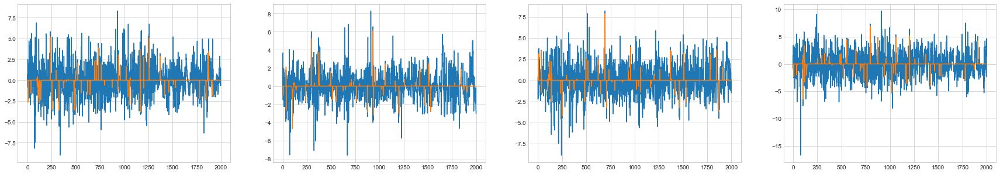

18th additional rbflayer
18th additional RBFlayer 0th epoch loss: 5.004897373352562
18th additional RBFlayer 999th epoch MSE Loss: 3.966181051890775
18th additional RBFlayer 1999th epoch MSE Loss: 3.9565973929366804
18th additional RBFlayer 2999th epoch MSE Loss: 3.9528080025258947
18th additional RBFlayer best loss : 3.9528040741974375


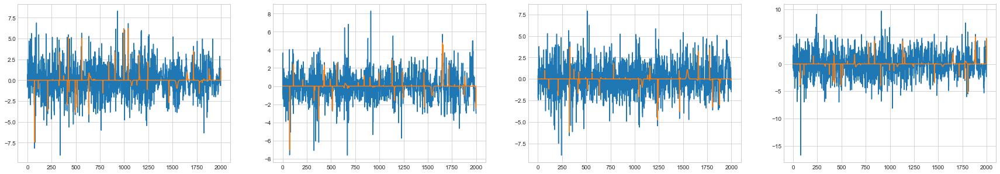

19th additional rbflayer
19th additional RBFlayer 0th epoch loss: 5.040863984941521
19th additional RBFlayer 999th epoch MSE Loss: 3.7696765019949736
19th additional RBFlayer 1999th epoch MSE Loss: 3.7723737313694023
19th additional RBFlayer 2999th epoch MSE Loss: 3.7678572200619698
19th additional RBFlayer best loss : 3.76743908239191


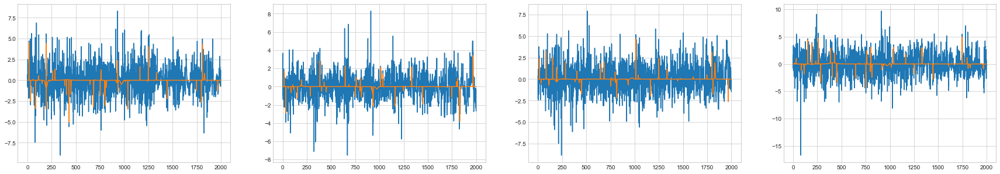

20th additional rbflayer
20th additional RBFlayer 0th epoch loss: 4.808843272364205
20th additional RBFlayer 999th epoch MSE Loss: 3.6007369519679226
20th additional RBFlayer 1999th epoch MSE Loss: 3.589575814789705
20th additional RBFlayer 2999th epoch MSE Loss: 3.5911536665740216
20th additional RBFlayer best loss : 3.5883114966369


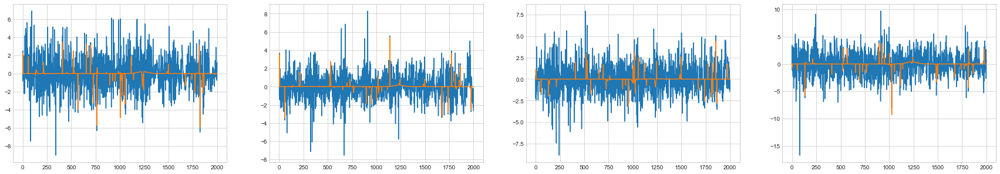

21th additional rbflayer
21th additional RBFlayer 0th epoch loss: 4.346685462633334
21th additional RBFlayer 999th epoch MSE Loss: 3.3997595044401057
21th additional RBFlayer 1999th epoch MSE Loss: 3.4060997630321426
21th additional RBFlayer 2999th epoch MSE Loss: 3.402484752117768
21th additional RBFlayer best loss : 3.3967080950446054


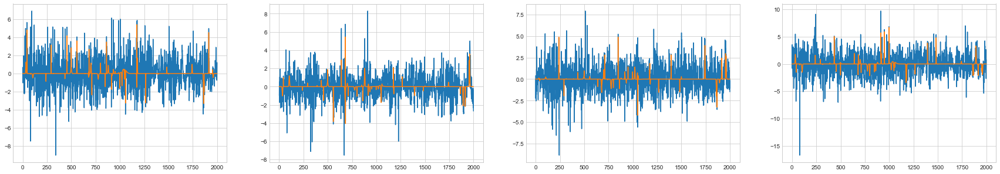

22th additional rbflayer
22th additional RBFlayer 0th epoch loss: 4.4860922302552675
22th additional RBFlayer 999th epoch MSE Loss: 3.2675263788347366
22th additional RBFlayer 1999th epoch MSE Loss: 3.261114411476827
22th additional RBFlayer 2999th epoch MSE Loss: 3.2623848377648175
22th additional RBFlayer best loss : 3.261091889670191


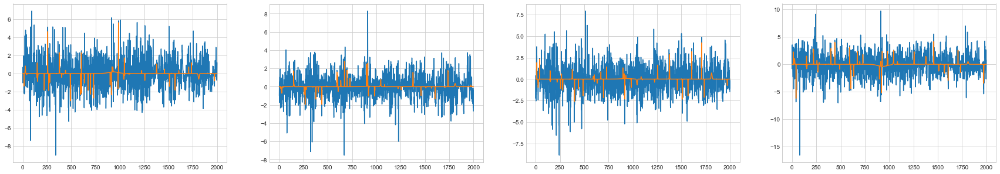

23th additional rbflayer
23th additional RBFlayer 0th epoch loss: 5.255649052826349
23th additional RBFlayer 999th epoch MSE Loss: 3.118530573533918
23th additional RBFlayer 1999th epoch MSE Loss: 3.1143365434245442
23th additional RBFlayer 2999th epoch MSE Loss: 3.112566263850291
23th additional RBFlayer best loss : 3.108955411276708


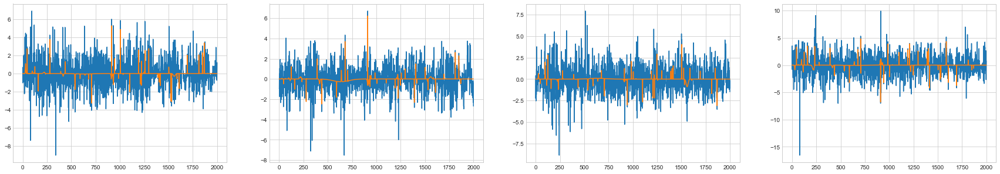

24th additional rbflayer
24th additional RBFlayer 0th epoch loss: 4.761429997177065
24th additional RBFlayer 999th epoch MSE Loss: 2.9452099068584783
24th additional RBFlayer 1999th epoch MSE Loss: 2.942766088720406
24th additional RBFlayer 2999th epoch MSE Loss: 2.9405777237614954
24th additional RBFlayer best loss : 2.940526414829557
change lr  0.001
----------------------------------------------


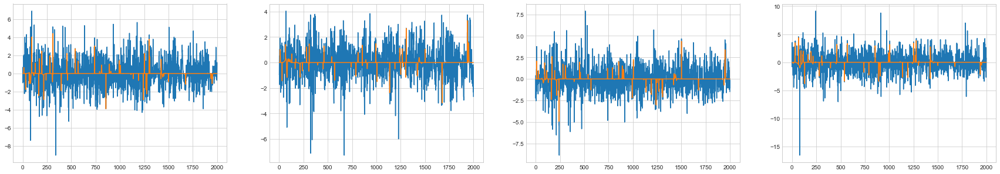

25th additional rbflayer
25th additional RBFlayer 0th epoch loss: 3.4805418391368845
25th additional RBFlayer 999th epoch MSE Loss: 2.7584405150135636
25th additional RBFlayer 1999th epoch MSE Loss: 2.7459581750991138
25th additional RBFlayer 2999th epoch MSE Loss: 2.771593728508669
25th additional RBFlayer best loss : 2.7264087923222022


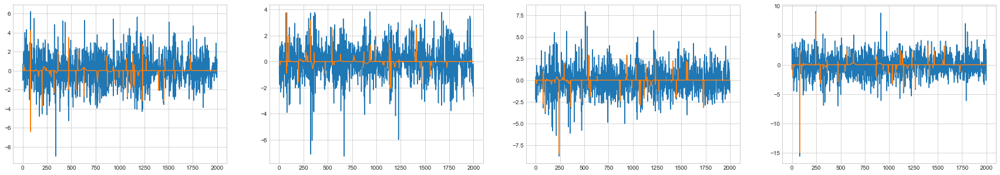

26th additional rbflayer
26th additional RBFlayer 0th epoch loss: 3.924414298624176
26th additional RBFlayer 999th epoch MSE Loss: 2.5656210833881072
26th additional RBFlayer 1999th epoch MSE Loss: 2.559573706448446
26th additional RBFlayer 2999th epoch MSE Loss: 2.559851483065947
26th additional RBFlayer best loss : 2.5559042745499716


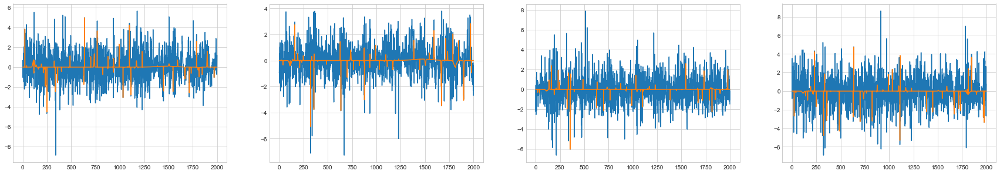

27th additional rbflayer
27th additional RBFlayer 0th epoch loss: 3.257164792711663
27th additional RBFlayer 999th epoch MSE Loss: 2.4112880506728094
27th additional RBFlayer 1999th epoch MSE Loss: 2.4181015335713925
27th additional RBFlayer 2999th epoch MSE Loss: 2.4245234302744856
27th additional RBFlayer best loss : 2.4039873014865853


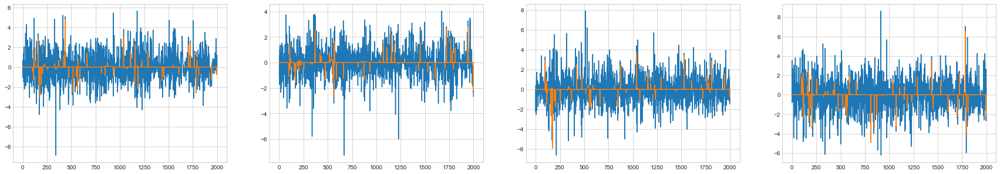

28th additional rbflayer
28th additional RBFlayer 0th epoch loss: 2.9488352652097225
28th additional RBFlayer 999th epoch MSE Loss: 2.2748026804711703
28th additional RBFlayer 1999th epoch MSE Loss: 2.2830065002173923
28th additional RBFlayer 2999th epoch MSE Loss: 2.2842112455357673
28th additional RBFlayer best loss : 2.2697313073055705


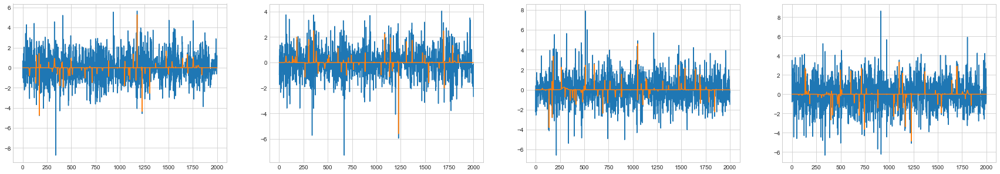

29th additional rbflayer
29th additional RBFlayer 0th epoch loss: 3.810430438716653
29th additional RBFlayer 999th epoch MSE Loss: 2.1521986561244457
29th additional RBFlayer 1999th epoch MSE Loss: 2.152870441528998
29th additional RBFlayer 2999th epoch MSE Loss: 2.1566485416078236
29th additional RBFlayer best loss : 2.1504776077337926


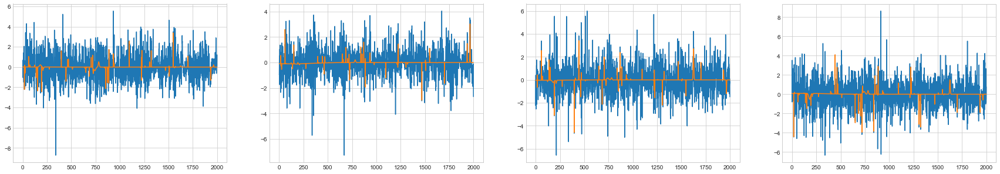

30th additional rbflayer
30th additional RBFlayer 0th epoch loss: 2.5961929262951764
30th additional RBFlayer 999th epoch MSE Loss: 2.0622375959329093
30th additional RBFlayer 1999th epoch MSE Loss: 2.063740240376665
30th additional RBFlayer 2999th epoch MSE Loss: 2.0663692456283607
30th additional RBFlayer best loss : 2.0608973032316134


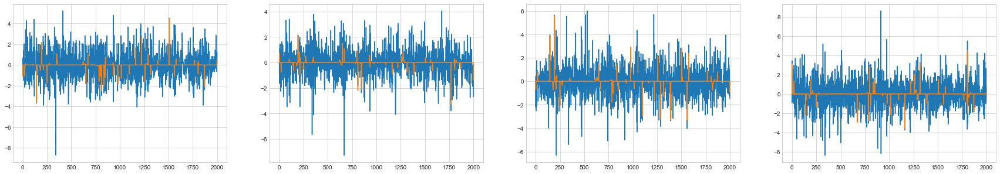

31th additional rbflayer
31th additional RBFlayer 0th epoch loss: 2.5820699408702414
31th additional RBFlayer 999th epoch MSE Loss: 1.9458619748397732
31th additional RBFlayer 1999th epoch MSE Loss: 1.9350023529840765
31th additional RBFlayer 2999th epoch MSE Loss: 1.933750439935424
31th additional RBFlayer best loss : 1.932784946237603


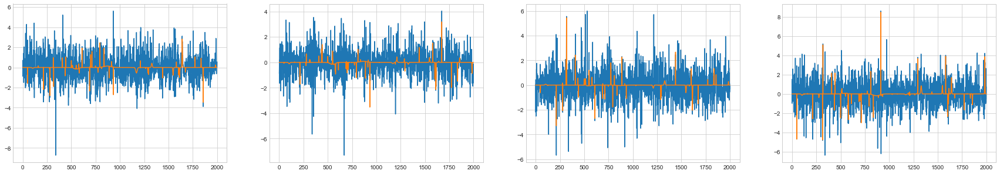

In [34]:
model_gang = MultiRBFnn(gang_target.size(0), 100, device)
model_gang.train(input_, gang_target, 3000, 0.00001, 2, 100)

<Figure size 2160x720 with 0 Axes>

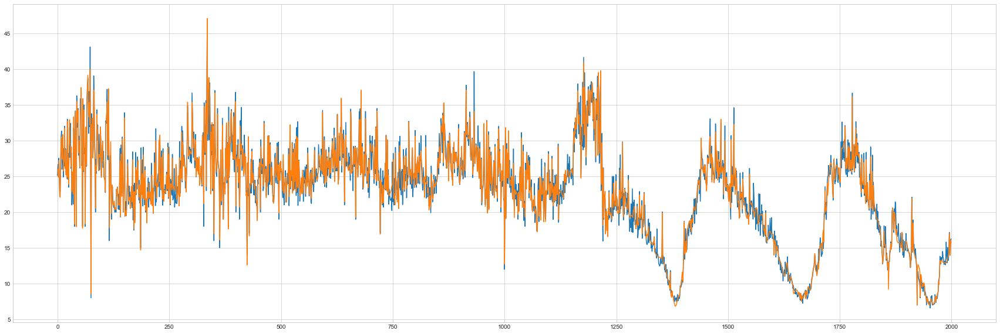

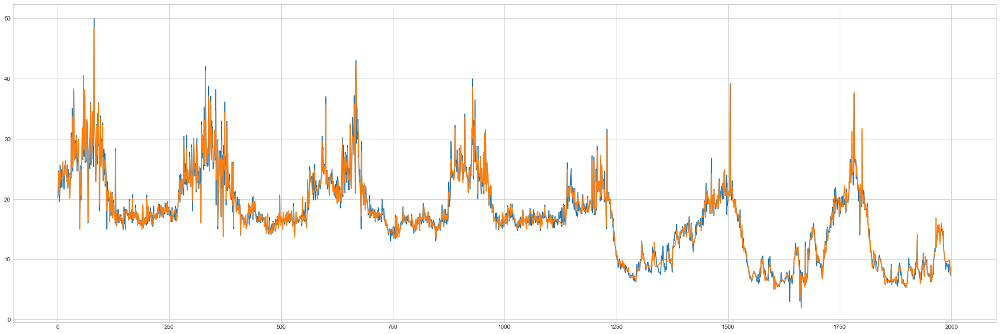

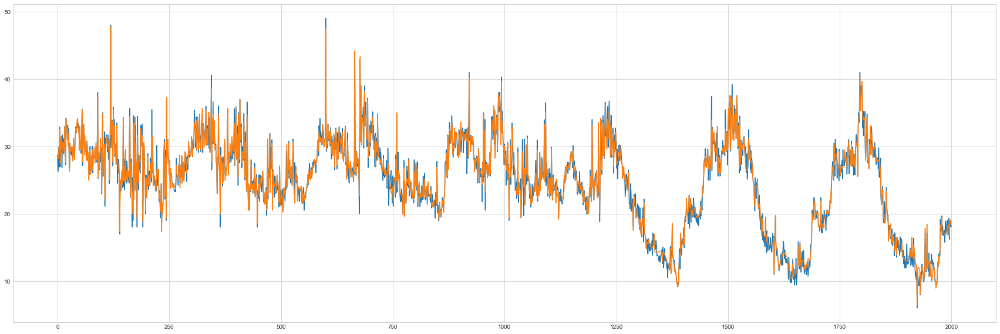

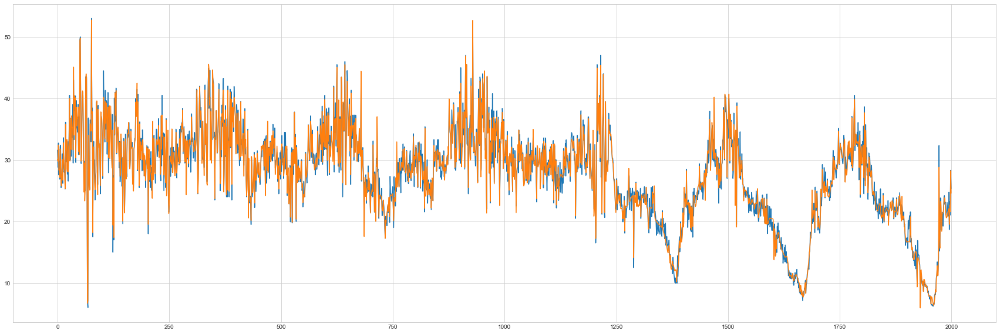

In [35]:
plt.figure(figsize=(30, 10))
model_pred = model_gang.pred(gang_input)[1]
for i in range(gang_target.size(0)):
    plt.figure(figsize=(30, 10))
    plt.plot(input_.cpu().detach().numpy(), gang_target[i].cpu().detach().numpy())
    plt.plot(input_.cpu().detach().numpy(), model_pred[i].cpu().detach().numpy())
    plt.show()

In [42]:
gang_df2 = gang[gang_col[8:15]][1000:3000].reset_index(drop=True)
gang_target2 = gang_df2.values
gang_input = list(gang_df2.index)

gang_input = torch.tensor(gang_input, device = device, dtype = float)
gang_target2 = torch.tensor(gang_target2.T, dtype = float, device = device)

In [48]:
gang_input.size()

torch.Size([1880])

In [49]:
gang_target2.size()

torch.Size([7, 1880])

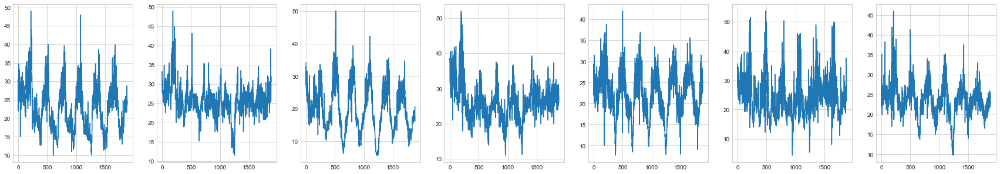

In [43]:
plot_data(gang_input, gang_target2.size(0), gang_target2)

0th additional rbflayer
0th additional RBFlayer 0th epoch loss: 1355.2679774874318
0th additional RBFlayer 999th epoch MSE Loss: 362.7067176136914
0th additional RBFlayer 1999th epoch MSE Loss: 298.46713126161046
0th additional RBFlayer 2999th epoch MSE Loss: 246.47548602576526
0th additional RBFlayer best loss : 246.47548602576526


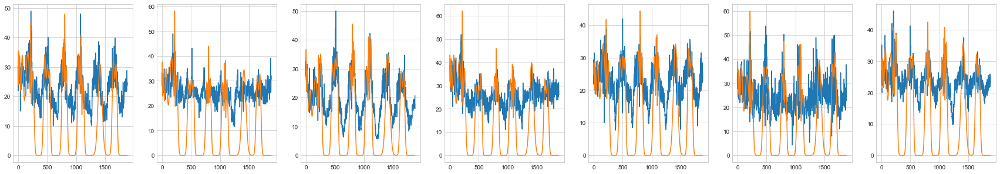

1th additional rbflayer
1th additional RBFlayer 0th epoch loss: 435.420045369384
1th additional RBFlayer 999th epoch MSE Loss: 164.96413047996512
1th additional RBFlayer 1999th epoch MSE Loss: 150.47481171734896
1th additional RBFlayer 2999th epoch MSE Loss: 138.4835492757572
1th additional RBFlayer best loss : 138.3909270939286


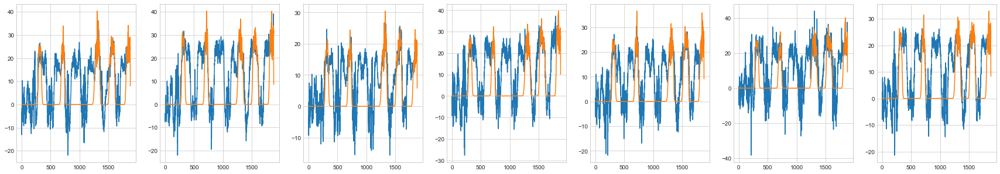

2th additional rbflayer
2th additional RBFlayer 0th epoch loss: 383.5182313834638
2th additional RBFlayer 999th epoch MSE Loss: 72.42212866588551
2th additional RBFlayer 1999th epoch MSE Loss: 62.633308788414624
2th additional RBFlayer 2999th epoch MSE Loss: 56.01539336638804
2th additional RBFlayer best loss : 55.90252954943985
change lr  0.0001
----------------------------------------------


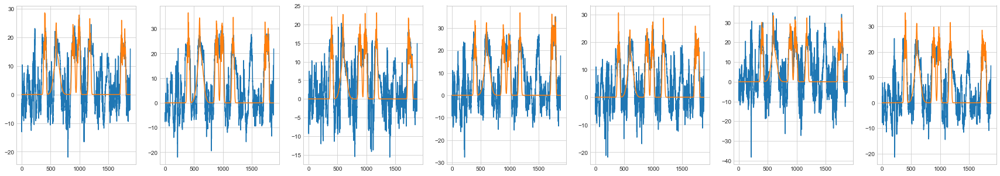

3th additional rbflayer
3th additional RBFlayer 0th epoch loss: 201.50020518783384
3th additional RBFlayer 999th epoch MSE Loss: 31.794993404138705
3th additional RBFlayer 1999th epoch MSE Loss: 31.124390836482426
3th additional RBFlayer 2999th epoch MSE Loss: 30.91980555934105
3th additional RBFlayer best loss : 31.810097833861388


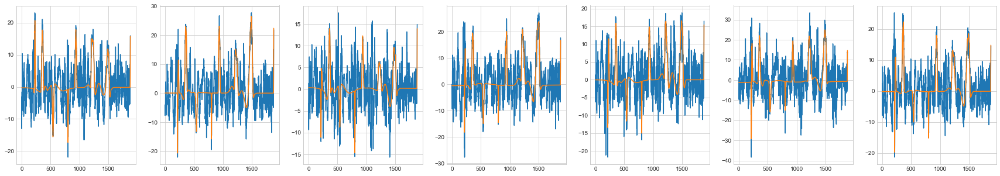

4th additional rbflayer
4th additional RBFlayer 0th epoch loss: 67.29795098353362
4th additional RBFlayer 999th epoch MSE Loss: 24.1663431698481
4th additional RBFlayer 1999th epoch MSE Loss: 23.607248806503026
4th additional RBFlayer 2999th epoch MSE Loss: 23.44699094731848
4th additional RBFlayer best loss : 23.449404684562076


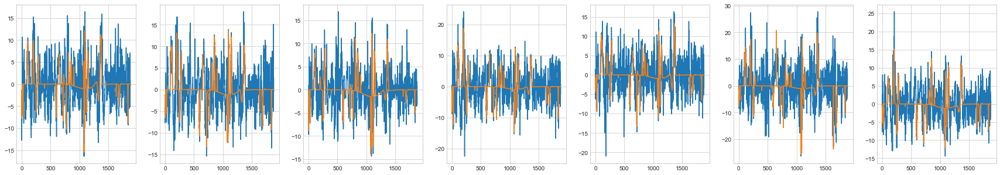

5th additional rbflayer
5th additional RBFlayer 0th epoch loss: 28.822511568618747
5th additional RBFlayer 999th epoch MSE Loss: 17.996014088374395
5th additional RBFlayer 1999th epoch MSE Loss: 17.504624108192974
5th additional RBFlayer 2999th epoch MSE Loss: 17.310830940798464
5th additional RBFlayer best loss : 17.313512018550774


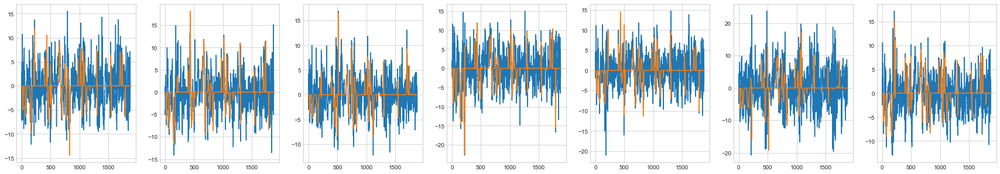

6th additional rbflayer
6th additional RBFlayer 0th epoch loss: 19.287748313378106
6th additional RBFlayer 999th epoch MSE Loss: 14.738416982944992
6th additional RBFlayer 1999th epoch MSE Loss: 14.609013669366274
6th additional RBFlayer 2999th epoch MSE Loss: 14.521267665440421
6th additional RBFlayer best loss : 14.514477730134713


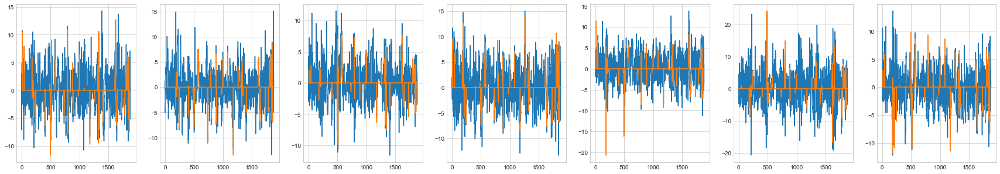

7th additional rbflayer
7th additional RBFlayer 0th epoch loss: 16.04027070369801
7th additional RBFlayer 999th epoch MSE Loss: 12.64725529664858
7th additional RBFlayer 1999th epoch MSE Loss: 12.596118052668116
7th additional RBFlayer 2999th epoch MSE Loss: 12.528528428568583
7th additional RBFlayer best loss : 12.518999668538248


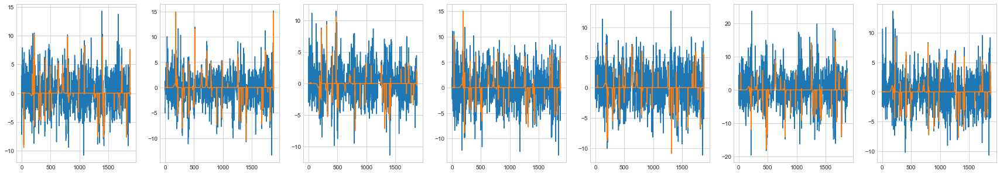

8th additional rbflayer
8th additional RBFlayer 0th epoch loss: 21.38606395876858
8th additional RBFlayer 999th epoch MSE Loss: 11.183247484037283
8th additional RBFlayer 1999th epoch MSE Loss: 11.173340484289376
8th additional RBFlayer 2999th epoch MSE Loss: 11.155471652764213
8th additional RBFlayer best loss : 11.12645060892727


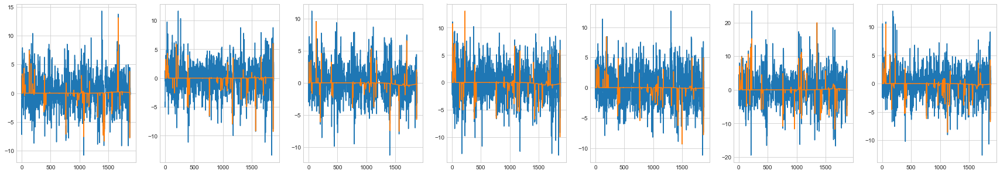

9th additional rbflayer
9th additional RBFlayer 0th epoch loss: 21.609502703080167
9th additional RBFlayer 999th epoch MSE Loss: 10.232518915276616
9th additional RBFlayer 1999th epoch MSE Loss: 10.181292512091654
9th additional RBFlayer 2999th epoch MSE Loss: 10.172997330424748
9th additional RBFlayer best loss : 10.172997330424748


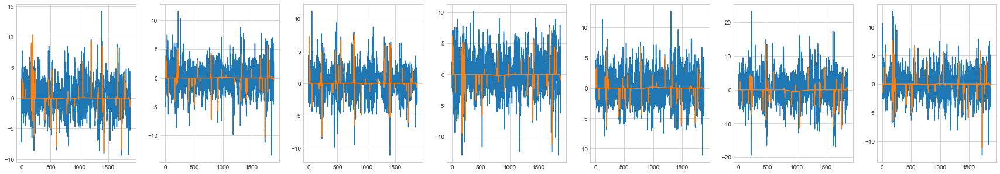

10th additional rbflayer
10th additional RBFlayer 0th epoch loss: 12.5525404917653
10th additional RBFlayer 999th epoch MSE Loss: 9.340698633617384
10th additional RBFlayer 1999th epoch MSE Loss: 9.329162737969314
10th additional RBFlayer 2999th epoch MSE Loss: 9.307433243813371
10th additional RBFlayer best loss : 9.307433243813371
change lr  0.001
----------------------------------------------


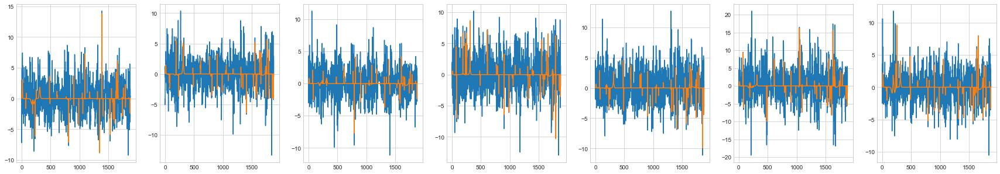

11th additional rbflayer
11th additional RBFlayer 0th epoch loss: 10.943746099063429
11th additional RBFlayer 999th epoch MSE Loss: 8.634712120491479
11th additional RBFlayer 1999th epoch MSE Loss: 8.617924437354503
11th additional RBFlayer 2999th epoch MSE Loss: 8.619751483662839
11th additional RBFlayer best loss : 8.610794719054024


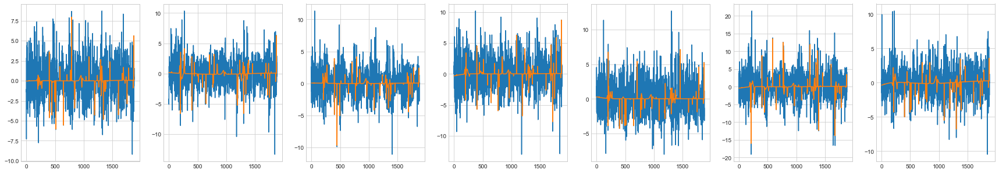

12th additional rbflayer
12th additional RBFlayer 0th epoch loss: 10.040143134218832
12th additional RBFlayer 999th epoch MSE Loss: 8.125802768551845
12th additional RBFlayer 1999th epoch MSE Loss: 8.113672862499541
12th additional RBFlayer 2999th epoch MSE Loss: 8.129072079505484
12th additional RBFlayer best loss : 8.08694708325579


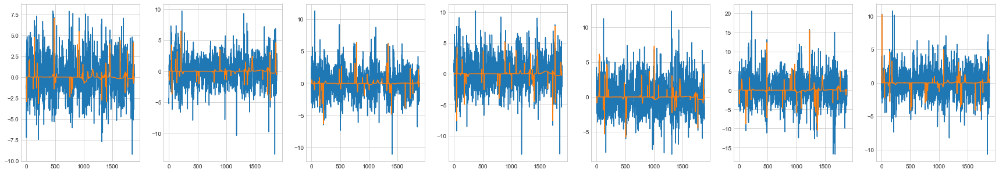

13th additional rbflayer
13th additional RBFlayer 0th epoch loss: 10.264679397329305
13th additional RBFlayer 999th epoch MSE Loss: 7.723831955996308
13th additional RBFlayer 1999th epoch MSE Loss: 7.703501936623236
13th additional RBFlayer 2999th epoch MSE Loss: 7.725885605258239
13th additional RBFlayer best loss : 7.701610756712774


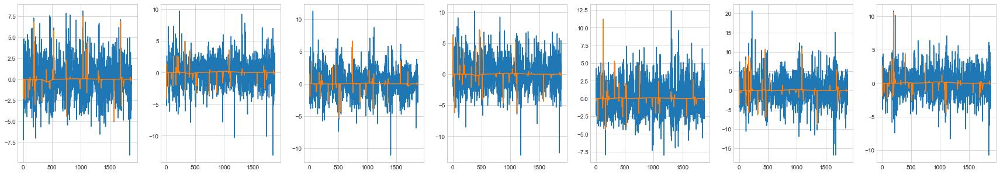

14th additional rbflayer
14th additional RBFlayer 0th epoch loss: 11.408046042770806
14th additional RBFlayer 999th epoch MSE Loss: 7.390121399881507
14th additional RBFlayer 1999th epoch MSE Loss: 7.38861702310497
14th additional RBFlayer 2999th epoch MSE Loss: 7.371762842489865
14th additional RBFlayer best loss : 7.3661073166834115


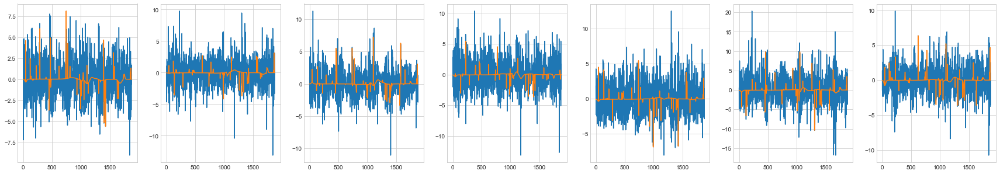

15th additional rbflayer
15th additional RBFlayer 0th epoch loss: 16.24801435613382
15th additional RBFlayer 999th epoch MSE Loss: 6.909162744870196
15th additional RBFlayer 1999th epoch MSE Loss: 6.977569804162587
15th additional RBFlayer 2999th epoch MSE Loss: 6.975482324081324
15th additional RBFlayer best loss : 6.902312009098662


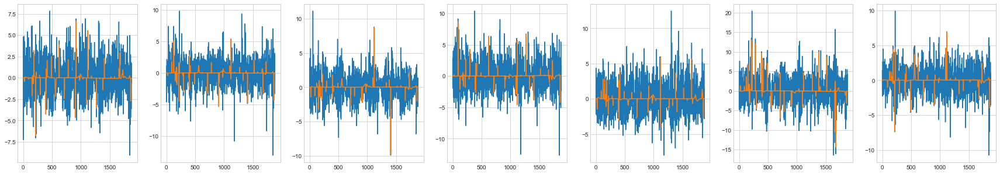

16th additional rbflayer
16th additional RBFlayer 0th epoch loss: 8.72824728855802
16th additional RBFlayer 999th epoch MSE Loss: 6.547659395130812
16th additional RBFlayer 1999th epoch MSE Loss: 6.5688030665769315
16th additional RBFlayer 2999th epoch MSE Loss: 6.575544866862082
16th additional RBFlayer best loss : 6.54571217838398


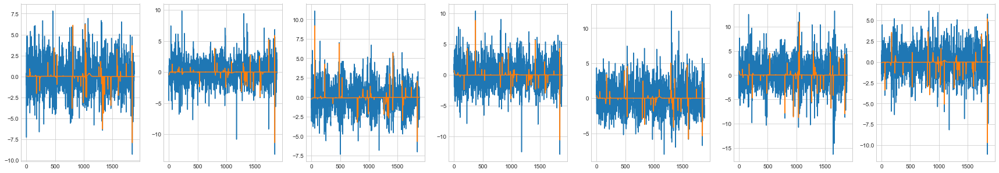

17th additional rbflayer
17th additional RBFlayer 0th epoch loss: 7.975717741223487
17th additional RBFlayer 999th epoch MSE Loss: 6.293521373882968
17th additional RBFlayer 1999th epoch MSE Loss: 6.303394474898883
17th additional RBFlayer 2999th epoch MSE Loss: 6.311836748488918
17th additional RBFlayer best loss : 6.277370325178734


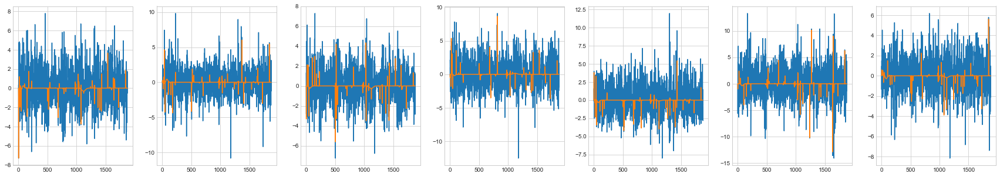

18th additional rbflayer
18th additional RBFlayer 0th epoch loss: 7.337323011006764
18th additional RBFlayer 999th epoch MSE Loss: 6.060089286738893
18th additional RBFlayer 1999th epoch MSE Loss: 6.069880925955475
18th additional RBFlayer 2999th epoch MSE Loss: 6.082592945292806
18th additional RBFlayer best loss : 6.054288854784551


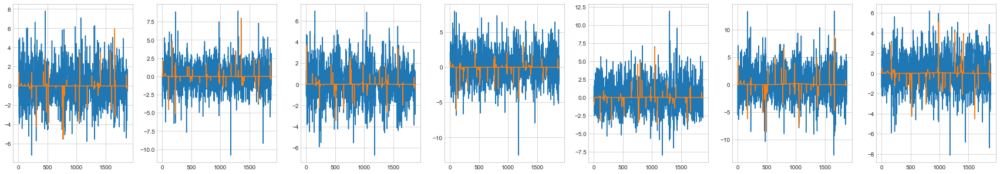

19th additional rbflayer
19th additional RBFlayer 0th epoch loss: 6.903916729234669
19th additional RBFlayer 999th epoch MSE Loss: 5.784733669797371
19th additional RBFlayer 1999th epoch MSE Loss: 5.778851174393665
19th additional RBFlayer 2999th epoch MSE Loss: 5.799169435205062
19th additional RBFlayer best loss : 5.764105501902427


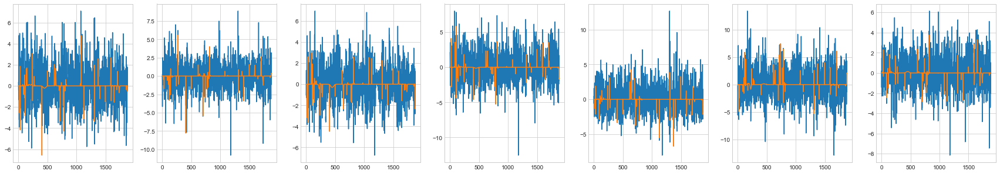

20th additional rbflayer
20th additional RBFlayer 0th epoch loss: 6.893195404122971
20th additional RBFlayer 999th epoch MSE Loss: 5.540987821499632
20th additional RBFlayer 1999th epoch MSE Loss: 5.516253929175867
20th additional RBFlayer 2999th epoch MSE Loss: 5.50944776959313
20th additional RBFlayer best loss : 5.509690334199972


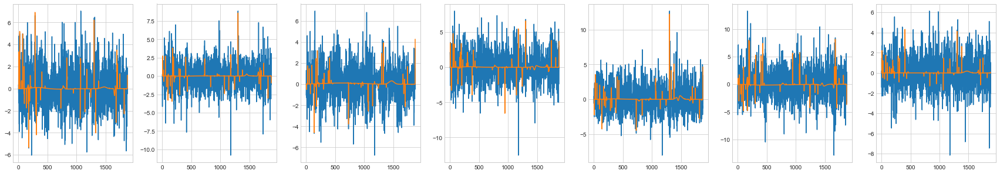

21th additional rbflayer
21th additional RBFlayer 0th epoch loss: 6.477473960824565
21th additional RBFlayer 999th epoch MSE Loss: 5.309153913362473
21th additional RBFlayer 1999th epoch MSE Loss: 5.3177297960127
21th additional RBFlayer 2999th epoch MSE Loss: 5.314852671175665
21th additional RBFlayer best loss : 5.302649727838388


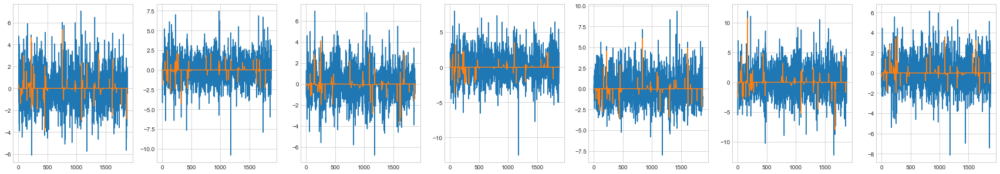

22th additional rbflayer
22th additional RBFlayer 0th epoch loss: 6.682282344891738
22th additional RBFlayer 999th epoch MSE Loss: 5.052184745897691
22th additional RBFlayer 1999th epoch MSE Loss: 5.0473174133985
22th additional RBFlayer 2999th epoch MSE Loss: 5.06371072854277
22th additional RBFlayer best loss : 5.0455913648647135


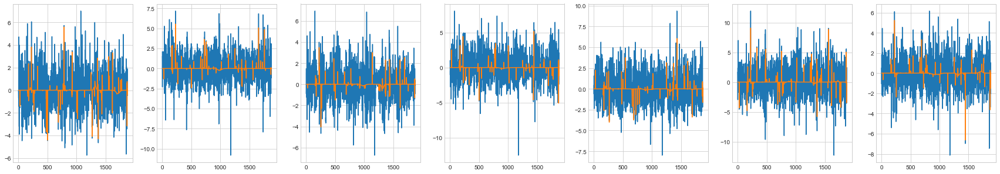

23th additional rbflayer
23th additional RBFlayer 0th epoch loss: 5.768357671781358
23th additional RBFlayer 999th epoch MSE Loss: 4.814163824777637
23th additional RBFlayer 1999th epoch MSE Loss: 4.80776871669602
23th additional RBFlayer 2999th epoch MSE Loss: 4.8111061112870654
23th additional RBFlayer best loss : 4.80371604286778


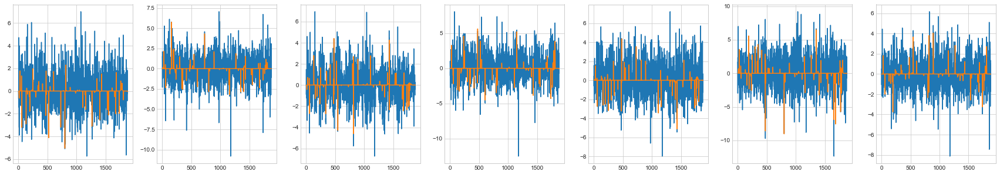

24th additional rbflayer
24th additional RBFlayer 0th epoch loss: 5.944382252732597
24th additional RBFlayer 999th epoch MSE Loss: 4.635931758882604
24th additional RBFlayer 1999th epoch MSE Loss: 4.639672091580219
24th additional RBFlayer 2999th epoch MSE Loss: 4.6380478177700235
24th additional RBFlayer best loss : 4.633786267509


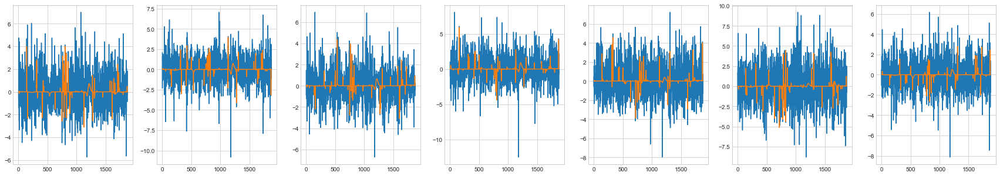

25th additional rbflayer
25th additional RBFlayer 0th epoch loss: 5.788177895280049
25th additional RBFlayer 999th epoch MSE Loss: 4.467940810867483
25th additional RBFlayer 1999th epoch MSE Loss: 4.4685941106963964
25th additional RBFlayer 2999th epoch MSE Loss: 4.467704558858936
25th additional RBFlayer best loss : 4.465608149315837


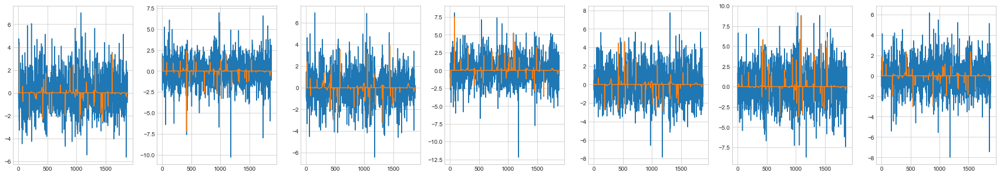

26th additional rbflayer
26th additional RBFlayer 0th epoch loss: 5.36721607137129
26th additional RBFlayer 999th epoch MSE Loss: 4.317689892953534
26th additional RBFlayer 1999th epoch MSE Loss: 4.319977012129294
26th additional RBFlayer 2999th epoch MSE Loss: 4.32556803597094
26th additional RBFlayer best loss : 4.317244820319474


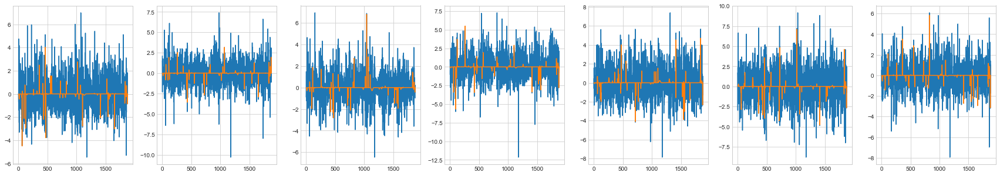

27th additional rbflayer
27th additional RBFlayer 0th epoch loss: 5.325570295182611
27th additional RBFlayer 999th epoch MSE Loss: 4.156141453953655
27th additional RBFlayer 1999th epoch MSE Loss: 4.157878951211413
27th additional RBFlayer 2999th epoch MSE Loss: 4.181900613944348
27th additional RBFlayer best loss : 4.154127801883812


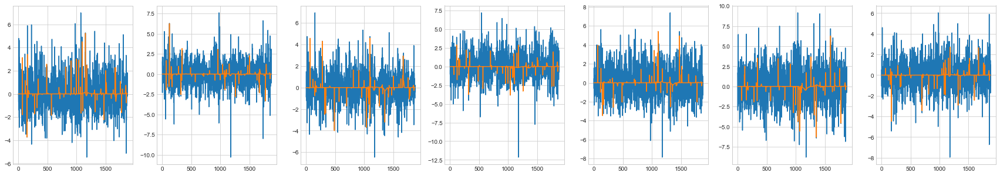

28th additional rbflayer
28th additional RBFlayer 0th epoch loss: 5.092150873032276
28th additional RBFlayer 999th epoch MSE Loss: 4.016690529275732
28th additional RBFlayer 1999th epoch MSE Loss: 4.0127612547571365
28th additional RBFlayer 2999th epoch MSE Loss: 4.011533764699384
28th additional RBFlayer best loss : 4.01044956245811


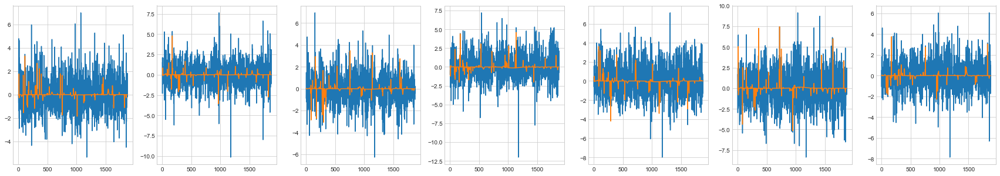

29th additional rbflayer
29th additional RBFlayer 0th epoch loss: 6.046481809427359
29th additional RBFlayer 999th epoch MSE Loss: 3.847844760473486
29th additional RBFlayer 1999th epoch MSE Loss: 3.819142822593248
29th additional RBFlayer 2999th epoch MSE Loss: 3.8175459666082334
29th additional RBFlayer best loss : 3.8154554027285013


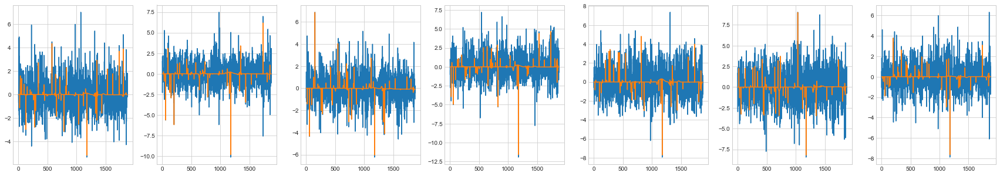

30th additional rbflayer
30th additional RBFlayer 0th epoch loss: 4.8099319751047105
30th additional RBFlayer 999th epoch MSE Loss: 3.7059116983368066
30th additional RBFlayer 1999th epoch MSE Loss: 3.6994268843150904
30th additional RBFlayer 2999th epoch MSE Loss: 3.705244563340155
30th additional RBFlayer best loss : 3.6969871399056036


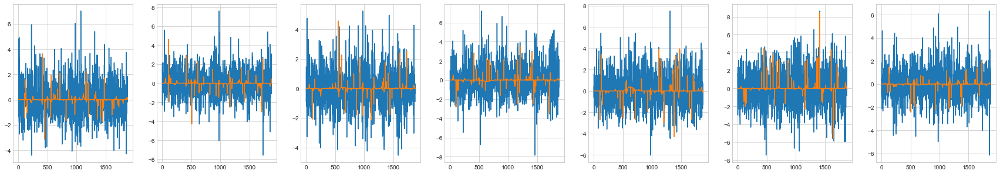

31th additional rbflayer
31th additional RBFlayer 0th epoch loss: 4.360939836766639
31th additional RBFlayer 999th epoch MSE Loss: 3.569139991629381
31th additional RBFlayer 1999th epoch MSE Loss: 3.5697124819868207
31th additional RBFlayer 2999th epoch MSE Loss: 3.5706790622484523
31th additional RBFlayer best loss : 3.565774344908052


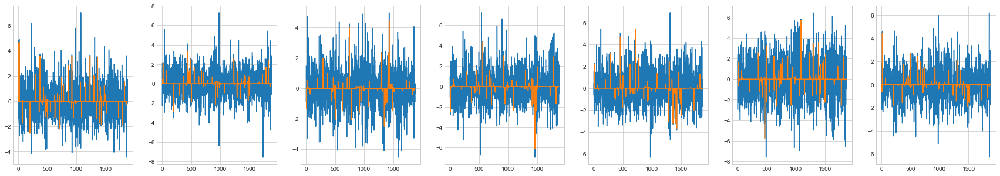

32th additional rbflayer
32th additional RBFlayer 0th epoch loss: 4.452165459625233
32th additional RBFlayer 999th epoch MSE Loss: 3.4520649481291383
32th additional RBFlayer 1999th epoch MSE Loss: 3.445000416129913
32th additional RBFlayer 2999th epoch MSE Loss: 3.4548950031543746
32th additional RBFlayer best loss : 3.4534714323327944


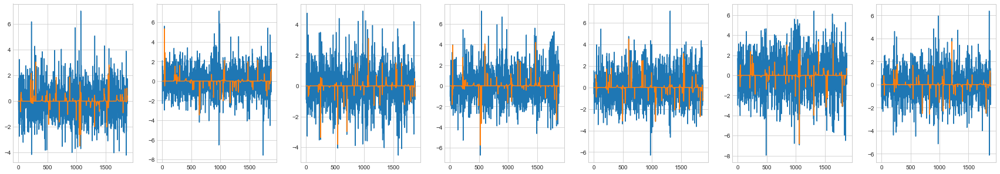

33th additional rbflayer
33th additional RBFlayer 0th epoch loss: 4.379417473785413
33th additional RBFlayer 999th epoch MSE Loss: 3.3382208636776887
33th additional RBFlayer 1999th epoch MSE Loss: 3.3385171969350194
33th additional RBFlayer 2999th epoch MSE Loss: 3.33899611515429
33th additional RBFlayer best loss : 3.3369036725811725


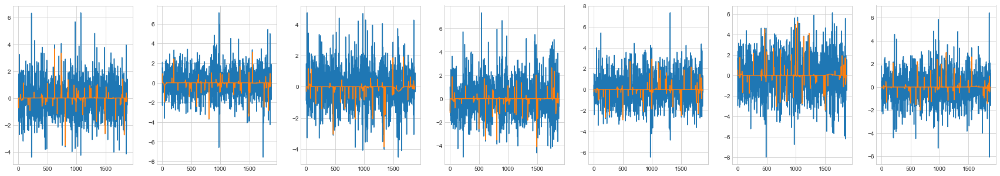

34th additional rbflayer
34th additional RBFlayer 0th epoch loss: 4.039325686396888
34th additional RBFlayer 999th epoch MSE Loss: 3.2499086624120377
34th additional RBFlayer 1999th epoch MSE Loss: 3.2460493536879826
34th additional RBFlayer 2999th epoch MSE Loss: 3.244340047975212
34th additional RBFlayer best loss : 3.2425228530956227


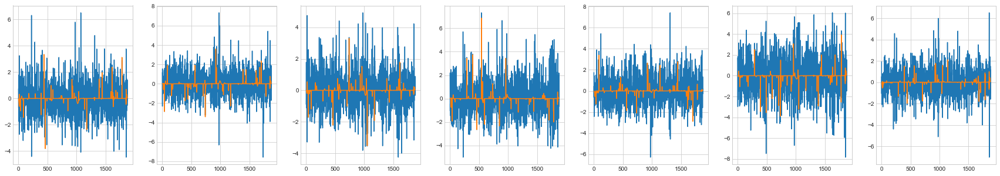

35th additional rbflayer
35th additional RBFlayer 0th epoch loss: 4.839635220153352
35th additional RBFlayer 999th epoch MSE Loss: 3.1505286606682
35th additional RBFlayer 1999th epoch MSE Loss: 3.149722247013893
35th additional RBFlayer 2999th epoch MSE Loss: 3.151125933013497
35th additional RBFlayer best loss : 3.148876857283332


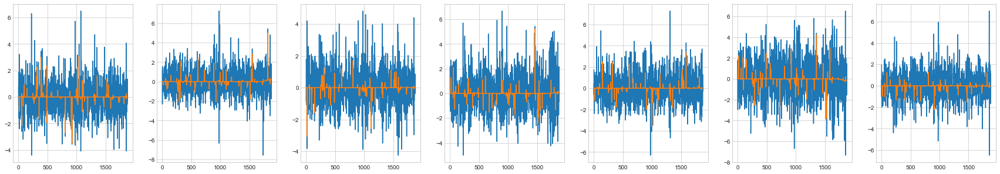

36th additional rbflayer
36th additional RBFlayer 0th epoch loss: 4.151639320445525
36th additional RBFlayer 999th epoch MSE Loss: 3.0768404974700663
36th additional RBFlayer 1999th epoch MSE Loss: 3.0654211631404333
36th additional RBFlayer 2999th epoch MSE Loss: 3.067161070737215
36th additional RBFlayer best loss : 3.0638508538884195


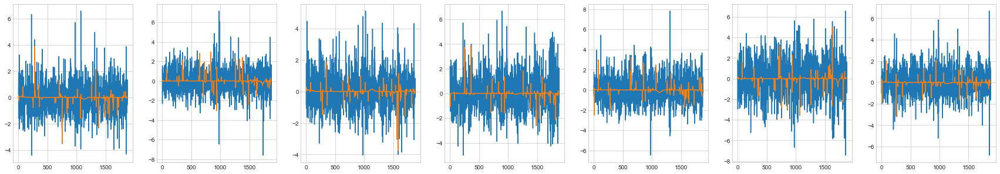

37th additional rbflayer
37th additional RBFlayer 0th epoch loss: 3.931145900254734
37th additional RBFlayer 999th epoch MSE Loss: 3.0039456345450346
37th additional RBFlayer 1999th epoch MSE Loss: 2.9926768348258785
37th additional RBFlayer 2999th epoch MSE Loss: 2.9924409540821766
37th additional RBFlayer best loss : 2.9895036460895463


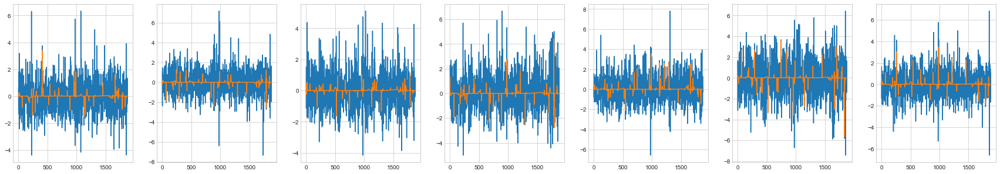

38th additional rbflayer
38th additional RBFlayer 0th epoch loss: 3.7692427425039807
38th additional RBFlayer 999th epoch MSE Loss: 2.927473341147416
38th additional RBFlayer 1999th epoch MSE Loss: 2.927977035333419
38th additional RBFlayer 2999th epoch MSE Loss: 2.927599817260604
38th additional RBFlayer best loss : 2.923816546679452


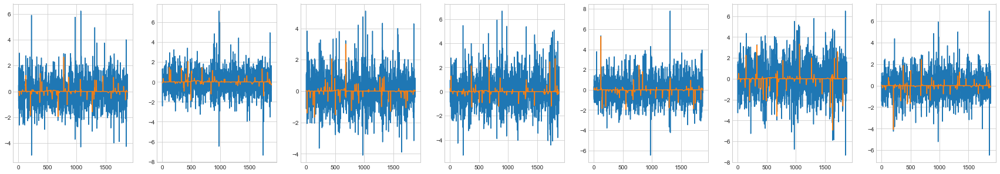

39th additional rbflayer
39th additional RBFlayer 0th epoch loss: 4.269951571070125
39th additional RBFlayer 999th epoch MSE Loss: 2.862974023279812
39th additional RBFlayer 1999th epoch MSE Loss: 2.86824394816086
39th additional RBFlayer 2999th epoch MSE Loss: 2.8698813336499036
39th additional RBFlayer best loss : 2.8608827626275484


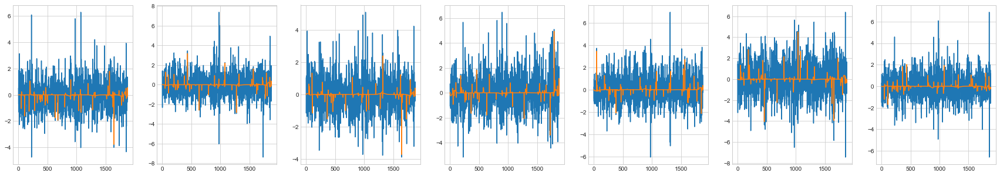

40th additional rbflayer
40th additional RBFlayer 0th epoch loss: 3.802365626897346
40th additional RBFlayer 999th epoch MSE Loss: 2.7919154327322753
40th additional RBFlayer 1999th epoch MSE Loss: 2.781196415493598
40th additional RBFlayer 2999th epoch MSE Loss: 2.7820547726182183
40th additional RBFlayer best loss : 2.780733829154798


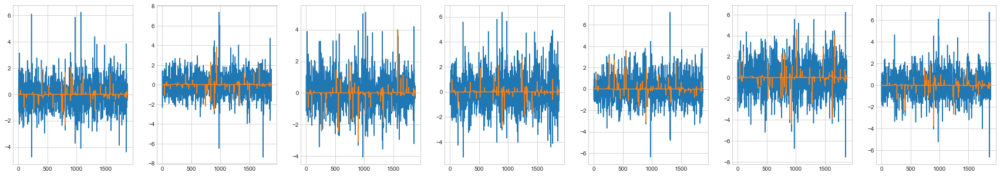

41th additional rbflayer
41th additional RBFlayer 0th epoch loss: 3.78744774546578
41th additional RBFlayer 999th epoch MSE Loss: 2.7106144066523137
41th additional RBFlayer 1999th epoch MSE Loss: 2.71157914813145
41th additional RBFlayer 2999th epoch MSE Loss: 2.7129353510662555
41th additional RBFlayer best loss : 2.708741965048713


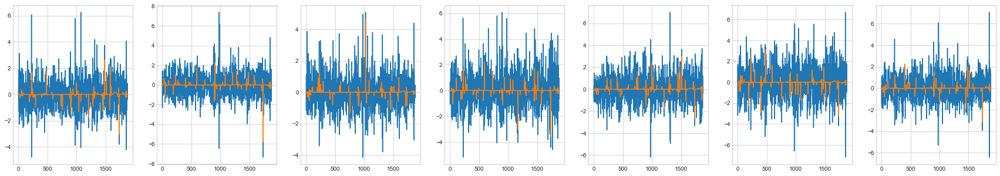

42th additional rbflayer
42th additional RBFlayer 0th epoch loss: 3.5366175752716837
42th additional RBFlayer 999th epoch MSE Loss: 2.6585529270477437
42th additional RBFlayer 1999th epoch MSE Loss: 2.6600903246164846
42th additional RBFlayer 2999th epoch MSE Loss: 2.6585816852600663
42th additional RBFlayer best loss : 2.657799220685544


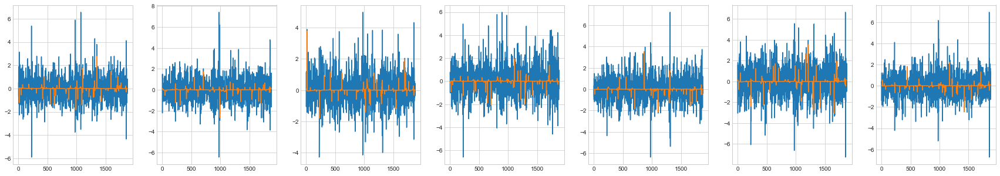

43th additional rbflayer
43th additional RBFlayer 0th epoch loss: 3.2435640758231785
43th additional RBFlayer 999th epoch MSE Loss: 2.6074524024321524
43th additional RBFlayer 1999th epoch MSE Loss: 2.604930294789026
43th additional RBFlayer 2999th epoch MSE Loss: 2.6070045854599653
43th additional RBFlayer best loss : 2.604908868117663


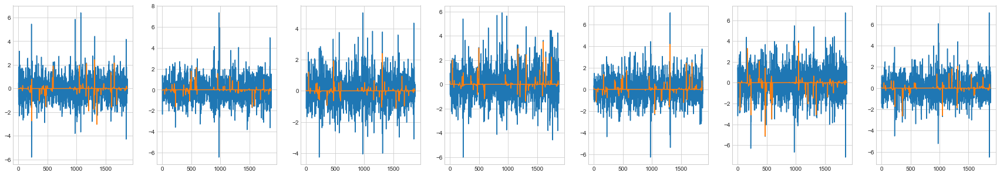

44th additional rbflayer
44th additional RBFlayer 0th epoch loss: 3.1763934493615356
44th additional RBFlayer 999th epoch MSE Loss: 2.565675206663462
44th additional RBFlayer 1999th epoch MSE Loss: 2.566519824024639
44th additional RBFlayer 2999th epoch MSE Loss: 2.564138045806356
44th additional RBFlayer best loss : 2.564126594917693


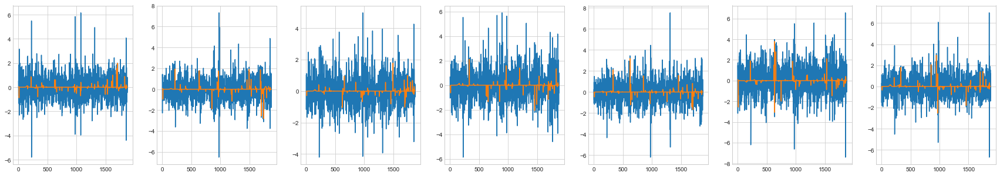

45th additional rbflayer
45th additional RBFlayer 0th epoch loss: 3.328463864298087
45th additional RBFlayer 999th epoch MSE Loss: 2.5160353041024335
45th additional RBFlayer 1999th epoch MSE Loss: 2.5205505608908174
45th additional RBFlayer 2999th epoch MSE Loss: 2.5131548459636464
45th additional RBFlayer best loss : 2.5061940000918415


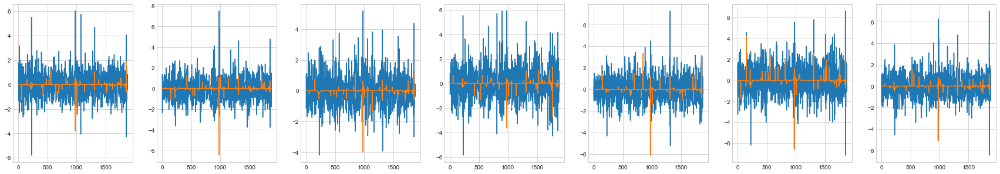

46th additional rbflayer
46th additional RBFlayer 0th epoch loss: 4.622807696166077
46th additional RBFlayer 999th epoch MSE Loss: 2.457540051386745
46th additional RBFlayer 1999th epoch MSE Loss: 2.4573472411645656
46th additional RBFlayer 2999th epoch MSE Loss: 2.4588787782682893
46th additional RBFlayer best loss : 2.4572451092548557


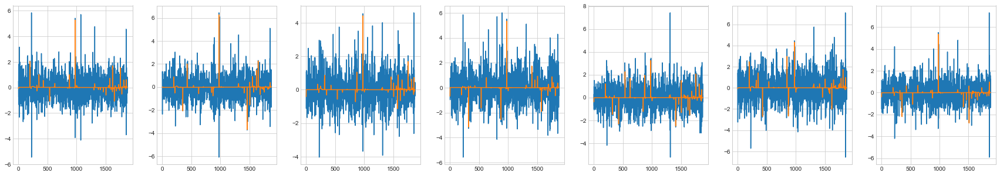

47th additional rbflayer
47th additional RBFlayer 0th epoch loss: 3.8402979456623085
47th additional RBFlayer 999th epoch MSE Loss: 2.421794321935957
47th additional RBFlayer 1999th epoch MSE Loss: 2.4175526155193814
47th additional RBFlayer 2999th epoch MSE Loss: 2.4267020562955373
47th additional RBFlayer best loss : 2.417326097397596


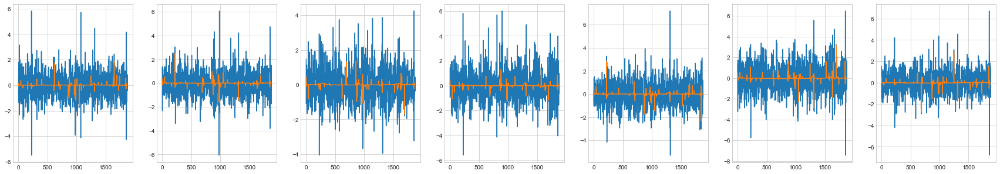

48th additional rbflayer
48th additional RBFlayer 0th epoch loss: 3.5514982525827086
48th additional RBFlayer 999th epoch MSE Loss: 2.386968789403681
48th additional RBFlayer 1999th epoch MSE Loss: 2.3676523020295748
48th additional RBFlayer 2999th epoch MSE Loss: 2.3625644461565423
48th additional RBFlayer best loss : 2.361845690229877


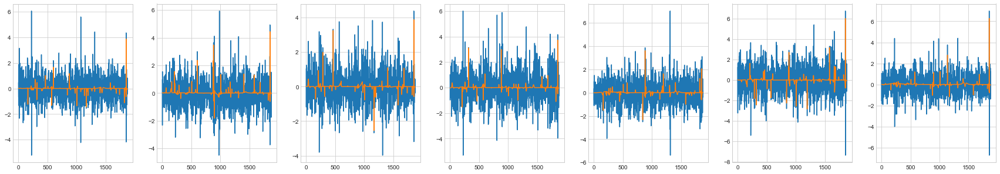

49th additional rbflayer
49th additional RBFlayer 0th epoch loss: 2.8784833383690147
49th additional RBFlayer 999th epoch MSE Loss: 2.3295173113796803
49th additional RBFlayer 1999th epoch MSE Loss: 2.328944189496688
49th additional RBFlayer 2999th epoch MSE Loss: 2.3253096055562064
49th additional RBFlayer best loss : 2.324361332818173


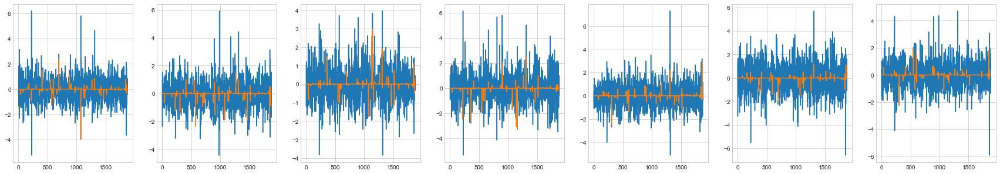

50th additional rbflayer
50th additional RBFlayer 0th epoch loss: 3.0837616882439045
50th additional RBFlayer 999th epoch MSE Loss: 2.302636980732823
50th additional RBFlayer 1999th epoch MSE Loss: 2.2973684188856556
50th additional RBFlayer 2999th epoch MSE Loss: 2.2973979634130277
50th additional RBFlayer best loss : 2.2965807653538937


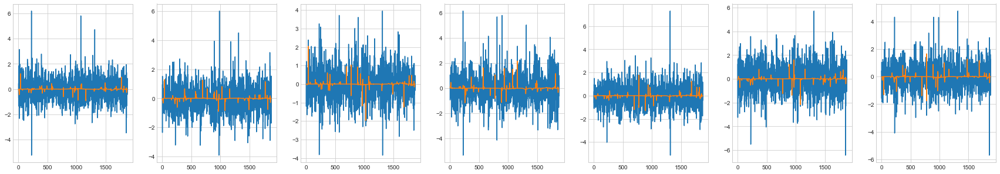

51th additional rbflayer
51th additional RBFlayer 0th epoch loss: 2.9531217324551866
51th additional RBFlayer 999th epoch MSE Loss: 2.275277390687816
51th additional RBFlayer 1999th epoch MSE Loss: 2.2747573296816723
51th additional RBFlayer 2999th epoch MSE Loss: 2.273571273617055
51th additional RBFlayer best loss : 2.273486625348213


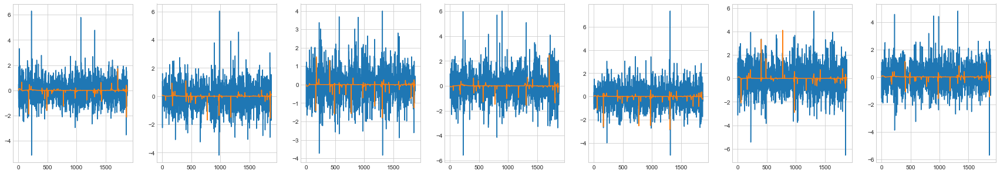

52th additional rbflayer
52th additional RBFlayer 0th epoch loss: 2.916165597709563
52th additional RBFlayer 999th epoch MSE Loss: 2.253233248054381
52th additional RBFlayer 1999th epoch MSE Loss: 2.2495505188021787
52th additional RBFlayer 2999th epoch MSE Loss: 2.2498005009450104
52th additional RBFlayer best loss : 2.2494554685409054


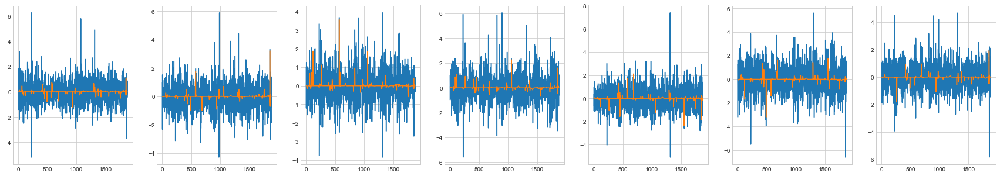

53th additional rbflayer
53th additional RBFlayer 0th epoch loss: 2.7641891526304914
53th additional RBFlayer 999th epoch MSE Loss: 2.2333637283970753
53th additional RBFlayer 1999th epoch MSE Loss: 2.2299208070787997
53th additional RBFlayer 2999th epoch MSE Loss: 2.2312166698804896
53th additional RBFlayer best loss : 2.226337085074648


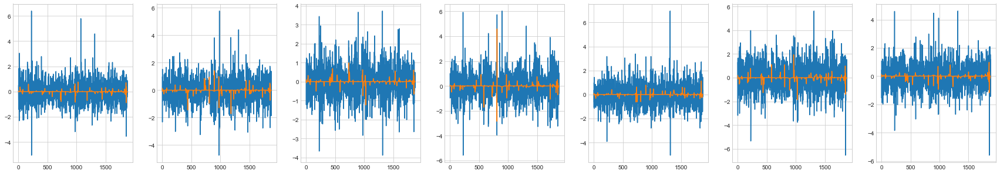

54th additional rbflayer
54th additional RBFlayer 0th epoch loss: 2.7301236876446495
54th additional RBFlayer 999th epoch MSE Loss: 2.2054631288849778
54th additional RBFlayer 1999th epoch MSE Loss: 2.207205589034103
54th additional RBFlayer 2999th epoch MSE Loss: 2.206551637985472
54th additional RBFlayer best loss : 2.205448339875853


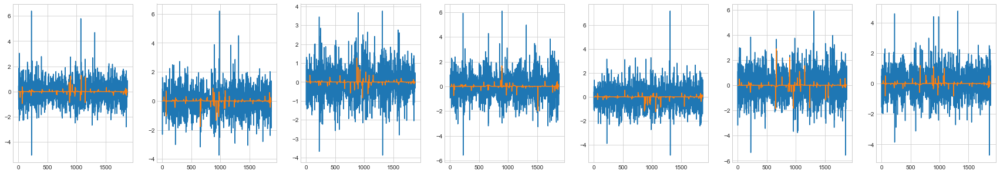

55th additional rbflayer
55th additional RBFlayer 0th epoch loss: 2.7133779699356
55th additional RBFlayer 999th epoch MSE Loss: 2.185066696630788
55th additional RBFlayer 1999th epoch MSE Loss: 2.186000265513827
55th additional RBFlayer 2999th epoch MSE Loss: 2.18451406531992
55th additional RBFlayer best loss : 2.1826538159615674


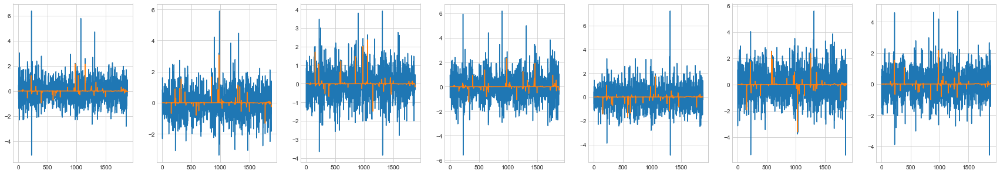

56th additional rbflayer
56th additional RBFlayer 0th epoch loss: 2.9216818549388592
56th additional RBFlayer 999th epoch MSE Loss: 2.1588299736613386
56th additional RBFlayer 1999th epoch MSE Loss: 2.1662017266897795
56th additional RBFlayer 2999th epoch MSE Loss: 2.1672962734768273
56th additional RBFlayer best loss : 2.156772260732047


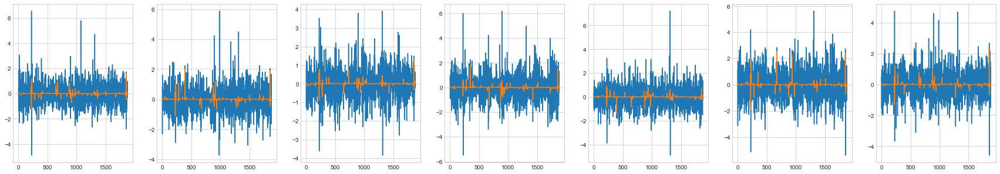

57th additional rbflayer
57th additional RBFlayer 0th epoch loss: 3.742572009997333
57th additional RBFlayer 999th epoch MSE Loss: 2.142499758007418
57th additional RBFlayer 1999th epoch MSE Loss: 2.1394256359807984
57th additional RBFlayer 2999th epoch MSE Loss: 2.1398775376074046
57th additional RBFlayer best loss : 2.1366453837068593


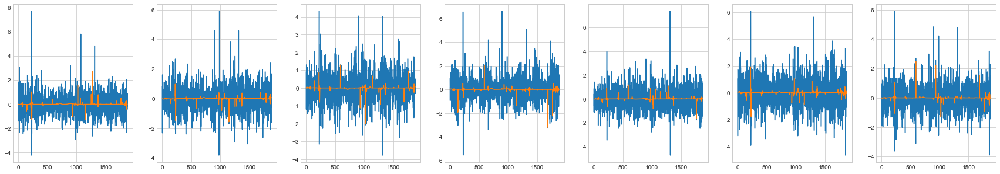

58th additional rbflayer
58th additional RBFlayer 0th epoch loss: 3.147166662909994
58th additional RBFlayer 999th epoch MSE Loss: 2.1335772609902306
58th additional RBFlayer 1999th epoch MSE Loss: 2.1281190878439182
58th additional RBFlayer 2999th epoch MSE Loss: 2.127412914370847
58th additional RBFlayer best loss : 2.1252257618393497


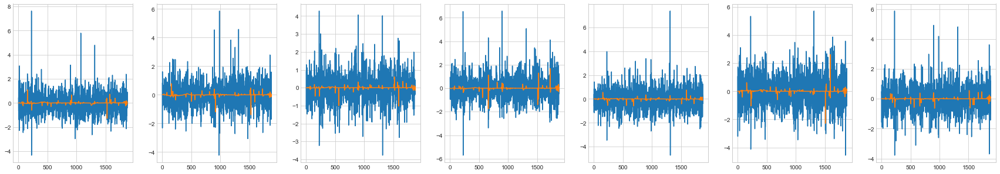

59th additional rbflayer
59th additional RBFlayer 0th epoch loss: 3.055776201631953
59th additional RBFlayer 999th epoch MSE Loss: 2.1180616570525235
59th additional RBFlayer 1999th epoch MSE Loss: 2.104540286385952
59th additional RBFlayer 2999th epoch MSE Loss: 2.100954368545324
59th additional RBFlayer best loss : 2.099408972063178


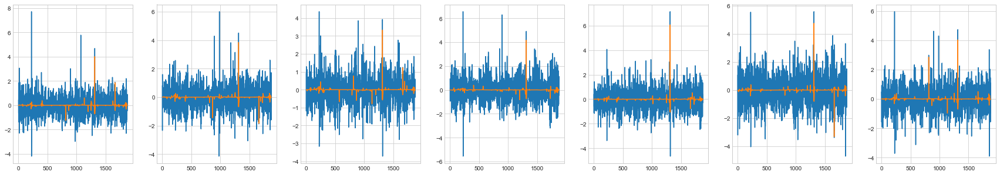

60th additional rbflayer
60th additional RBFlayer 0th epoch loss: 2.69660114196945
60th additional RBFlayer 999th epoch MSE Loss: 2.093559877156239
60th additional RBFlayer 1999th epoch MSE Loss: 2.093095053788172
60th additional RBFlayer 2999th epoch MSE Loss: 2.091983837354203
60th additional RBFlayer best loss : 2.0919830707388902


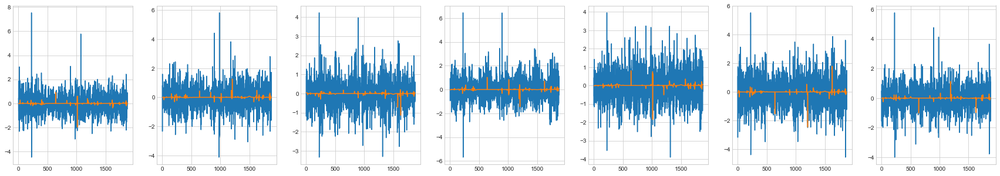

61th additional rbflayer
61th additional RBFlayer 0th epoch loss: 2.940220914353551
61th additional RBFlayer 999th epoch MSE Loss: 2.080846797543173
61th additional RBFlayer 1999th epoch MSE Loss: 2.0828300741361008
61th additional RBFlayer 2999th epoch MSE Loss: 2.083236408575451
61th additional RBFlayer best loss : 2.080831031575777


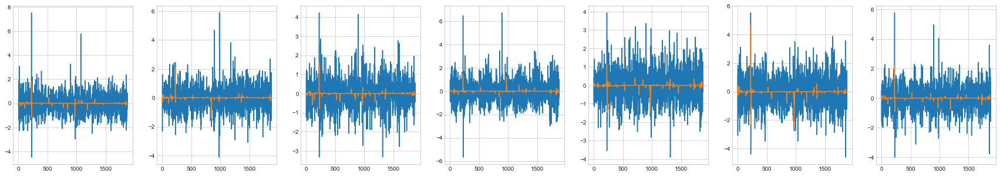

62th additional rbflayer
62th additional RBFlayer 0th epoch loss: 2.5444833105765166
62th additional RBFlayer 999th epoch MSE Loss: 2.073231155717596
62th additional RBFlayer 1999th epoch MSE Loss: 2.068437077304081
62th additional RBFlayer 2999th epoch MSE Loss: 2.067545948360624
62th additional RBFlayer best loss : 2.0624089133632046


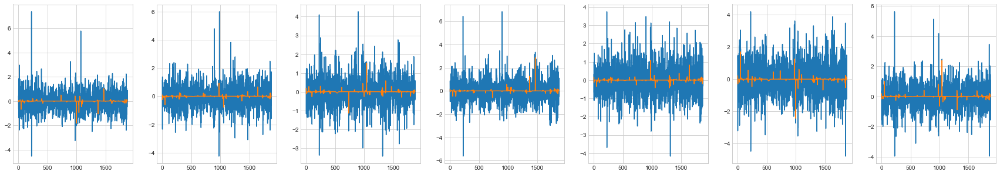

63th additional rbflayer
63th additional RBFlayer 0th epoch loss: 2.67510104714854
63th additional RBFlayer 999th epoch MSE Loss: 2.055152566397172
63th additional RBFlayer 1999th epoch MSE Loss: 2.0546689508619056
63th additional RBFlayer 2999th epoch MSE Loss: 2.0540303397748576
63th additional RBFlayer best loss : 2.0492091391899714


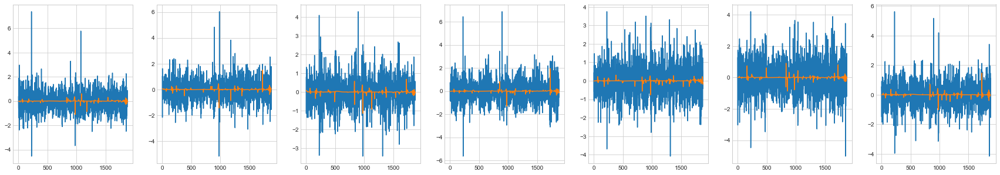

64th additional rbflayer
64th additional RBFlayer 0th epoch loss: 3.040588196371007
64th additional RBFlayer 999th epoch MSE Loss: 2.026414771917567
64th additional RBFlayer 1999th epoch MSE Loss: 2.0233646956381808
64th additional RBFlayer 2999th epoch MSE Loss: 2.0219278914881125
64th additional RBFlayer best loss : 2.021926509118787


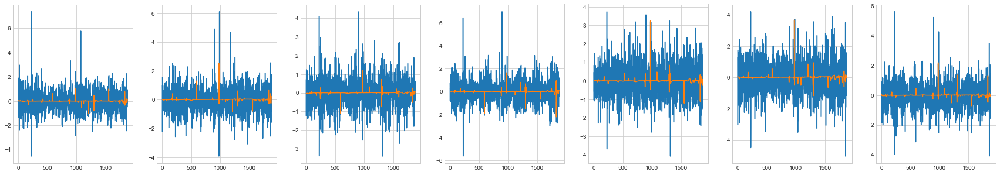

65th additional rbflayer
65th additional RBFlayer 0th epoch loss: 2.8037236100726677
65th additional RBFlayer 999th epoch MSE Loss: 2.0116088713869793
65th additional RBFlayer 1999th epoch MSE Loss: 2.0105699459300914
65th additional RBFlayer 2999th epoch MSE Loss: 2.0099709653043605
65th additional RBFlayer best loss : 2.009905522124083


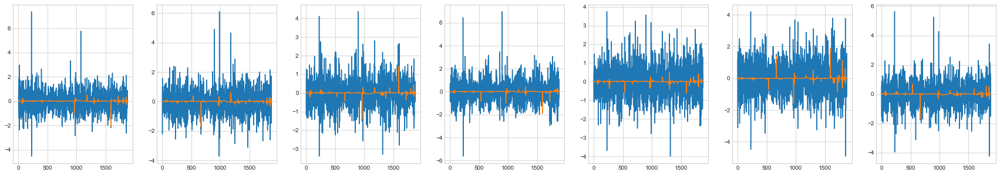

66th additional rbflayer
66th additional RBFlayer 0th epoch loss: 2.5634673967041537
66th additional RBFlayer 999th epoch MSE Loss: 2.005561464522851
66th additional RBFlayer 1999th epoch MSE Loss: 2.0040431163874914
66th additional RBFlayer 2999th epoch MSE Loss: 2.002711166773338
66th additional RBFlayer best loss : 2.00271101184873


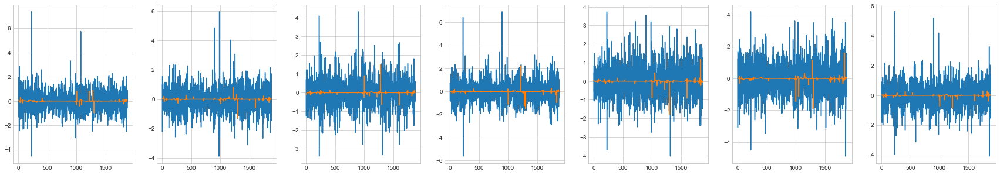

67th additional rbflayer
67th additional RBFlayer 0th epoch loss: 2.4639470503646885
67th additional RBFlayer 999th epoch MSE Loss: 1.996396051756087
67th additional RBFlayer 1999th epoch MSE Loss: 1.9953314349843743
67th additional RBFlayer 2999th epoch MSE Loss: 1.9942324399012266
67th additional RBFlayer best loss : 1.994224126121246


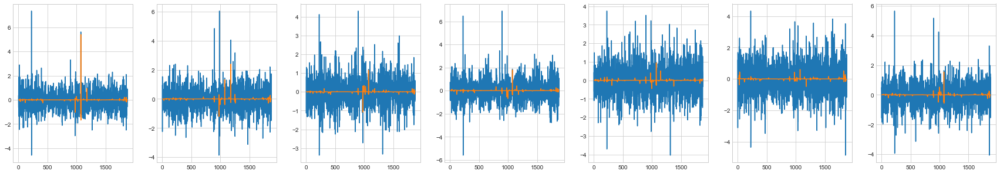

In [53]:
model_gang2 = MultiRBFnn(gang_target2.size(0), 100, device)
model_gang2.train(gang_input, gang_target2, 3000, 0.00001, 2, 100)

<Figure size 2160x720 with 0 Axes>

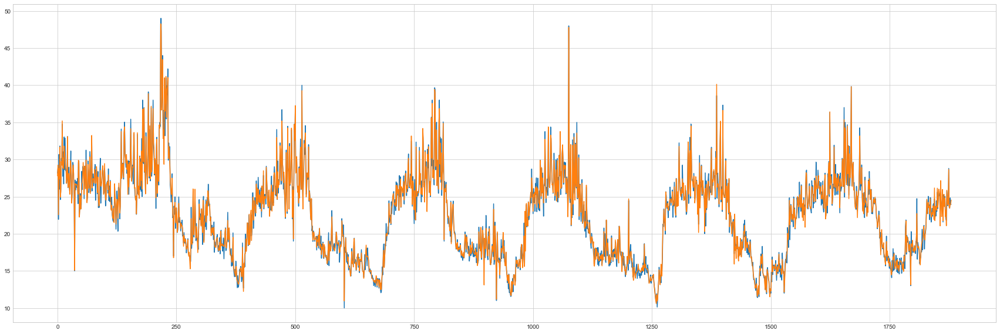

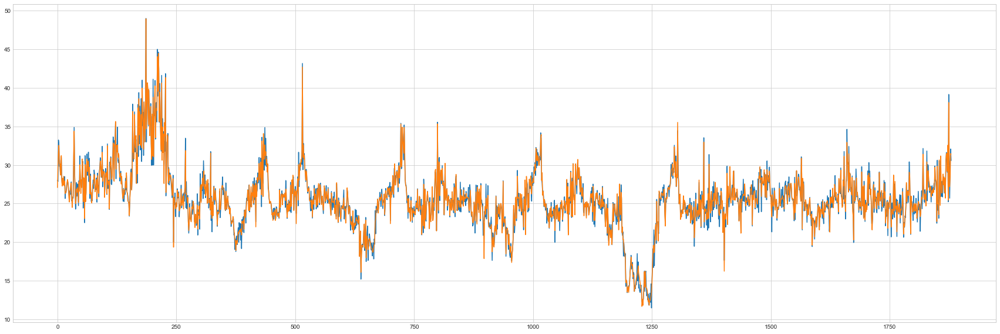

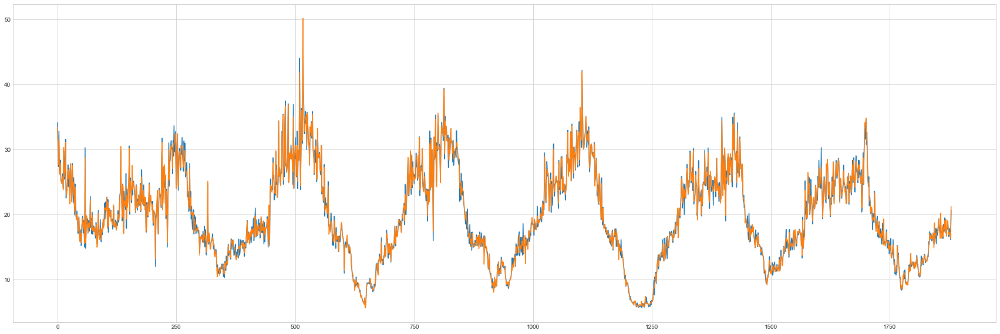

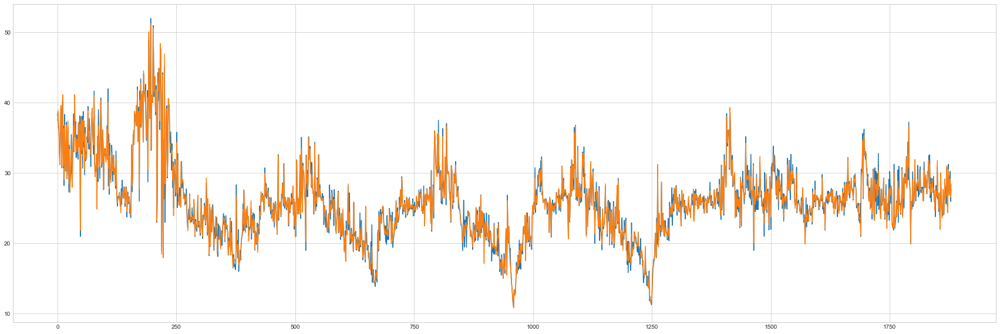

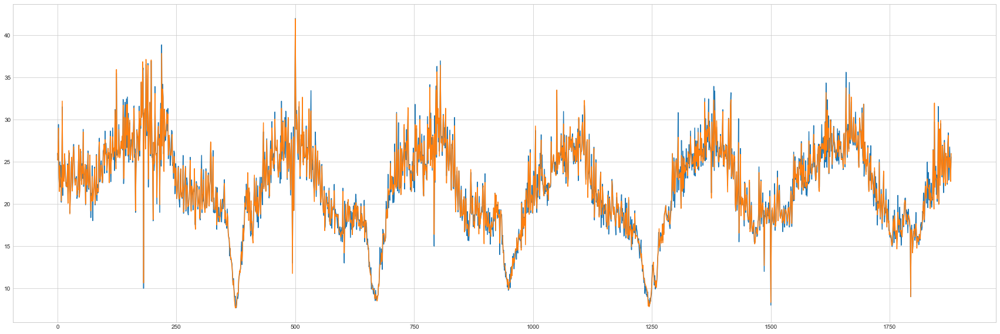

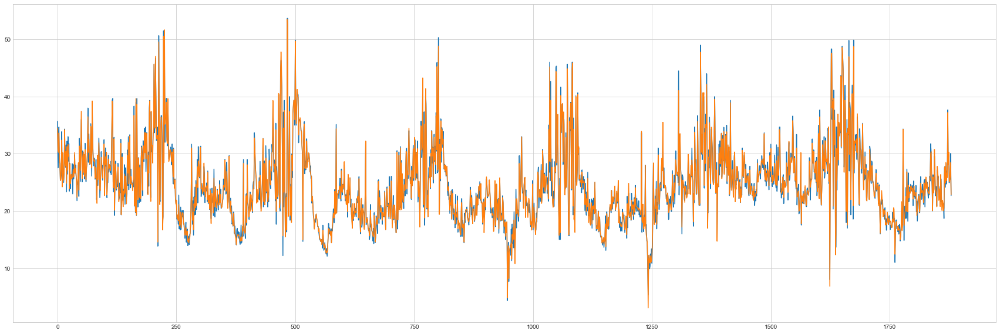

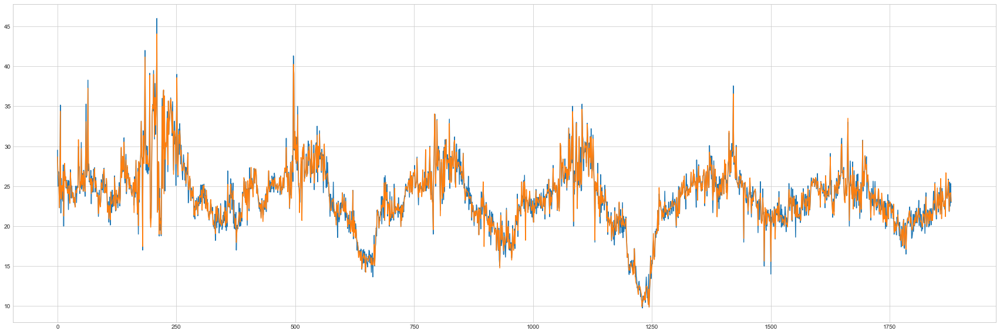

In [55]:
plt.figure(figsize=(30, 10))
model_pred = model_gang2.pred(gang_input)[1]
for i in range(gang_target2.size(0)):
    plt.figure(figsize=(30, 10))
    plt.plot(gang_input.cpu().detach().numpy(), gang_target2[i].cpu().detach().numpy())
    plt.plot(gang_input.cpu().detach().numpy(), model_pred[i].cpu().detach().numpy())
    plt.show()